## 0. Import Libraries and Install Pre-Requistes

In [ ]:
import sys
!{sys.executable} -m pip install -U pandas-profiling

In [1]:
import os
#Built-in
import time
import warnings
import statsmodels
import numpy as np
import pandas as pd
from datetime import datetime
#Visualization
from tqdm import tqdm
import seaborn as sns
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import plotly.graph_objects as go
#Dimensionality Reduction
import umap
import prince
#EDA Libraries
from pandas_profiling import ProfileReport
#MICE Libraries
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
#Distribution Normalization
from sklearn.preprocessing import OrdinalEncoder, PowerTransformer, QuantileTransformer, StandardScaler
from statsmodels.api import qqplot
import sklearn.covariance as cov
from scipy.stats import chi2
#PCA
from sklearn.decomposition import PCA
#Clustering & Visualization Libraries
import sklearn.cluster as cluster
from sklearn.cluster import KMeans
from kmodes.kprototypes import KPrototypes
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, silhouette_visualizer, InterclusterDistance
from yellowbrick.cluster.elbow import kelbow_visualizer
from sklearn.mixture import GaussianMixture
from sklearn.cluster import DBSCAN
#Clustering Metrics
from sklearn.metrics import silhouette_score, silhouette_samples, calinski_harabasz_score, davies_bouldin_score
#ML Prediction
import shap
from lightgbm import LGBMClassifier
from sklearn.model_selection import cross_val_score

warnings.filterwarnings('ignore')
%config InlineBackend.figure_format = 'retina'

In [2]:
recalculate = False # False -> Read pickle dumps, True -> Recalculate all the values

## 1. Dataset Overview

In [3]:
# Data Loading
data = pd.read_csv(os.path.join(os.getcwd(),'Data/donors.csv'),low_memory=False)
data.drop(data.columns[0],inplace=True,axis=1)
sns.set_style('white')

In [4]:
#Check duplicates
print('No duplicates' if not any(data.duplicated()) else 'Duplicates are found')

No duplicates


In [5]:
#set random state
random_state=np.random.RandomState(5)
#Check for data type of columns
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 95412 entries, 0 to 95411
Columns: 475 entries, ODATEDW to GEOCODE2
dtypes: float64(49), int64(301), object(125)
memory usage: 345.8+ MB


In [6]:
# describe columns with object dtype
pd.set_option('display.max_columns', None)
data.describe(include='all')

,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,RECP3,RECPGVG,RECSWEEP,MDMAUD,DOMAIN,HOMEOWNR,CHILD03,CHILD07,CHILD12,CHILD18,NUMCHLD,INCOME,GENDER,WEALTH1,HIT,MBCRAFT,MBGARDEN,MBBOOKS,MBCOLECT,MAGFAML,MAGFEM,MAGMALE,PUBGARDN,PUBCULIN,PUBHLTH,PUBDOITY,PUBNEWFN,PUBPHOTO,PUBOPP,DATASRCE,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,WEALTH2,GEOCODE,COLLECT1,VETERANS,BIBLE,CATLG,HOMEE,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,BOATS,WALKER,KIDSTUFF,CARDS,PLATES,LIFESRC,PEPSTRFL,POP901,POP902,POP903,POP90C1,POP90C2,POP90C3,POP90C4,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,ETH6,ETH7,ETH8,ETH9,ETH10,ETH11,ETH12,ETH13,ETH14,ETH15,ETH16,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,AGE907,CHIL1,CHIL2,CHIL3,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,CHILC1,CHILC2,CHILC3,CHILC4,CHILC5,HHAGE1,HHAGE2,HHAGE3,HHN1,HHN2,HHN3,HHN4,HHN5,HHN6,MARR1,MARR2,MARR3,MARR4,HHP1,HHP2,DW1,DW2,DW3,DW4,DW5,DW6,DW7,DW8,DW9,HV1,HV2,HV3,HV4,HU1,HU2,HU3,HU4,HU5,HHD1,HHD2,HHD3,HHD4,HHD5,HHD6,HHD7,HHD8,HHD9,HHD10,HHD11,HHD12,ETHC1,ETHC2,ETHC3,ETHC4,ETHC5,ETHC6,HVP1,HVP2,HVP3,HVP4,HVP5,HVP6,HUR1,HUR2,RHP1,RHP2,RHP3,RHP4,HUPA1,HUPA2,HUPA3,HUPA4,HUPA5,HUPA6,HUPA7,RP1,RP2,RP3,RP4,MSA,ADI,DMA,IC1,IC2,IC3,IC4,IC5,IC6,IC7,IC8,IC9,IC10,IC11,IC12,IC13,IC14,IC15,IC16,IC17,IC18,IC19,IC20,IC21,IC22,IC23,HHAS1,HHAS2,HHAS3,HHAS4,MC1,MC2,MC3,TPE1,TPE2,TPE3,TPE4,TPE5,TPE6,TPE7,TPE8,TPE9,PEC1,PEC2,TPE10,TPE11,TPE12,TPE13,LFC1,LFC2,LFC3,LFC4,LFC5,LFC6,LFC7,LFC8,LFC9,LFC10,OCC1,OCC2,OCC3,OCC4,OCC5,OCC6,OCC7,OCC8,OCC9,OCC10,OCC11,OCC12,OCC13,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,OEDC7,EC1,EC2,EC3,EC4,EC5,EC6,EC7,EC8,SEC1,SEC2,SEC3,SEC4,SEC5,AFC1,AFC2,AFC3,AFC4,AFC5,AFC6,VC1,VC2,VC3,VC4,ANC1,ANC2,ANC3,ANC4,ANC5,ANC6,ANC7,ANC8,ANC9,ANC10,ANC11,ANC12,ANC13,ANC14,ANC15,POBC1,POBC2,LSC1,LSC2,LSC3,LSC4,VOC1,VOC2,VOC3,HC1,HC2,HC3,HC4,HC5,HC6,HC7,HC8,HC9,HC10,HC11,HC12,HC13,HC14,HC15,HC16,HC17,HC18,HC19,HC20,HC21,MHUC1,MHUC2,AC1,AC2,ADATE_2,ADATE_3,ADATE_4,ADATE_5,ADATE_6,ADATE_7,ADATE_8,ADATE_9,ADATE_10,ADATE_11,ADATE_12,ADATE_13,ADATE_14,ADATE_15,ADATE_16,ADATE_17,ADATE_18,ADATE_19,ADATE_20,ADATE_21,ADATE_22,ADATE_23,ADATE_24,RFA_2,RFA_3,RFA_4,RFA_5,RFA_6,RFA_7,RFA_8,RFA_9,RFA_10,RFA_11,RFA_12,RFA_13,RFA_14,RFA_15,RFA_16,RFA_17,RFA_18,RFA_19,RFA_20,RFA_21,RFA_22,RFA_23,RFA_24,CARDPROM,MAXADATE,NUMPROM,CARDPM12,NUMPRM12,RDATE_3,RDATE_4,RDATE_5,RDATE_6,RDATE_7,RDATE_8,RDATE_9,RDATE_10,RDATE_11,RDATE_12,RDATE_13,RDATE_14,RDATE_15,RDATE_16,RDATE_17,RDATE_18,RDATE_19,RDATE_20,RDATE_21,RDATE_22,RDATE_23,RDATE_24,RAMNT_3,RAMNT_4,RAMNT_5,RAMNT_6,RAMNT_7,RAMNT_8,RAMNT_9,RAMNT_10,RAMNT_11,RAMNT_12,RAMNT_13,RAMNT_14,RAMNT_15,RAMNT_16,RAMNT_17,RAMNT_18,RAMNT_19,RAMNT_20,RAMNT_21,RAMNT_22,RAMNT_23,RAMNT_24,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MINRDATE,MAXRAMNT,MAXRDATE,LASTGIFT,LASTDATE,FISTDATE,NEXTDATE,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2
count,95412,95412,95412.000000,95412,95412,95412,95412,71529,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,12386.000000,74126.000000,95412,50680.000000,95412.000000,42558.000000,42558.000000,42558.000000,42498.000000,42558.000000,42558.000000,42558.000000,42558.000000,42558.000000,42558.000000,42558.000000,42558.000000,42558.000000,42558.000000,95412,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412,95412,95412,51589.000000,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,95412.00000

In [7]:
# check incorrect values about promotions
for i in range(3, 25):
    data['checker1'] = data['ADATE_' + str(i)] >= data['RDATE_' + str(i)]   
    data['checker2'] = data['RAMNT_' + str(i)].isna() & (data['RDATE_'  + str(i)].isna() == False)
    data['checker3'] = data['RDATE_'  + str(i)].isna() & (data['RAMNT_' + str(i)].isna() == False)
    for i in range(3, 25):
        data['RFA_' + str(i)] = data['RFA_' + str(i)].apply(str.strip)
    data['checker4'] = (data['RFA_'  + str(i)] == '') & (data['ADATE_' + str(i)].isna() == False) | (data['RFA_'  + str(i)] != '') & (data['ADATE_' + str(i)].isna() == True)
    data['checker5'] = data['DOB'] >= data['FISTDATE']

print('RDATE before ADATE ', len(data.loc[data['checker1'] == True]))
print('Empty amount with not empty date ', len(data.loc[data['checker2'] == True]))
print('Empty date with not empty amount ',len(data.loc[data['checker3'] == True]))
print('Empty RFA with not empty ADATE and vice versa ',len(data.loc[data['checker4'] == True]))
print("DOB is later than one of dates ",len(data.loc[data['checker5'] == True]))
drop_lst=['checker' + str(i) for i in range(1, 6)]
data.drop(columns = drop_lst, inplace=True)

RDATE before ADATE  6999
Empty amount with not empty date  0
Empty date with not empty amount  0
Empty RFA with not empty ADATE and vice versa  0
DOB is later than one of dates  281


In [8]:
# RDATE's correction
modes = {'RDATE_'  + str(i): data['RDATE_'  + str(i)].mode() for i in range(3, 25)}
for i in range(3, 25):
    data.loc[data['ADATE_' + str(i)] >= data['RDATE_' + str(i)], 'RDATE_' + str(i)] = modes['RDATE_'  + str(i)].values[0]

In [9]:
# correction in ZIP codes (delete improper symbols)
data['ZIP'].replace(r'\-', '', regex=True, inplace=True)

In [10]:
# split MDMAUD into 4 columns, adding last one to the dataset, drop original because we already have MDMAUD_R, MDMAUD_F, MDMAUD_A 
split_df = data['MDMAUD'].str.split('',expand=True)
data['MDMAUD_M'] = split_df[4]
data.drop(columns=['MDMAUD'], inplace=True)
exch_map = {'X': '0', 'M': '1'}
data['MDMAUD_M'] = data['MDMAUD_M'].map(exch_map)

In [11]:
# define exchenge dict for variables who can't be changed by ordinal encoder according metadata (including spaces replacing)
exch_dict = {
 'NOEXCH': {'X': '0', ' ': '1', '0': '0', '1': '1'},
 'GENDER':  {'F': 'F', 'M': 'M', ' ': 'U', 'C': 'U', 'U': 'U', 'J': 'U', 'A': 'U'},
 'SOLP3': {' ': '00', '00': '00', '12': '12', '01': '01', '02': '02'},
 'SOLIH': {' ': '00', '12': '12', '00': '00', '02': '02', '01': '01', '04': '04', '06': '06', '03': '03'},
 'HOMEOWNR':{' ': 'U', 'H': 'H','U':'U'}
  }
for item in exch_dict.keys():
        exch_map = exch_dict[item]
        data[item] = data[item].map(exch_map)

## 2. Fill NaNs

In [12]:
# number of missing values per feature
data.isna().sum().loc[data.isna().sum() > 0].sort_values(ascending=False)

RDATE_5     95403
RAMNT_5     95403
RDATE_3     95170
RAMNT_3     95170
RDATE_4     95131
            ...  
MSA           132
ADI           132
DMA           132
GEOCODE2      132
FISTDATE        2
Length: 92, dtype: int64

In [13]:
# rows with missed values in MSA, ADI, DMA & Geocode2
print('Rows with missed values in MSA, ADI, DMA & Geocode2 - ', len(data.loc[data['MSA'].isna() & data['ADI'].isna() & data['DMA'].isna() & data['GEOCODE2'].isna()].index.tolist()))

Rows with missed values in MSA, ADI, DMA & Geocode2 -  132


In [14]:
# delete rows from previous condition (4 NaN in a single row, record quality is low)
data.drop(np.where(data['MSA'].isna() & data['ADI'].isna() & data['DMA'].isna() & data['GEOCODE2'].isna())[0], inplace=True)

In [15]:
# drop 2 rows with FISTDATE == NaN becuse they are not donors
data.drop(data.loc[data['FISTDATE'].isna()].index, axis=0, inplace=True)

In [16]:
# exchange NaN with "0" because there is no missing values in HIT (Mail Order Response) and NaN in campaigns means the donor didn't response
fill_lst = ['NUMCHLD','MBCRAFT', 'MBGARDEN', 'MBBOOKS', 'MBCOLECT', 'MAGFAML', 'MAGFEM', 'MAGMALE', 'PUBGARDN', 'PUBCULIN', 'PUBHLTH', 
'PUBDOITY', 'PUBNEWFN', 'PUBPHOTO', 'PUBOPP']+['ADATE_'+  str(i) for i in range(2, 25)] + ['RDATE_'+ str(i) for i in range(3, 25)]+ ['RAMNT_'+ str(i) for i in range(3, 25)]+ ['RFA_'+ str(i) for i in range(2, 25)]

for item in fill_lst:
    data[item].fillna(0, inplace=True)
       
# donors who had the only one donation
data['NEXTDATE'].fillna(pd.Timestamp(0), inplace=True)
data['TIMELAG'].fillna(9999, inplace=True)

In [17]:
# calculating age, dropping DOB
data['AGE'] = 2017 - pd.to_datetime(data['DOB']).dt.year
data.drop(columns=['DOB'], inplace=True)

In [18]:
# NaN values
data.isna().sum().loc[data.isna().sum() > 0].sort_values(ascending=False)

WEALTH1    44632
WEALTH2    43766
AGE        23821
INCOME     21228
dtype: int64

In [19]:
# impute values into AGE column
data['AGE'].fillna(0, inplace=True)
mask = data['AGE'] < 15 # ages below 15 will be reset to 0
data.loc[mask, 'AGE'] = np.nan

In [20]:
target_lst = ['RAMNTALL', 'NGIFTALL', 'CARDGIFT', 'MINRAMNT', 'MAXRAMNT', 'LASTGIFT', 'AVGGIFT']
nan_var = ['WEALTH1','WEALTH2','AGE', 'INCOME']
iterative_data = data[nan_var + target_lst]

In [21]:
imp_mice = IterativeImputer(random_state=random_state)
imp_mice.fit(iterative_data)
X = imp_mice.transform(iterative_data)
data.loc[:,nan_var] = X[:,0:4]
data.loc[:,nan_var] = data.loc[:, nan_var].apply(np.rint)

In [22]:
#As part of feature engineering converting the promotion and  dates (ADATE, RDATE) to months
dates = ['ADATE_'+  str(i) for i in range(2, 25)] + ['RDATE_'+ str(i) for i in range(3, 25)]+['FISTDATE', 'LASTDATE', 'MAXADATE', 'MINRDATE', 'NEXTDATE', 'MAXRDATE', 'ODATEDW']
for item in dates:
        data['N_'+item] = (datetime.now().year-pd.to_datetime(data[item]).dt.year)*12+datetime.now().month-pd.to_datetime(data[item]).dt.month
data.drop(columns = dates, inplace=True)

In [23]:
data.info(verbose = False )

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95278 entries, 0 to 95411
Columns: 475 entries, OSOURCE to N_ODATEDW
dtypes: float64(50), int64(353), object(72)
memory usage: 346.0+ MB


In [24]:
main_data = data.copy().reset_index()

## 3. Data Normalization

To visualise the distribution of the variables, we plot a histogram and a Q-Q plot in which if the variable is normally distributed, the values of the variable should fall in a 45 degree line when plotted against the theoretical quantiles.

In [25]:
def plots(df,feat,scaler):        
    plt.figure(figsize=(20, 5))
    #1st->scaling
    plt.subplot(1, 3, 1)
    sns.kdeplot(scaler.fit_transform(df[[feat]]).flatten())
    plt.title(str(scaler).split('(')[0]+': ' + feat)
    #2nd->qqplot
    qqplot(scaler.fit_transform(df[[feat]]).flatten(), line='q', ax=plt.subplot(1, 3, 2))
    plt.title('QQ Plot: ' + feat)
    plt.ylabel('Feature Quantiles')
    #3rd->boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=df[feat])
    plt.title('Boxplot: ' + feat)

In [26]:
metric_main=main_data.iloc[:,1:].select_dtypes(include='number')
non_metric_main=main_data.iloc[:,1:].select_dtypes(exclude=['number'])

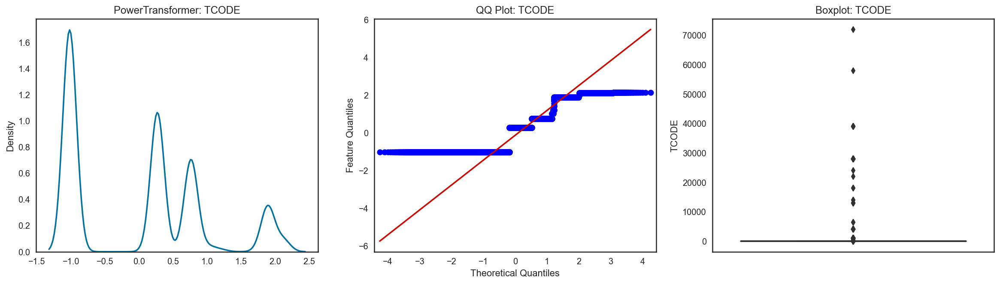

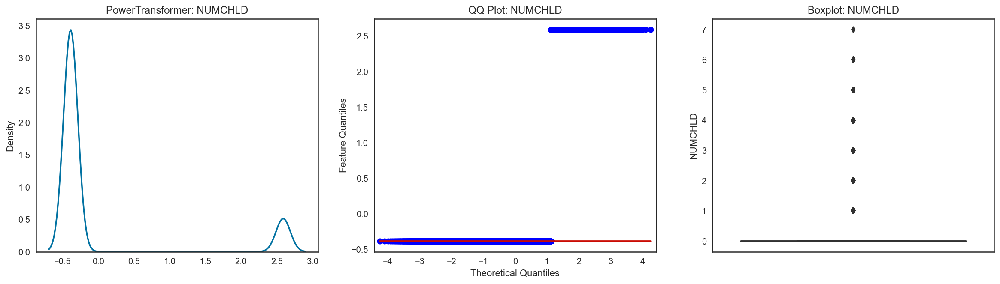

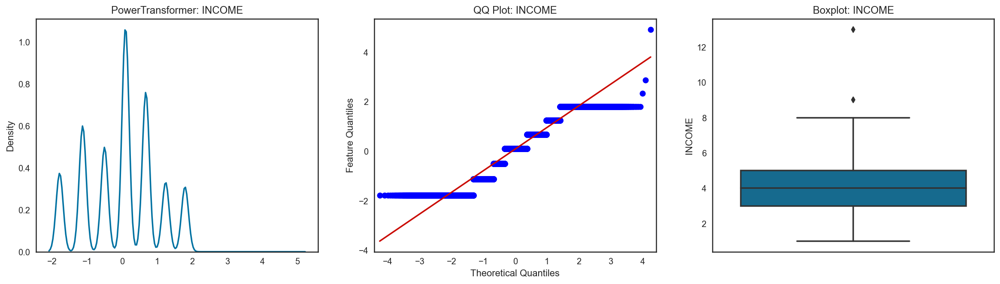

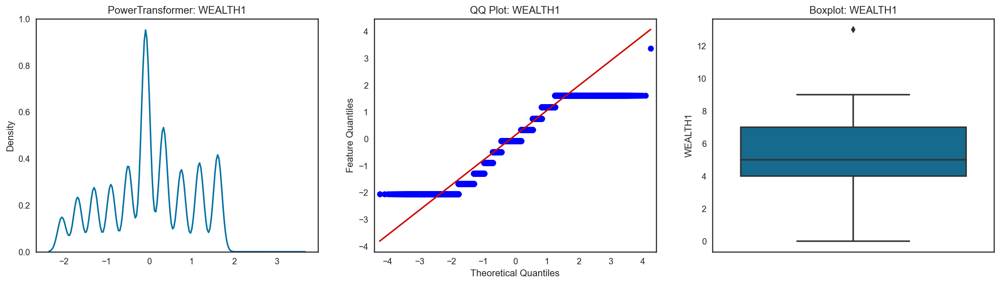

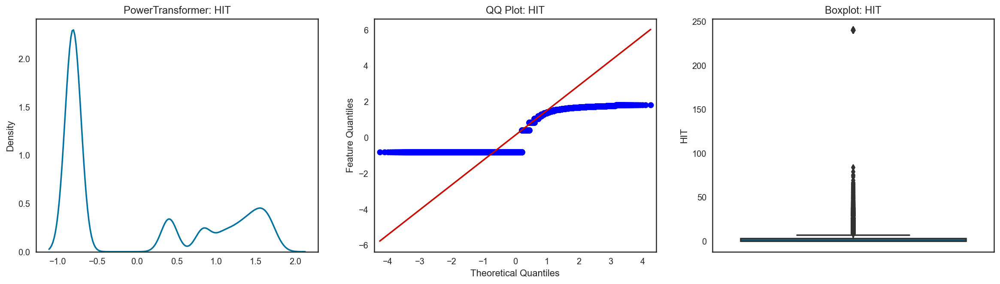

...

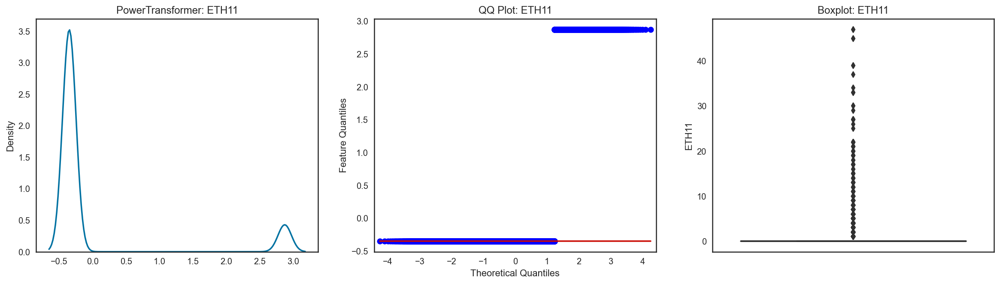

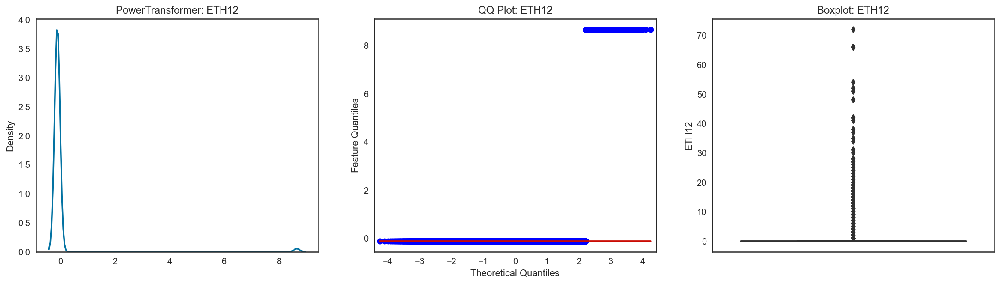

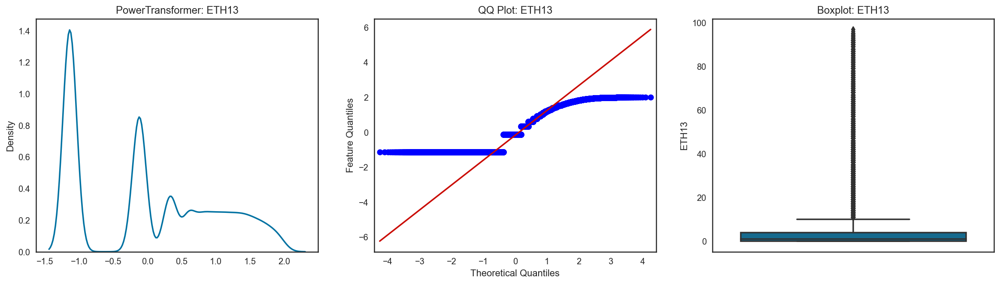

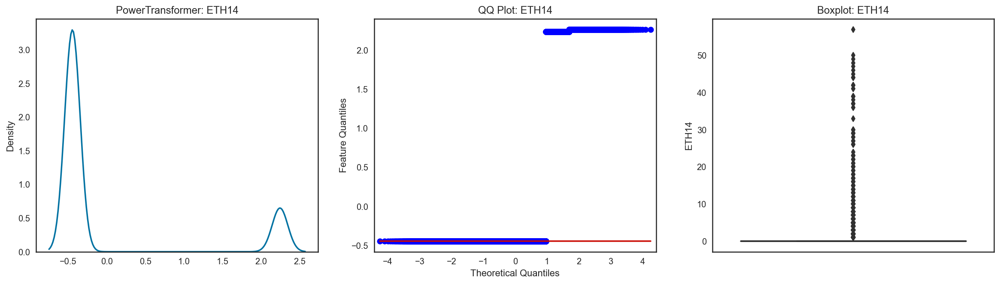

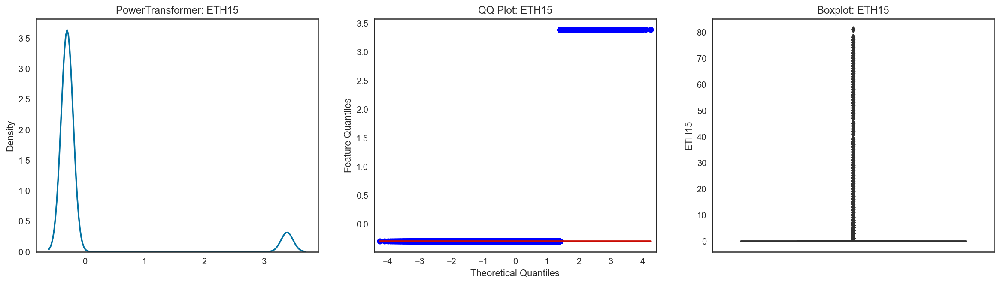

In [27]:
for i in metric_main.columns[0:50]:
    plots(metric_main, i, PowerTransformer(method='yeo-johnson'))

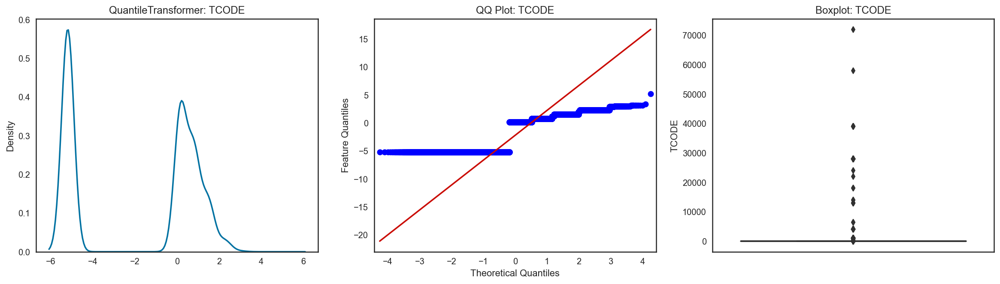

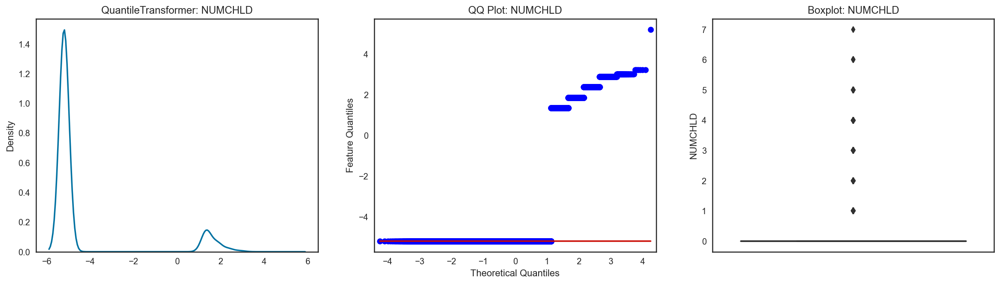

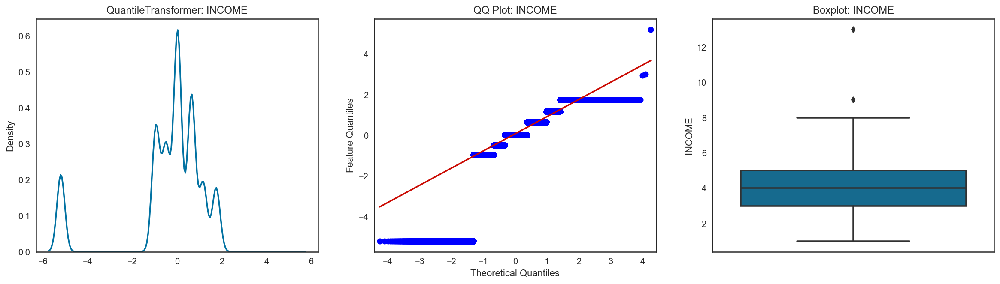

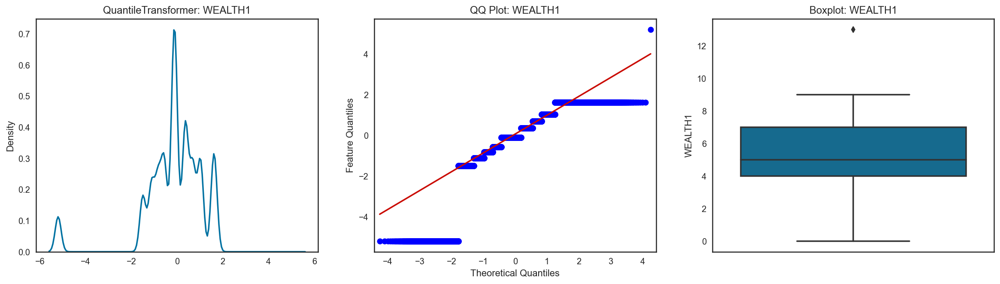

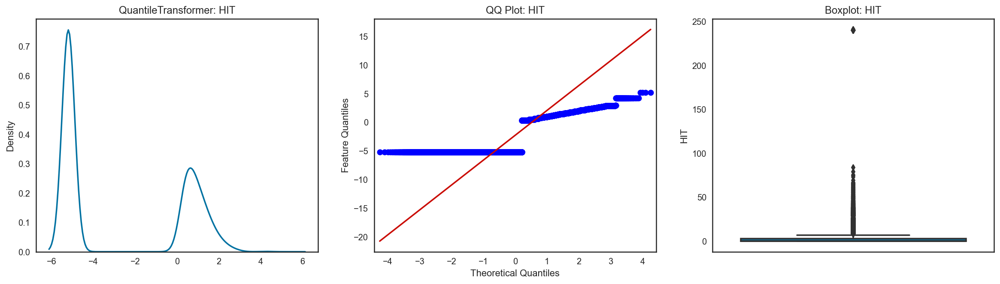

...

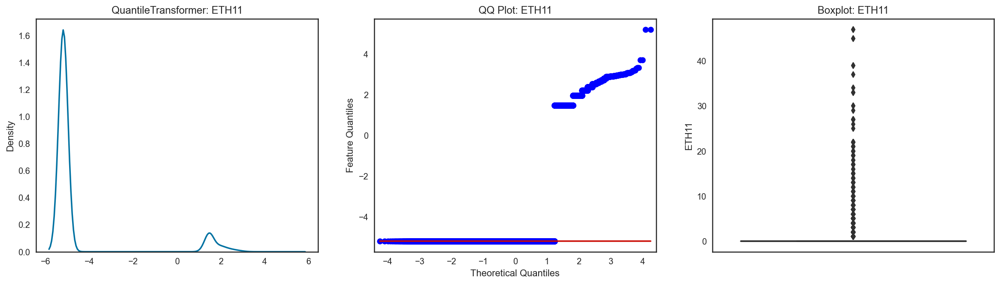

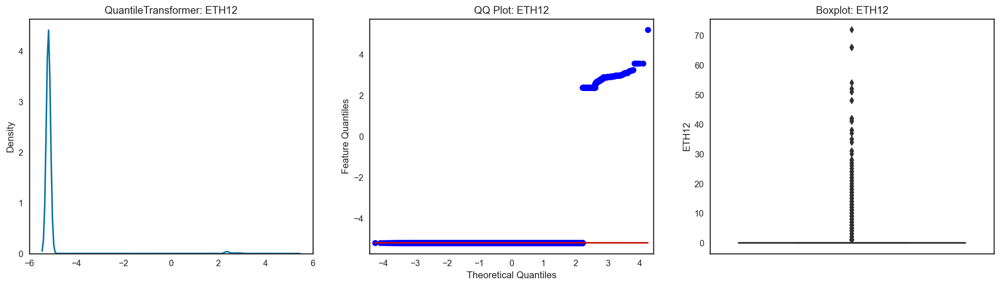

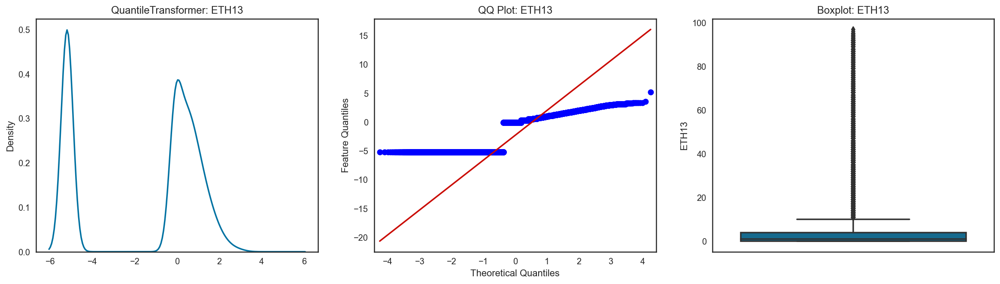

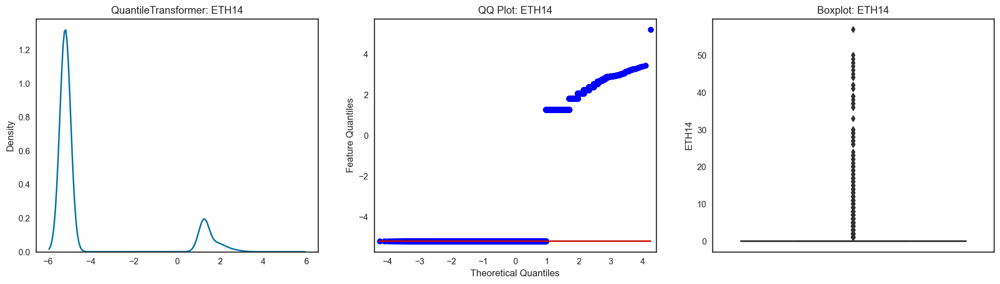

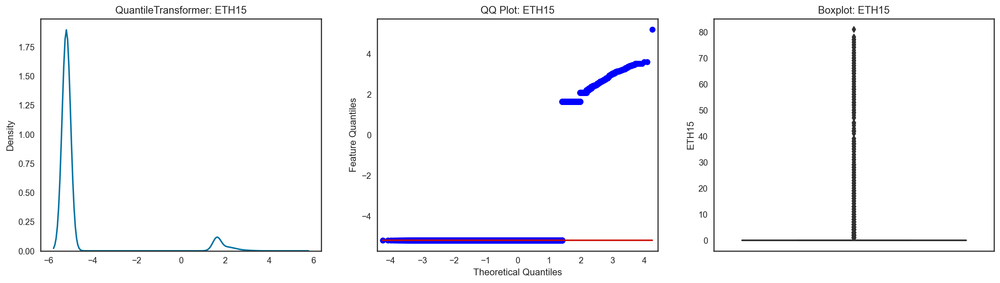

In [28]:
for i in metric_main.columns[0:50]:
    plots(metric_main, i, QuantileTransformer(n_quantiles=500, output_distribution='normal', random_state=random_state))

### 3.1 Univariate Normal Distribution

We are going to use 2 common approaches to make data more Gaussian-like:
* Yeo-Johnson
* Quantile transformations

In [29]:
def data_normalization(df,index,random):
    if (not os.path.exists('trans.pkl')) | recalculate:
        main_df = df.set_index(index) if index!='' else df
        metric_df = main_df.select_dtypes(include=['number'])
        #Declare instances for qt & yj
        yj = PowerTransformer(method='yeo-johnson')
        qt = QuantileTransformer(n_quantiles=500, output_distribution='normal', random_state=random)
        #Fit into qt & yeo-johnson
        X_trans_yj = yj.fit_transform(metric_df)
        X_trans_qt = qt.fit_transform(metric_df)
        X_trans = np.concatenate((X_trans_yj, X_trans_qt), axis=1)
        #Creating dataframe
        merge_labels = list(map(lambda i:'yj_'+i, metric_df.columns.to_list()))+list(map(lambda i:'qt_'+ i, metric_df.columns.to_list()))
        trans_df = pd.DataFrame(X_trans, columns=merge_labels, index=metric_df.index)
        trans_df.to_pickle('trans.pkl')
    else: trans_df = pd.read_pickle('trans.pkl')
    #Get standarized dataframes
    transyj_df = trans_df.loc[:,[i for i in trans_df.columns.to_list() if 'yj' in i]]
    transqt_df = trans_df.loc[:,[i for i in trans_df.columns.to_list() if 'qt' in i]]
    return transyj_df, transqt_df

In [30]:
def out_std(data, nstd=3.0, return_thresholds=False):
    data_mean, data_std = data.mean(), data.std()
    cut_off = data_std * nstd
    lower, upper = data_mean - cut_off, data_mean + cut_off
    if return_thresholds: return lower, upper
    else: return data.apply(lambda i: np.any((i<lower)|(i>upper)),1)

In [31]:
def out_iqr(data, k=1.5, return_thresholds=False):
    if (not os.path.exists('outlier_labels.pkl')) | recalculate:
        #calculate the iq range
        q25 , q75 = np.percentile(data, 25, axis=0), np.percentile(data, 75, axis=0)
        iqr = q75 - q25
        #calculate the outlier cutoff range
        cut_off = iqr * k
        lower, upper = q25 - cut_off, q75 + cut_off
        if return_thresholds: return lower, upper
        else: return data.apply(lambda i: np.any((i<lower)|(i>upper)),1) #return outliers
        outlier_labels = pd.concat([out_iqr(transyj_df, 3.5), out_iqr(transqt_df, 3.5)], axis=1)
        outlier_labels.columns = ["outyjiqr","outqtiqr"]
        outlier_labels.to_pickle('outlier_labels.pkl')
    else:
        outlier_labels = pd.read_pickle('outlier_labels.pkl')

In [32]:
transyj_df, transqt_df = data_normalization(main_data,'index',random_state)

#### 3.1.1 Plot Data Distribution Yeo-Johnson

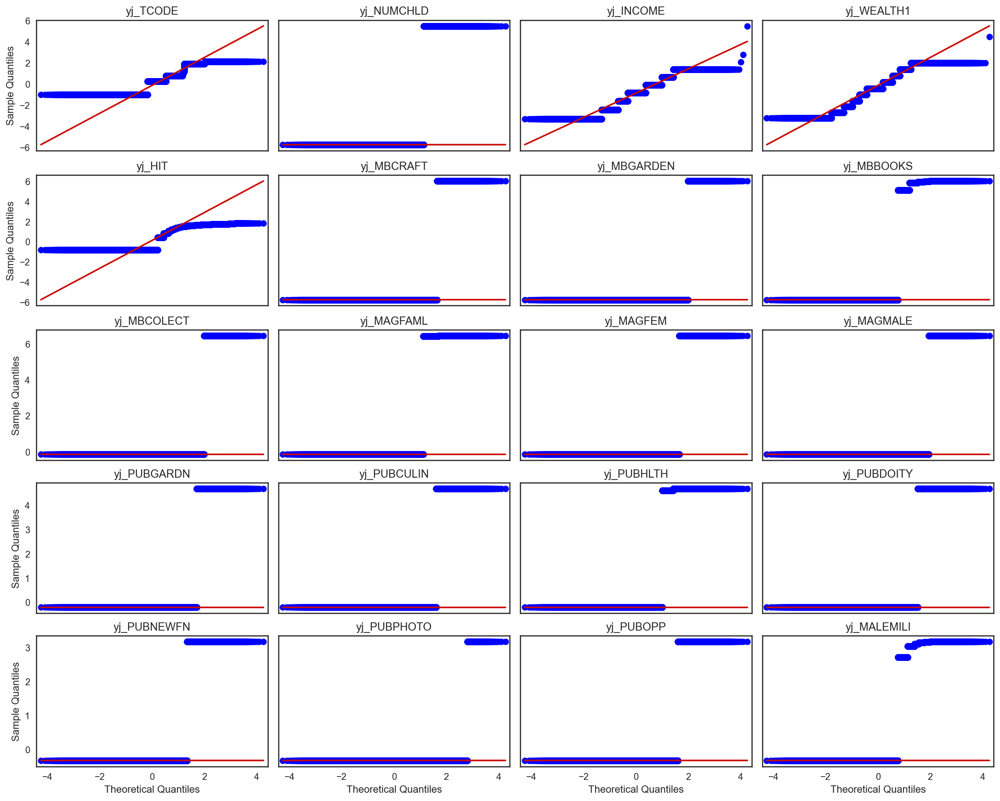

In [33]:
fig,axes = plt.subplots(5,4, constrained_layout=True, figsize=(15,12))
for col,ax in zip(transyj_df.columns[0:20], axes.flatten()):
    qqplot(transyj_df.loc[:,col], line='q', ax=ax)
    ax.set_title(col)
for ax in fig.get_axes():
    ax.label_outer()
plt.show()

In [34]:
#getting % of outliers by applying different computations: standard deviation & mean distance , iqr)
outlier_labels = pd.concat([out_std(transyj_df, 4), out_std(transqt_df, 4), out_iqr(transyj_df, 2.5), out_iqr(transqt_df, 2.5)], axis=1)
outlier_labels.columns = ['outyjstd','outqtstd','outyjiqr','outqtiqr']

In [35]:
print('% outliers after out_std & yeo-johnshon:',np.round(outlier_labels['outyjstd'].value_counts()[0]/len(outlier_labels)*100,2))
print('% outliers after out_std & quantile-transformation:',np.round(outlier_labels['outqtstd'].value_counts()[0]/len(outlier_labels)*100,2))
print('% outliers after iqr & yeo-johnshon:',np.round(outlier_labels['outyjiqr'].value_counts().values[0]/len(outlier_labels)*100,2))
print('% outliers after iqr & quantile-transformation:',np.round(outlier_labels['outqtiqr'].value_counts().values[0]/len(outlier_labels)*100,2))

% outliers after out_std & yeo-johnshon: 59.99
% outliers after out_std & quantile-transformation: 49.02
% outliers after iqr & yeo-johnshon: 99.94
% outliers after iqr & quantile-transformation: 100.0


After the data has been transformed  by using some scaling & transformation techniques we conclude that are not appropiate for handling outliers hence we are going to apply different techniques as part of multivariate normal analysis

By using the functions out_std and out_iqr we obtain the potential outlier labels according to each transformation.
The value 1 classifies an observation as a potential outlier as long as at least one variable has an abnormal value. 

We define **abnormal values** has the ones outside the 2.5 x Interquantile Range (out_iqr) and the ones more than 4 Standard Deviations away from the mean (out_std). We defined this more unrestrictive criteria since the data already had high variation by nature.

### 3.2 Multivariate Normal Distribution

In [36]:
def out_mahalanobis(data, random, contamination=0.03):
    n=data.shape[0]
    df=data.shape[1]
    #Using ellipticenvelope to detect outliers in a transformed gaussian distributed dataset
    ee_out=cov.EllipticEnvelope(contamination=contamination, support_fraction=0.95, random_state=random).fit(data)
    #Computes the mahalanobis distances of given observations to the center
    mahal=ee_out.mahalanobis(data)
    #Obtain chi-square percentiles of each observations to the center
    quantiles=chi2.ppf(q=np.fromfunction(lambda x:(x-0.5)/n,(n,)), df=df)
    #Obtain set of predicted outliers those of which are distributed (1->inlier & -1->negative outlier)
    labels=ee_out.predict(data)    
    return mahal, quantiles, labels

In [37]:
def remove_outliers(df,index,random):
    #Apply data normalization
    transyj_df, transqt_df = data_normalization(df,index,random)
    #Call mahalanobis
    if (not os.path.exists('lqt_lyj.pkl')) | recalculate:
        mqt, qqt, lqt = out_mahalanobis(transqt_df, random)
        myj, qyj, lyj = out_mahalanobis(transyj_df, random)
        lqt_lyj = pd.DataFrame({'lqt': lqt, 'lyj': lyj}, index=df.set_index(index).index)
        lqt_lyj.to_pickle('lqt_lyj.pkl')
    else:
        lqt_lyj = pd.read_pickle('lqt_lyj.pkl')
    #Checking outliers precentage (1->inlier & -1->negative outlier)
    inl = lqt_lyj.loc[(lqt_lyj['lqt'] == 1) & (lqt_lyj['lyj'] == 1)].sum()['lqt']
    print('Outliers Percentage: {:4.2f}%'.format(100 - inl/len(lqt_lyj) * 100))
    #Creating mask for outliers' drop
    lqt_lyj.loc[(lqt_lyj['lqt'] == 1) & (lqt_lyj['lyj'] == 1), 'mask'] = True
    lqt_lyj.fillna(False, inplace=True)
    lqt_lyj.drop(columns=['lqt', 'lyj'], inplace=True)
    #Update dataframe marking the outliers for remotion
    main_df = df.set_index(index).merge(lqt_lyj, left_index=True, right_index=True)
    clean_df = main_df.loc[main_df['mask'] == True]
    clean_df.drop(columns=['mask'], inplace=True)
    return clean_df

In [38]:
def apply_multivariate_transfomer(yt_df,qt_df,random):
        myj, qyj, lyj = out_mahalanobis(yt_df,random)
        mqt, qqt, lqt = out_mahalanobis(qt_df,random)
        lqt_lyj = pd.DataFrame({'lqt': lqt, 'lyj': lyj})
        return [[np.sort(myj), qyj, 'Yeo-Johnson'], [np.sort(mqt), qqt, 'Quantile Transformation']]

In [39]:
def plot_outlier_fitting(values):
    fig, axes = plt.subplots(1, 2, constrained_layout=True, figsize=(15,6))
    fig.suptitle('Chi-Square Plot', fontsize=25)
    for ax,v in zip(axes.flatten(), values):
        ax.scatter(v[1], v[0], s=25)
        ax.plot(v[1], v[1], '-r', label='Multivariate Normality')
        ax.legend(loc='upper left')
        ax.set_title(v[2])
        ax.set_xlabel('Chi-Square Quantiles')
        ax.set_ylabel('Mahalanobis')    
    plt.show()

#### 3.2.1 Multivariate Normal Distribution Visualization before Outliers Remotion

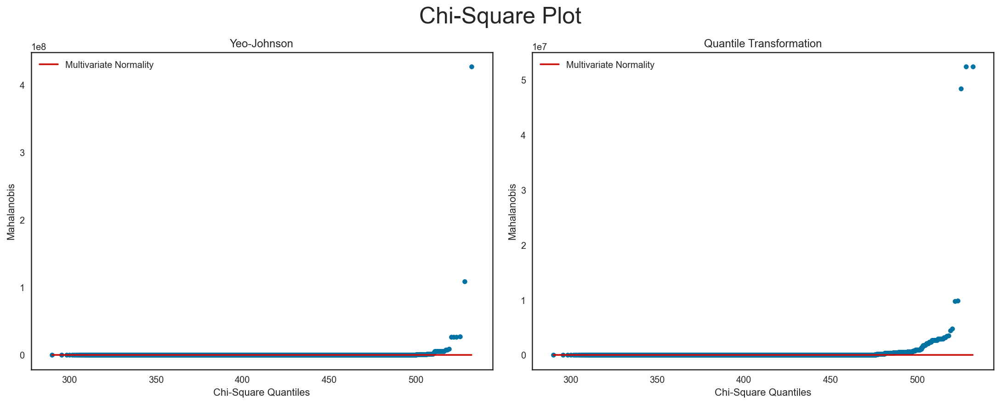

In [40]:
main_values_transf=apply_multivariate_transfomer(transyj_df,transqt_df,random_state)
plot_outlier_fitting(main_values_transf)

In [41]:
cleaned_data=remove_outliers(main_data,'index',random_state)

Outliers Percentage: 4.84%


* From the graph above we can observe that Yeo-Johnson and Quantile transformations provide somehow a fit to a multivariate normal distribution altough it's not perfect (because the observations don't match the red line as it would be expected in the case of multivariate normality) the Yeo-Johnson seems to have a better fit than the Quantiles Transformation.


* In addition, we can assess that our data without the outliers is much closer to multivariate normality even though visually looks otherwise. If we take a closer look at the scale on both plots, the data with the outliers has values on the scale of 1e8 which are much far from the centre of the distribution than the values represented on the data without the outliers.

#### 3.2.2 Multivariate Normal Distribution Visualization before Outliers Remotion

In [42]:
transyj_out_df, transqt_out_df = data_normalization(cleaned_data,'',random_state)

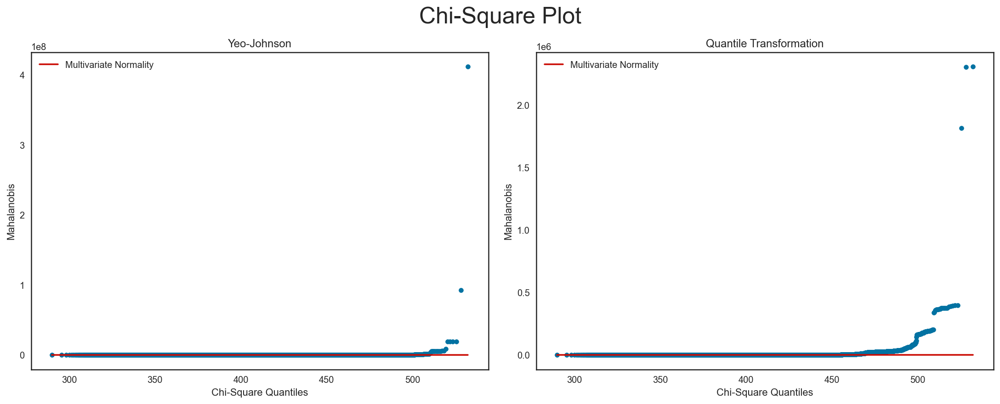

In [43]:
main_out_transf=apply_multivariate_transfomer(transyj_out_df,transqt_out_df,random_state)
plot_outlier_fitting(main_out_transf)

### 3.3 Categorical Outliers

In [44]:
def get_cat_outliers(df,dtypes,coeff):
    dict={}
    #list of categorical variables
    for i in df.select_dtypes(include=dtypes).columns:
        aItem=[]
        for j in range(len(df[i].value_counts())):
            #define a threshold to get those elements that don't match the minimum number of ocurrances
            #the comparision is against the maximum number of ocurrances per column
            if np.round(df[i].value_counts()[j]/df[i].value_counts().max(),2)*100<coeff: 
                aItem.append(df[i].value_counts().index[j])
        #append to the dictionary
        if len(aItem)>0: dict.update({i:aItem})
    return dict #return the list of categorical variables with the elements that dont fullfilled the threshold

In [45]:
#define 1% as minimum outlier coefficient & get the list of elements
cat_outliers=get_cat_outliers(cleaned_data,['object'],1)

In [46]:
#check the results 
for i in cat_outliers.keys():
    nOut=len(cleaned_data[cleaned_data[i].isin(cat_outliers[i])])
    print('Categorical Variable: {}, Records: {}, Percentage: {}%'.format(i,nOut,np.round(nOut/len(cleaned_data[i])*100,2)))

Categorical Variable: OSOURCE, Records: 3469, Percentage: 3.83%
Categorical Variable: STATE, Records: 423, Percentage: 0.47%
Categorical Variable: PVASTATE, Records: 5, Percentage: 0.01%
Categorical Variable: NOEXCH, Records: 277, Percentage: 0.31%
Categorical Variable: RECPGVG, Records: 109, Percentage: 0.12%
Categorical Variable: CHILD03, Records: 264, Percentage: 0.29%
Categorical Variable: CHILD07, Records: 483, Percentage: 0.53%
Categorical Variable: CHILD12, Records: 137, Percentage: 0.15%
Categorical Variable: CHILD18, Records: 253, Percentage: 0.28%
Categorical Variable: SOLP3, Records: 88, Percentage: 0.1%
Categorical Variable: SOLIH, Records: 196, Percentage: 0.22%
Categorical Variable: MAJOR, Records: 282, Percentage: 0.31%
Categorical Variable: RFA_3, Records: 953, Percentage: 1.05%
Categorical Variable: RFA_4, Records: 617, Percentage: 0.68%
Categorical Variable: RFA_5, Records: 425, Percentage: 0.47%
Categorical Variable: RFA_6, Records: 652, Percentage: 0.72%
Categorical

* We didn't run the code below as it has having 5% outliers remotion for categorical (quite high) those added to the metrical outliers will move the account to a 10% that's why we didn't move ahead with this approach due to the high number of observations that potentially could have been removed

In [47]:
#Backup the dataframe & remove the elements
#cleaned_df=cleaned_data.copy()
#for i in list(cat_outliers.keys()):
#    cleaned_df.drop(index=list(cleaned_df[cleaned_df[i].isin(cat_outliers[i])].loc[:,i].index),axis=0,inplace=True)
#print('Percentage of categorical outliers removed:',np.round((len(cleaned_data)-len(cleaned_df))/len(cleaned_data),2)*100)

### 3.4 UMAP for Initial Data Distribution

In [48]:
def apply_umap(df,normalize=True):
    metric=df.select_dtypes(include='number')
    #apply data scaling transformation
    if normalize:
        for i in metric: 
            metric.loc[:,i]=PowerTransformer(method='yeo-johnson').fit_transform(np.array(metric[i]).reshape(-1,1))
    #applying get_dummies for categorical
    non_metric=pd.get_dummies(df.select_dtypes(include='object'))
    non_metric_weight=len(df.select_dtypes(include='object').columns)/df.shape[1]
    #embedding numerical & categorical
    fit1=umap.UMAP(metric='l2').fit(metric)
    fit2=umap.UMAP(metric='dice').fit(non_metric)
    #sugmenting the numerical embedding with categorical
    intersection = umap.umap_.general_simplicial_set_intersection(fit1.graph_, fit2.graph_, weight=non_metric_weight)
    intersection = umap.umap_.reset_local_connectivity(intersection)
    #perform a fuzzy simplicial set embedding, using a specified initialization method and then minimizing the fuzzy set cross entropy
    embedding = umap.umap_.simplicial_set_embedding(fit1._raw_data, intersection, fit1.n_components, 
                                                fit1._initial_alpha, fit1._a, fit1._b, 
                                                fit1.repulsion_strength, fit1.negative_sample_rate, 
                                                200, 'random', np.random, fit1.metric, 
                                                fit1._metric_kwds, False)
    return embedding

#### 3.4.1 UMAP for Dataset Before Normalization

In [49]:
embedding=apply_umap(cleaned_data,False)

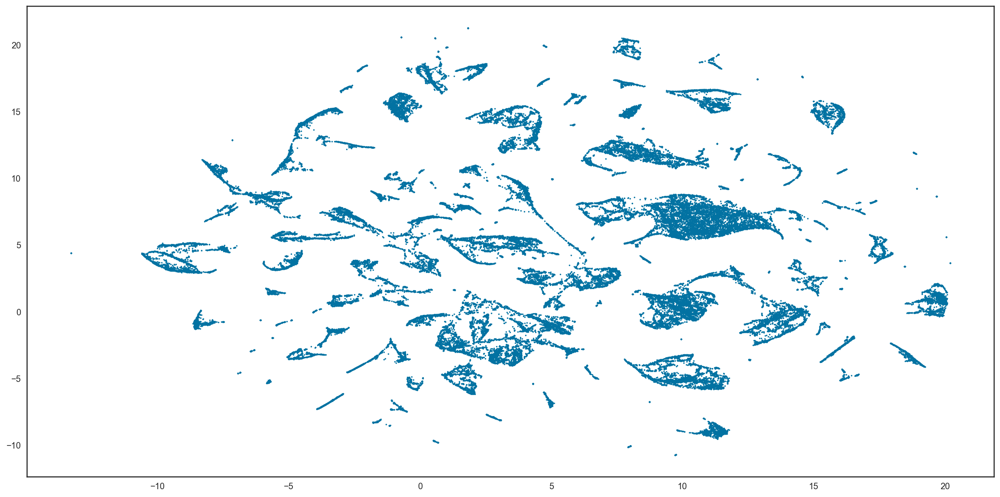

In [50]:
plt.figure(figsize=(20, 10))
plt.scatter(*embedding.T, s=2, cmap='Spectral', alpha=1.0)
plt.show()

#### 3.4.2 UMAP for Dataset After Normalization

In [51]:
embedding=apply_umap(cleaned_data)

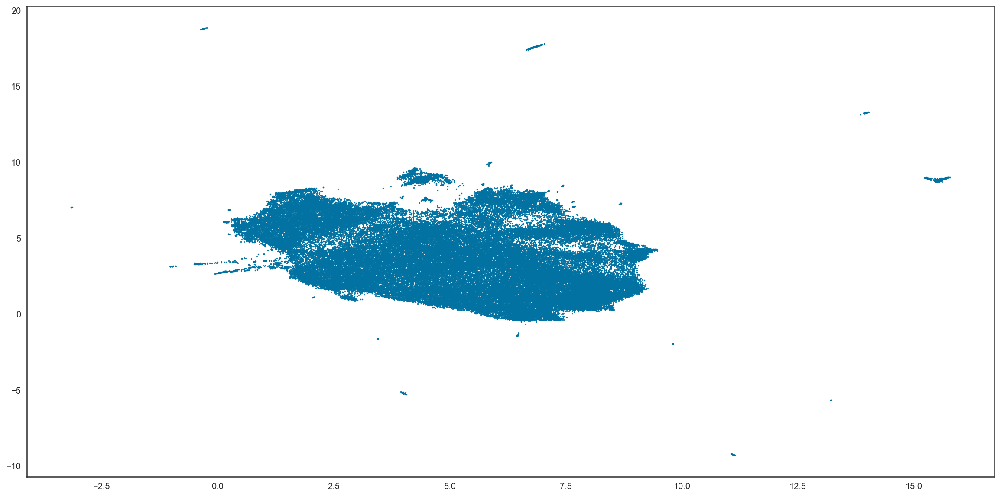

In [52]:
plt.figure(figsize=(20, 10))
plt.scatter(*embedding.T, s=2, cmap='Spectral', alpha=1.0)
plt.show()

## 4. Dimensionality Reduction

In [53]:
group=pd.read_excel(os.path.join(os.getcwd(),'Data/group.xlsx'))

In [54]:
aColumns=['FISTDATE','NEXTDATE','MINRDATE','MAXADATE','ODATEDW','MAXRDATE','LASTDATE']
for i in aColumns: 
    group['Var']=group['Var'].str.replace(i, 'N_'+i, regex=False)
group=group.groupby('Group', as_index=False).agg({'Var': ','.join})

In [55]:
metric_cleaned=cleaned_data.select_dtypes(include='number').columns.tolist()
non_metric_cleaned=cleaned_data.select_dtypes(exclude='number').columns.tolist()

In [56]:
data_ss=pd.DataFrame(StandardScaler().fit_transform(cleaned_data[metric_cleaned]),columns=metric_cleaned).set_index(cleaned_data.index)
data_ss=pd.concat([data_ss,cleaned_data.loc[:,non_metric_cleaned]],axis=1)
data_ss.head()

,TCODE,NUMCHLD,INCOME,WEALTH1,HIT,MBCRAFT,MBGARDEN,MBBOOKS,MBCOLECT,MAGFAML,MAGFEM,MAGMALE,PUBGARDN,PUBCULIN,PUBHLTH,PUBDOITY,PUBNEWFN,PUBPHOTO,PUBOPP,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,WEALTH2,POP901,POP902,POP903,POP90C1,POP90C2,POP90C3,POP90C4,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,ETH6,ETH7,ETH8,ETH9,ETH10,ETH11,ETH12,ETH13,ETH14,ETH15,ETH16,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,AGE907,CHIL1,CHIL2,CHIL3,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,CHILC1,CHILC2,CHILC3,CHILC4,CHILC5,HHAGE1,HHAGE2,HHAGE3,HHN1,HHN2,HHN3,HHN4,HHN5,HHN6,MARR1,MARR2,MARR3,MARR4,HHP1,HHP2,DW1,DW2,DW3,DW4,DW5,DW6,DW7,DW8,DW9,HV1,HV2,HV3,HV4,HU1,HU2,HU3,HU4,HU5,HHD1,HHD2,HHD3,HHD4,HHD5,HHD6,HHD7,HHD8,HHD9,HHD10,HHD11,HHD12,ETHC1,ETHC2,ETHC3,ETHC4,ETHC5,ETHC6,HVP1,HVP2,HVP3,HVP4,HVP5,HVP6,HUR1,HUR2,RHP1,RHP2,RHP3,RHP4,HUPA1,HUPA2,HUPA3,HUPA4,HUPA5,HUPA6,HUPA7,RP1,RP2,RP3,RP4,MSA,ADI,DMA,IC1,IC2,IC3,IC4,IC5,IC6,IC7,IC8,IC9,IC10,IC11,IC12,IC13,IC14,IC15,IC16,IC17,IC18,IC19,IC20,IC21,IC22,IC23,HHAS1,HHAS2,HHAS3,HHAS4,MC1,MC2,MC3,TPE1,TPE2,TPE3,TPE4,TPE5,TPE6,TPE7,TPE8,TPE9,PEC1,PEC2,TPE10,TPE11,TPE12,TPE13,LFC1,LFC2,LFC3,LFC4,LFC5,LFC6,LFC7,LFC8,LFC9,LFC10,OCC1,OCC2,OCC3,OCC4,OCC5,OCC6,OCC7,OCC8,OCC9,OCC10,OCC11,OCC12,OCC13,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,OEDC7,EC1,EC2,EC3,EC4,EC5,EC6,EC7,EC8,SEC1,SEC2,SEC3,SEC4,SEC5,AFC1,AFC2,AFC3,AFC4,AFC5,AFC6,VC1,VC2,VC3,VC4,ANC1,ANC2,ANC3,ANC4,ANC5,ANC6,ANC7,ANC8,ANC9,ANC10,ANC11,ANC12,ANC13,ANC14,ANC15,POBC1,POBC2,LSC1,LSC2,LSC3,LSC4,VOC1,VOC2,VOC3,HC1,HC2,HC3,HC4,HC5,HC6,HC7,HC8,HC9,HC10,HC11,HC12,HC13,HC14,HC15,HC16,HC17,HC18,HC19,HC20,HC21,MHUC1,MHUC2,AC1,AC2,CARDPROM,NUMPROM,CARDPM12,NUMPRM12,RAMNT_3,RAMNT_4,RAMNT_5,RAMNT_6,RAMNT_7,RAMNT_8,RAMNT_9,RAMNT_10,RAMNT_11,RAMNT_12,RAMNT_13,RAMNT_14,RAMNT_15,RAMNT_16,RAMNT_17,RAMNT_18,RAMNT_19,RAMNT_20,RAMNT_21,RAMNT_22,RAMNT_23,RAMNT_24,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MAXRAMNT,LASTGIFT,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2F,AGE,N_ADATE_2,N_ADATE_3,N_ADATE_4,N_ADATE_5,N_ADATE_6,N_ADATE_7,N_ADATE_8,N_ADATE_9,N_ADATE_10,N_ADATE_11,N_ADATE_12,N_ADATE_13,N_ADATE_14,N_ADATE_15,N_ADATE_16,N_ADATE_17,N_ADATE_18,N_ADATE_19,N_ADATE_20,N_ADATE_21,N_ADATE_22,N_ADATE_23,N_ADATE_24,N_RDATE_3,N_RDATE_4,N_RDATE_5,N_RDATE_6,N_RDATE_7,N_RDATE_8,N_RDATE_9,N_RDATE_10,N_RDATE_11,N_RDATE_12,N_RDATE_13,N_RDATE_14,N_RDATE_15,N_RDATE_16,N_RDATE_17,N_RDATE_18,N_RDATE_19,N_RDATE_20,N_RDATE_21,N_RDATE_22,N_RDATE_23,N_RDATE_24,N_FISTDATE,N_LASTDATE,N_MAXADATE,N_MINRDATE,N_NEXTDATE,N_MAXRDATE,N_ODATEDW,OSOURCE,STATE,ZIP,MAILCODE,PVASTATE,NOEXCH,RECINHSE,RECP3,RECPGVG,RECSWEEP,DOMAIN,HOMEOWNR,CHILD03,CHILD07,CHILD12,CHILD18,GENDER,DATASRCE,SOLP3,SOLIH,MAJOR,GEOCODE,COLLECT1,VETERANS,BIBLE,CATLG,HOMEE,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,BOATS,WALKER,KIDSTUFF,CARDS,PLATES,LIFESRC,PEPSTRFL,RFA_2,RFA_3,RFA_4,RFA_5,RFA_6,RFA_7,RFA_8,RFA_9,RFA_10,RFA_11,RFA_12,RFA_13,RFA_14,RFA_15,RFA_16,RFA_17,RFA_18,RFA_19,RFA_20,RFA_21,RFA_22,RFA_23,RFA_24,RFA_2R,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2,MDMAUD_M
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,-0.056484,-0.339022,0.063326,-0.067802,-0.359111,-0.210819,-0.148904,-0.401004,-0.141417,-0.339122,-0.215411,-0.157479,-0.190095,-0.220597,-0.351784,-0.2129,-0.252319,-0.050476,-0.17738,-0.222578,0.764555,0.273976,-0.843689,0.723900,-0.510961,-0.521341,-0.039547,-0.400929,-0.418980,-0.424284,-1.227379,0.680791,0.955419,-0.257079,0.383747,0.337501,-0.385888,-0.224102,-0.411650,0.252353,-0.319811,-0

### 4.1 Metric features

#### 4.1.1 PCA

In [57]:
def apply_pca(df):
    pca = PCA()
    columns=df.select_dtypes(include='number').columns.tolist()
    pca_feat=pca.fit_transform(df[columns])
    cov_matrix = df[columns].cov()
    #composing back the covariance matrix
    df_pca=pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, index=cov_matrix.index, columns=cov_matrix.columns)
    df_pca_f=pd.DataFrame({'Eigenvalue': pca.explained_variance_,'Difference': np.insert(np.diff(pca.explained_variance_), 0, 0),'Proportion': pca.explained_variance_ratio_,'Cumulative': np.cumsum(pca.explained_variance_ratio_)},index=range(1, pca.n_components_ + 1))
    return pca, df_pca, df_pca_f

In [58]:
def plot_pca(pca):
    #figure & axes
    fig,(ax1,ax2)=plt.subplots(1,2,figsize=(30,15))
    ax1.plot(pca.explained_variance_, marker='.', markersize=20)
    ax2.plot(pca.explained_variance_ratio_, marker='.', markersize=20, label='Proportion')
    ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker='.', markersize=12, linestyle='--', label='Cumulative')
    #customizations
    ax2.legend()
    ax1.set_title('Scree Plot', fontsize=18)
    ax2.set_title('Variance Explained', fontsize=18)
    ax1.set_ylabel('Eigenvalue', fontsize=18)
    ax2.set_ylabel('Proportion', fontsize=18)
    ax1.set_xlabel('Components', fontsize=18)
    ax2.set_xlabel('Components', fontsize=18)
    ax1.set_xticks(range(0, pca.n_components_, 2))
    ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
    ax2.set_xticks(range(0, pca.n_components_, 2))
    ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))  
    plt.show()

In [59]:
def color_pca_red_green(corr):
    return 'background-color: red' if corr < -0.45 else 'background-color: green' if corr > 0.45 else ''

* Group:
    * 1: CHARACTERISTICS OF DONOR NEIGHBORHOOD
    * 4: GIVING HISTORY
    * 7: RESPONSE TO OTHER TYPES OF MAIL ORDERS
    * 8: SUMMARY VARIABLES OF GIVING HISTORY
    * 9: SUMMARY VARIABLES OF PROMOTION HISTORY


Group: CHARACTERISTICS OF DONOR NEIGHBORHOOD


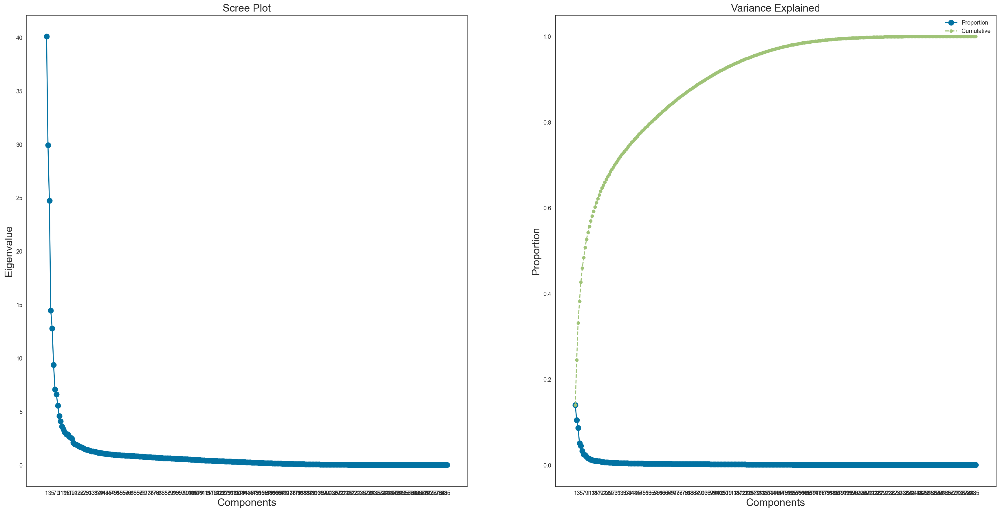

Component PC0, Cumulative Explained Ratio 14.02
Component PC1, Cumulative Explained Ratio 24.49
Component PC2, Cumulative Explained Ratio 33.14
Component PC3, Cumulative Explained Ratio 38.2
Component PC4, Cumulative Explained Ratio 42.67
Component PC5, Cumulative Explained Ratio 45.94
Component PC6, Cumulative Explained Ratio 48.41
Component PC7, Cumulative Explained Ratio 50.72
Component PC8, Cumulative Explained Ratio 52.67
Component PC9, Cumulative Explained Ratio 54.26
Component PC10, Cumulative Explained Ratio 55.7
Component PC11, Cumulative Explained Ratio 56.96
Component PC12, Cumulative Explained Ratio 58.13
Component PC13, Cumulative Explained Ratio 59.19
Component PC14, Cumulative Explained Ratio 60.2
Component PC15, Cumulative Explained Ratio 61.2
Component PC16, Cumulative Explained Ratio 62.14
Component PC17, Cumulative Explained Ratio 63.04
Component PC18, Cumulative Explained Ratio 63.91
Component PC19, Cumulative Explained Ratio 64.65
Component PC20, Cumulative Explain


Group: GIVING HISTORY


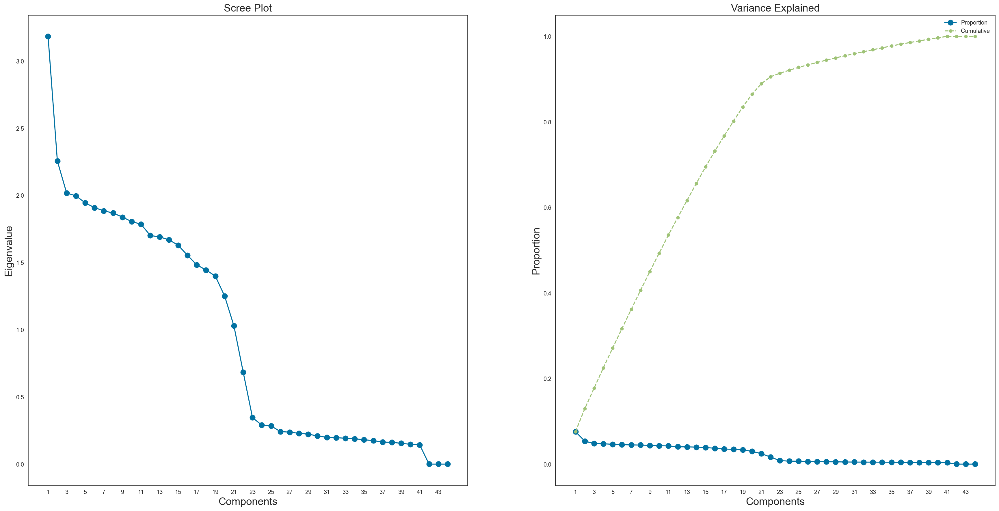

Component PC0, Cumulative Explained Ratio 7.58
Component PC1, Cumulative Explained Ratio 12.95
Component PC2, Cumulative Explained Ratio 17.76
Component PC3, Cumulative Explained Ratio 22.51
Component PC4, Cumulative Explained Ratio 27.14
Component PC5, Cumulative Explained Ratio 31.69
Component PC6, Cumulative Explained Ratio 36.18
Component PC7, Cumulative Explained Ratio 40.63
Component PC8, Cumulative Explained Ratio 45.01
Component PC9, Cumulative Explained Ratio 49.3
Component PC10, Cumulative Explained Ratio 53.56
Component PC11, Cumulative Explained Ratio 57.61
Component PC12, Cumulative Explained Ratio 61.64
Component PC13, Cumulative Explained Ratio 65.61
Component PC14, Cumulative Explained Ratio 69.49
Component PC15, Cumulative Explained Ratio 73.19
Component PC16, Cumulative Explained Ratio 76.73
Component PC17, Cumulative Explained Ratio 80.17
Component PC18, Cumulative Explained Ratio 83.5
Component PC19, Cumulative Explained Ratio 86.48
Component PC20, Cumulative Explai

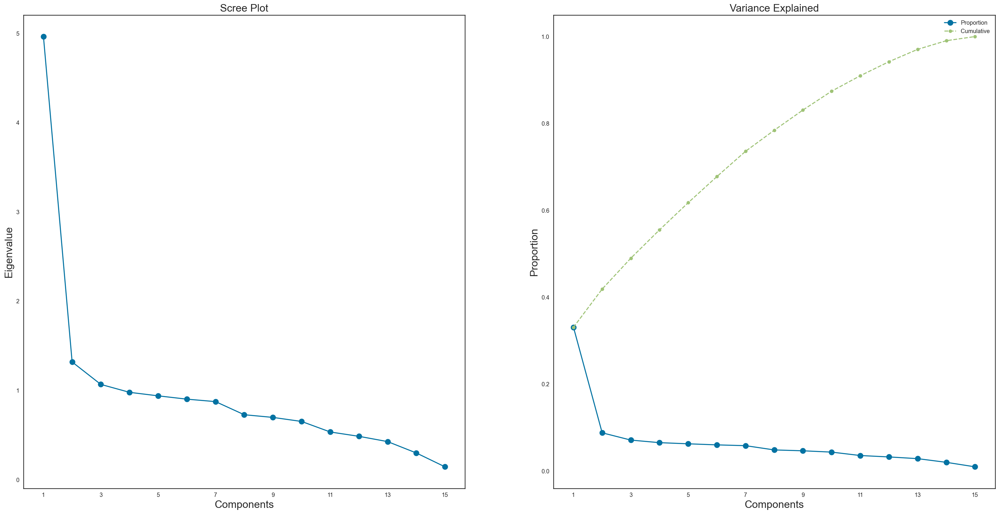

Component PC0, Cumulative Explained Ratio 33.09
Component PC1, Cumulative Explained Ratio 41.87
Component PC2, Cumulative Explained Ratio 48.98
Component PC3, Cumulative Explained Ratio 55.5
Component PC4, Cumulative Explained Ratio 61.76
Component PC5, Cumulative Explained Ratio 67.77
Component PC6, Cumulative Explained Ratio 73.59
Component PC7, Cumulative Explained Ratio 78.44
Component PC8, Cumulative Explained Ratio 83.08
Component PC9, Cumulative Explained Ratio 87.43
Component PC10, Cumulative Explained Ratio 90.98
Component PC11, Cumulative Explained Ratio 94.22
Component PC12, Cumulative Explained Ratio 97.05
Component PC13, Cumulative Explained Ratio 99.05

Group: SUMMARY VARIABLES OF GIVING HISTORY


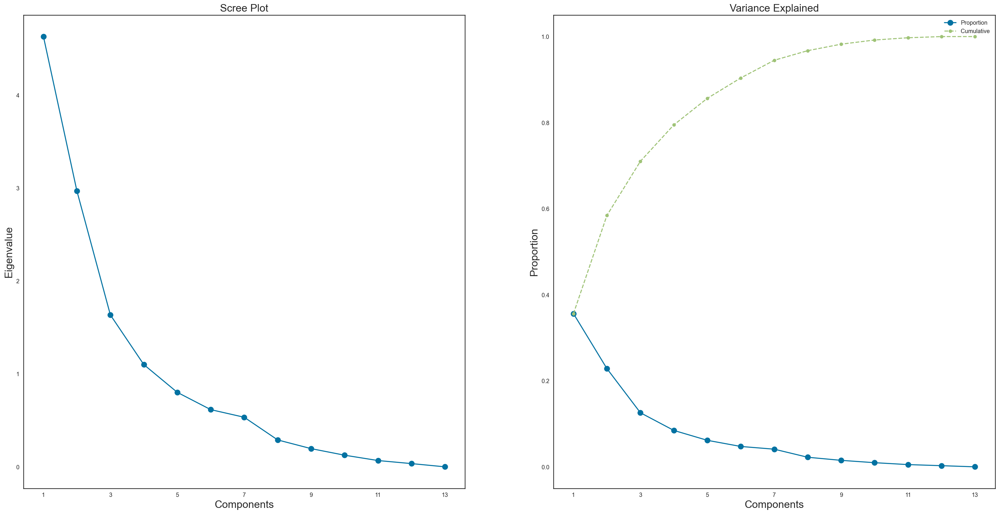

Component PC0, Cumulative Explained Ratio 35.61
Component PC1, Cumulative Explained Ratio 58.44
Component PC2, Cumulative Explained Ratio 71.01
Component PC3, Cumulative Explained Ratio 79.48
Component PC4, Cumulative Explained Ratio 85.64
Component PC5, Cumulative Explained Ratio 90.38
Component PC6, Cumulative Explained Ratio 94.49
Component PC7, Cumulative Explained Ratio 96.72
Component PC8, Cumulative Explained Ratio 98.23
Component PC9, Cumulative Explained Ratio 99.2
Component PC10, Cumulative Explained Ratio 99.72

Group: SUMMARY VARIABLES OF PROMOTION HISTORY


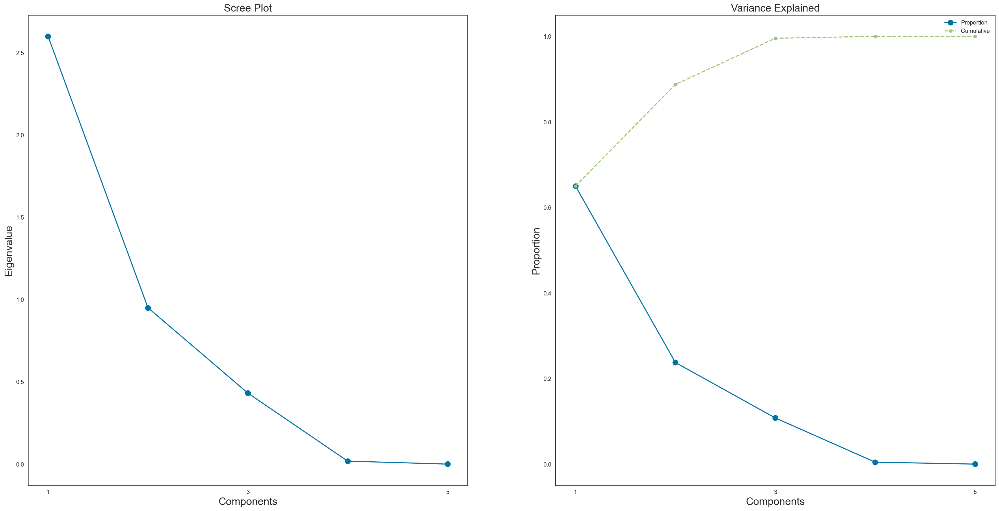

Component PC0, Cumulative Explained Ratio 65.0
Component PC1, Cumulative Explained Ratio 88.75
Component PC2, Cumulative Explained Ratio 99.55


In [60]:
dic={}
for i in [1,4,7,8,9]:
    dic['df'+str(i)],found=group.shift(i).add_suffix('df'+str(i)),False
    dic['df'+str(i)]=data_ss.loc[:,group.loc[i,'Var'].split(',')]
    dic['pca'+str(i)],dic['df_pca'+str(i)],dic['df_pca_f'+str(i)],dic['pctg_cum'+str(i)]='','','',''
    dic['pca'+str(i)],dic['df_pca'+str(i)],dic['df_pca_f'+str(i)]=apply_pca(dic['df'+str(i)])
    print('\nGroup: '+str.upper(group.loc[i,'Group']))
    plot_pca(dic['pca'+str(i)])
    for j in range(len(dic['pca'+str(i)].explained_variance_ratio_*100)):
        dic['pctg_cum'+str(i)]=np.round(np.sum(dic['pca'+str(i)].explained_variance_ratio_[0:j+1])*100,2)
        if dic['pctg_cum'+str(i)]<100:
            print('Component PC{}, Cumulative Explained Ratio {}'.format(j,dic['pctg_cum'+str(i)]))
            if dic['pctg_cum'+str(i)]>=86 and not(found):
                dic['n_components'+str(i)],found=j,True
    dic['pca'+str(i)]=PCA(n_components=dic['n_components'+str(i)])
    dic['metric_cleaned'+str(i)]=dic['df_pca'+str(i)].select_dtypes(include='number').columns.tolist()
    dic['pca_feat'+str(i)]=dic['pca'+str(i)].fit_transform(dic['df_pca'+str(i)][dic['metric_cleaned'+str(i)]])
    dic['pca_feat_names'+str(i)]=[f'PC{z}' for z in range(dic['pca'+str(i)].n_components_)]
    dic['pca_df'+str(i)]=pd.DataFrame(dic['pca_feat'+str(i)], index=dic['df_pca'+str(i)].index, columns=dic['pca_feat_names'+str(i)])
    #reassigning dataframe to contain pca variables
    dic['df_pca'+str(i)] = pd.concat([dic['df_pca'+str(i)], dic['pca_df'+str(i)]], axis=1)

#### 4.1.2 List of Most Important Features


Group: CHARACTERISTICS OF DONOR NEIGHBORHOOD - Most Relevant Features
['IC3' 'HHD2' 'ETHC3' 'ETHC2' 'POP90C5' 'POBC1' 'ETH2' 'HHAS4' 'TPE10'
 'ETH4' 'CHILC5' 'AFC1' 'POP902' 'DW9' 'ANC10' 'OEDC3' 'DW7' 'LSC4' 'EIC4'
 'HUPA4' 'IC8' 'ETH12' 'HU4' 'ETH3' 'HC3' 'HC9' 'VC2' 'ETH15' 'PEC1'
 'SEC1' 'ANC1' 'ANC3' 'IC17' 'IC18' 'HC15' 'EIC5' 'LFC8' 'ANC15' 'EIC6'
 'TPE7' 'LFC9' 'EIC10' 'EIC12' 'ANC6' 'TPE6' 'OEDC7' 'ANC14' 'EIC7'
 'ANC13' 'ETH11' 'SEC3']


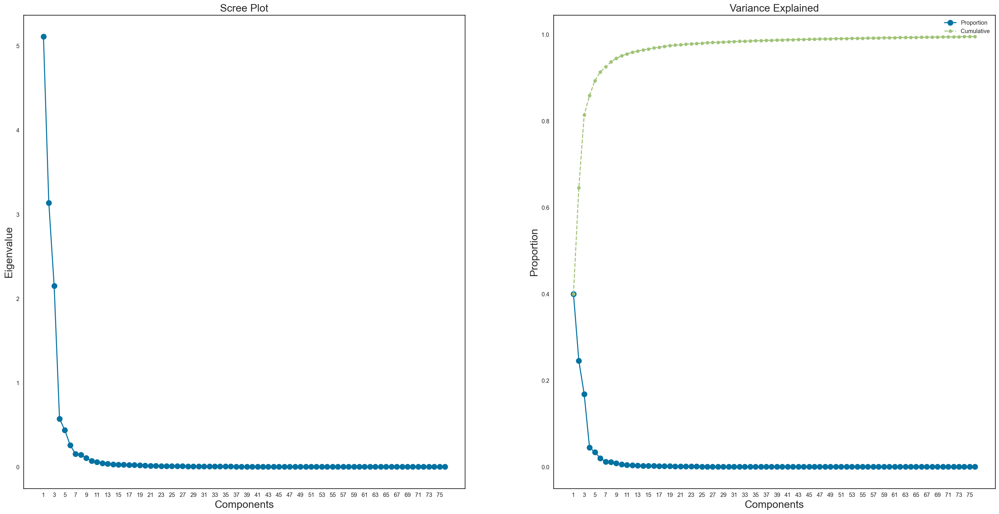


Group: GIVING HISTORY - Most Relevant Features
['N_RDATE_15' 'N_RDATE_20' 'RAMNT_9' 'N_RDATE_6' 'N_RDATE_7' 'N_RDATE_3'
 'RAMNT_12' 'RAMNT_7' 'RAMNT_11' 'RAMNT_17' 'RAMNT_14' 'N_RDATE_21'
 'RAMNT_4' 'RAMNT_13' 'N_RDATE_19' 'RAMNT_23' 'RAMNT_18' 'RAMNT_24']


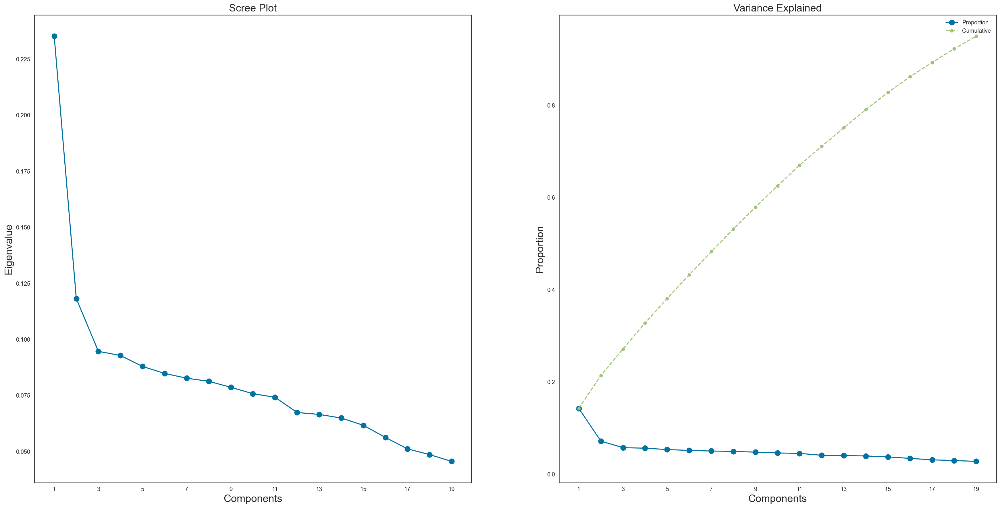


Group: RESPONSE TO OTHER TYPES OF MAIL ORDERS - Most Relevant Features
['MBBOOKS' 'MBGARDEN' 'PUBPHOTO' 'PUBOPP' 'MAGMALE' 'MBCOLECT' 'MBCRAFT'
 'MAGFAML']


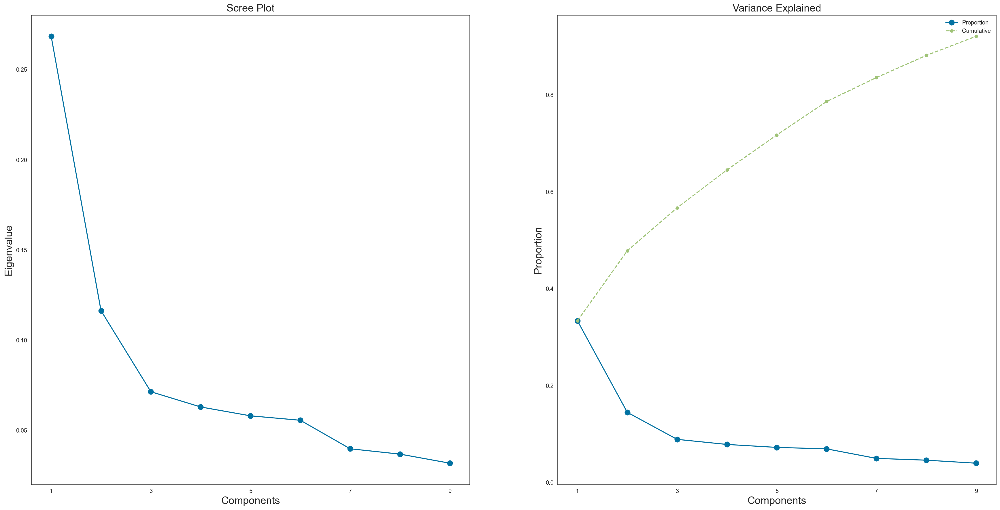


Group: SUMMARY VARIABLES OF GIVING HISTORY - Most Relevant Features
['N_FISTDATE' 'MAXRAMNT' 'N_LASTDATE' 'N_MAXRDATE']


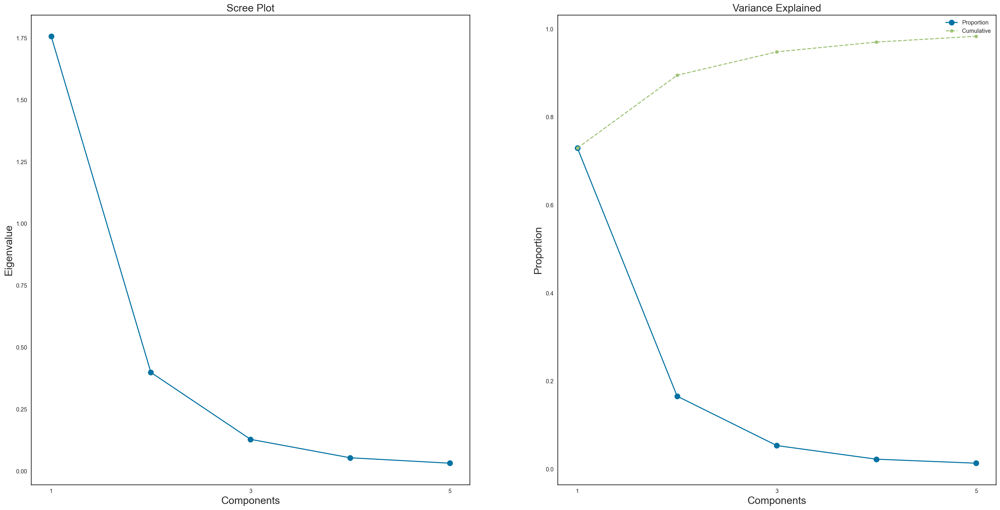


Group: SUMMARY VARIABLES OF PROMOTION HISTORY - Most Relevant Features
['CARDPROM']


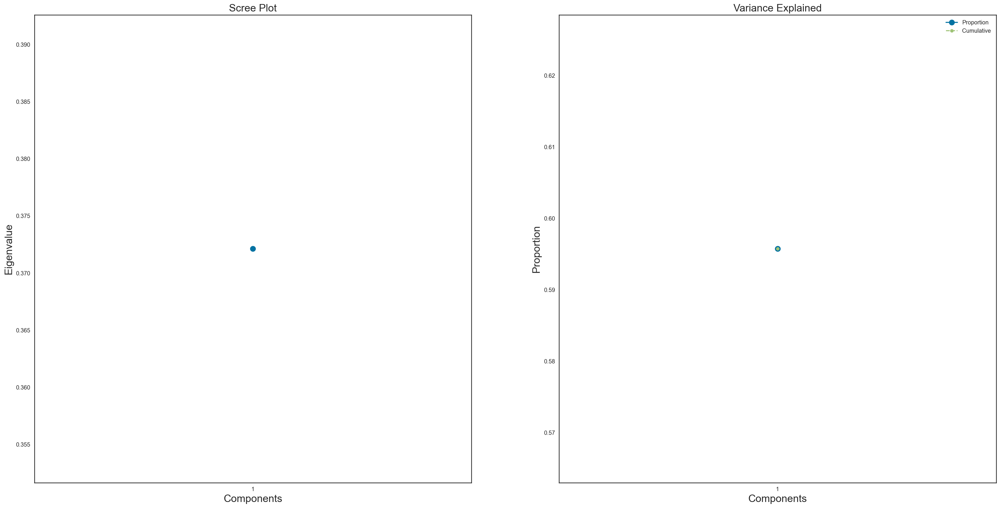

In [61]:
feat={}
for i in [1,4,7,8,9]:
    print('\nGroup: '+str.upper(group.loc[i,'Group']) + ' - Most Relevant Features')
    dic['print_df_pca'+str(i)]=dic['df_pca'+str(i)][dic['metric_cleaned'+str(i)] + dic['pca_feat_names'+str(i)]].corr().loc[dic['metric_cleaned'+str(i)], dic['pca_feat_names'+str(i)]].style.applymap(color_pca_red_green)
    dic['most_important'+str(i)] = [np.abs(dic['pca'+str(i)].components_[j]).argmax() for j in range(dic['pca'+str(i)].n_components)]
    metric_cleaned=dic['df'+str(i)].select_dtypes(include='number').columns.tolist()
    dic['most_important_names'+str(i)] = list(dict.fromkeys([metric_cleaned[dic['most_important'+str(i)][j]] for j in range(dic['pca'+str(i)].n_components)]))
    print(np.array(dic['most_important_names'+str(i)]))
    plot_pca(dic['pca'+str(i)])


Group: CHARACTERISTICS OF DONOR NEIGHBORHOOD - Most Relevant Features
['IC3' 'HHD2' 'ETHC3' 'ETHC2' 'POP90C5' 'POBC1' 'ETH2' 'HHAS4' 'TPE10'
 'ETH4' 'CHILC5' 'AFC1' 'POP902' 'DW9' 'ANC10' 'OEDC3' 'DW7' 'LSC4' 'EIC4'
 'HUPA4' 'IC8' 'ETH12' 'HU4' 'ETH3' 'HC3' 'HC9' 'VC2' 'ETH15' 'PEC1'
 'SEC1' 'ANC1' 'ANC3' 'IC17' 'IC18' 'HC15' 'EIC5' 'LFC8' 'ANC15' 'EIC6'
 'TPE7' 'LFC9' 'EIC10' 'EIC12' 'ANC6' 'TPE6' 'OEDC7' 'ANC14' 'EIC7'
 'ANC13' 'ETH11' 'SEC3']


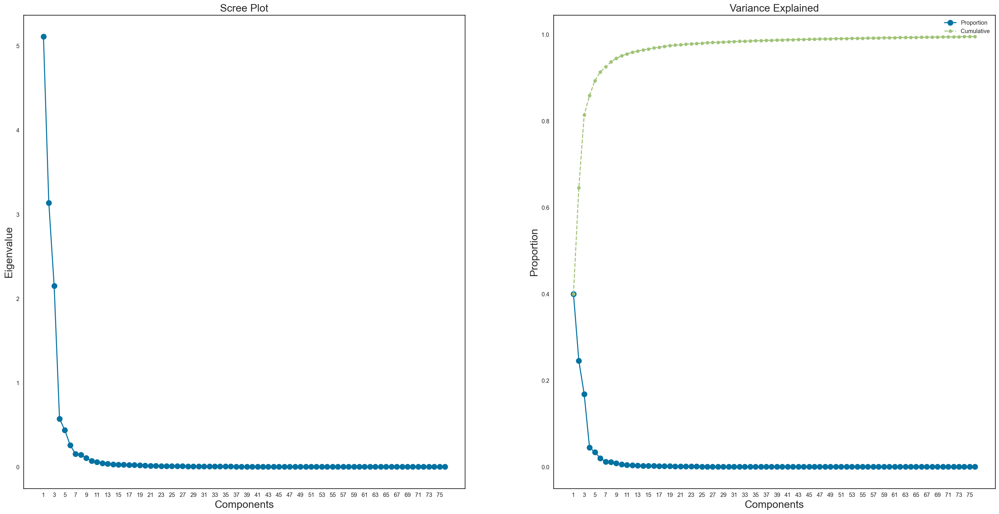


Group: GIVING HISTORY - Most Relevant Features
['N_RDATE_15' 'N_RDATE_20' 'RAMNT_9' 'N_RDATE_6' 'N_RDATE_7' 'N_RDATE_3'
 'RAMNT_12' 'RAMNT_7' 'RAMNT_11' 'RAMNT_17' 'RAMNT_14' 'N_RDATE_21'
 'RAMNT_4' 'RAMNT_13' 'N_RDATE_19' 'RAMNT_23' 'RAMNT_18' 'RAMNT_24']


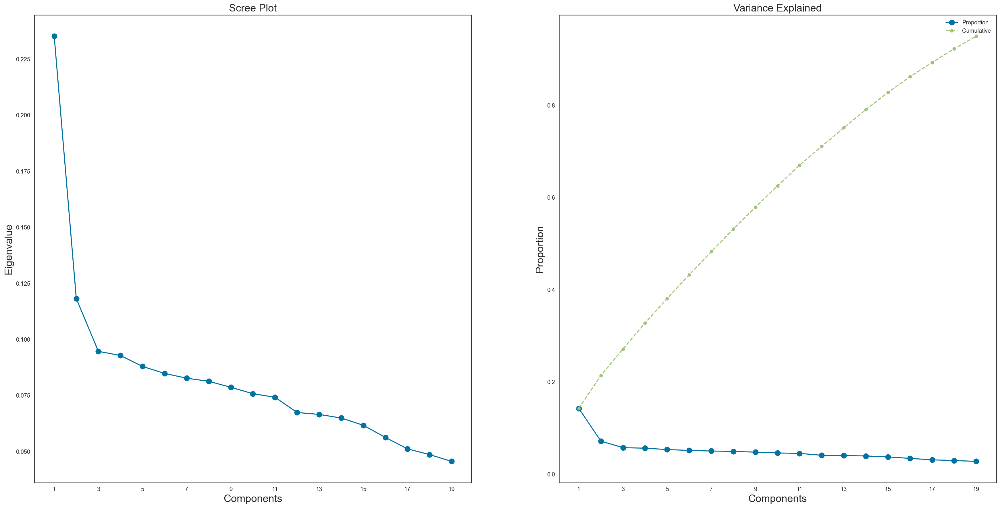


Group: RESPONSE TO OTHER TYPES OF MAIL ORDERS - Most Relevant Features
['MBBOOKS' 'MBGARDEN' 'PUBPHOTO' 'PUBOPP' 'MAGMALE' 'MBCOLECT' 'MBCRAFT'
 'MAGFAML']


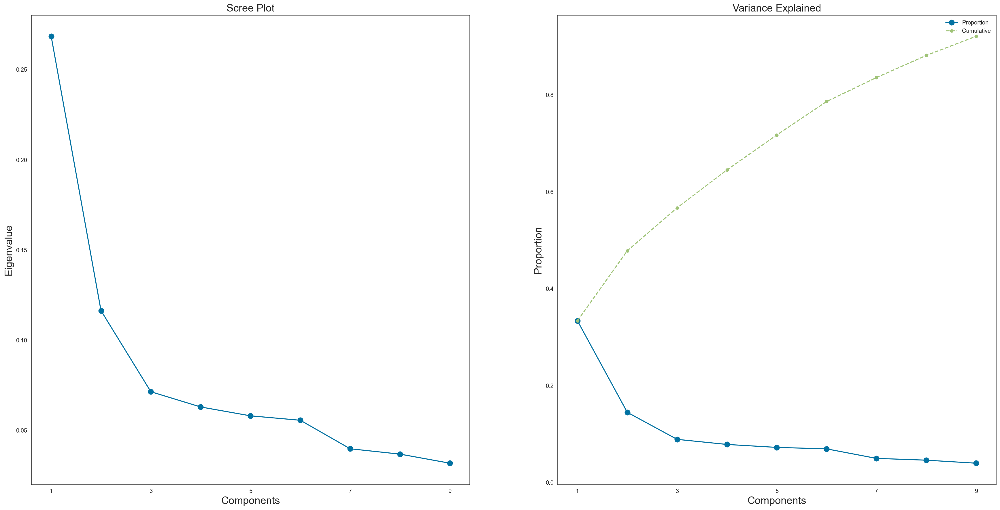


Group: SUMMARY VARIABLES OF GIVING HISTORY - Most Relevant Features
['N_FISTDATE' 'MAXRAMNT' 'N_LASTDATE' 'N_MAXRDATE']


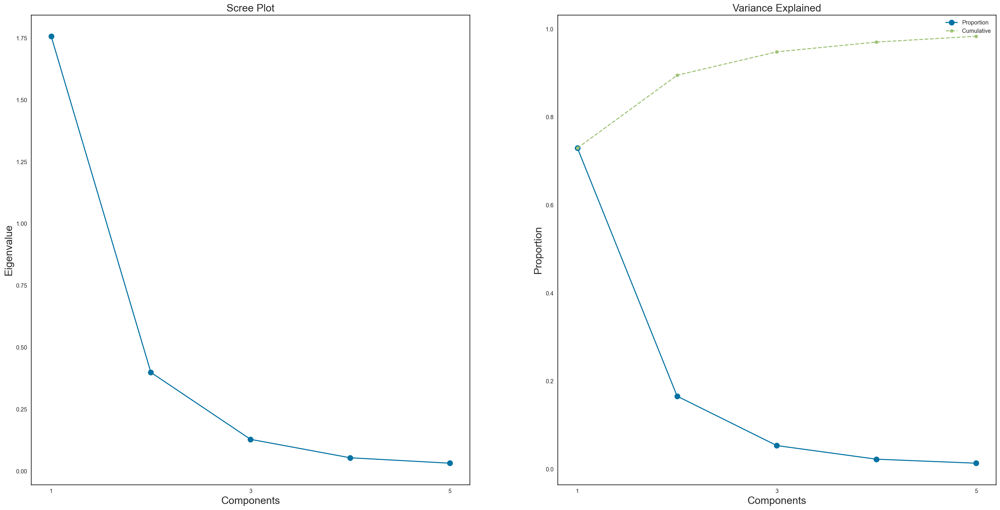


Group: SUMMARY VARIABLES OF PROMOTION HISTORY - Most Relevant Features
['CARDPROM']


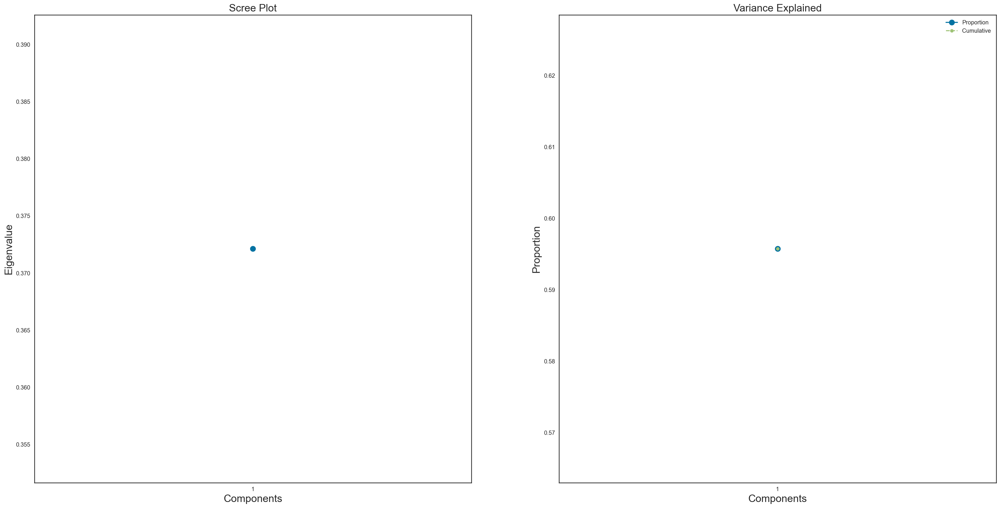

In [62]:
feat={}
for i in [1,4,7,8,9]:
    print('\nGroup: '+str.upper(group.loc[i,'Group']) + ' - Most Relevant Features')
    dic['print_df_pca'+str(i)]=dic['df_pca'+str(i)][dic['metric_cleaned'+str(i)] + dic['pca_feat_names'+str(i)]].corr().loc[dic['metric_cleaned'+str(i)], dic['pca_feat_names'+str(i)]].style.applymap(color_pca_red_green)
    dic['most_important'+str(i)] = [np.abs(dic['pca'+str(i)].components_[j]).argmax() for j in range(dic['pca'+str(i)].n_components)]
    metric_cleaned=dic['df'+str(i)].select_dtypes(include='number').columns.tolist()
    dic['most_important_names'+str(i)] = list(dict.fromkeys([metric_cleaned[dic['most_important'+str(i)][j]] for j in range(dic['pca'+str(i)].n_components)]))
    print(np.array(dic['most_important_names'+str(i)]))
    plot_pca(dic['pca'+str(i)])

In [237]:
dic['print_df_pca1'] #CHARACTERISTICS OF DONOR NEIGHBORHOOD

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,PC51,PC52,PC53,PC54,PC55,PC56,PC57,PC58,PC59,PC60,PC61,PC62,PC63,PC64,PC65,PC66,PC67,PC68,PC69,PC70,PC71,PC72,PC73,PC74,PC75
POP901,0.060254,-0.047506,-0.305926,0.096029,-0.150930,-0.155162,0.055072,-0.131606,0.051293,-0.152275,0.289044,-0.129454,0.127545,0.255060,0.766950,0.020905,-0.100458,0.074823,0.026046,-0.023557,-0.064989,0.019893,-0.010395,0.020769,-0.015975,-0.004999,-0.012103,-0.025685,0.021165,-0.008401,-0.020014,0.014338,-0.004521,-0.011019,-0.008812,-0.018100,-0.006590,-0.008695,0.004870,0.008370,-0.001883,-0.006024,-0.000467,-0.012940,-0.017199,0.002027,0.008888,0.011342,0.004505,0.013555,-0.007437,0.007746,-0.011608,-0.013730,0.000930,0.001158,0.010371,-0.014561,0.011611,-0.005589,-0.011307,0.006261,0.005896,-0.006337,0.003990,0.001648,-0.011262,-0.006483,0.004433,-0.007584,0.005383,-0.006058,0.006688,0.004643,-0.003298,-0.001294
POP902,0.009962,0.036681,-0.206466,0.131648,-0.166183,-0.180406,0.084771,-0.123448,0.070065,-0.163345,0.280178,-0.128788,0.136305,0.268055,0.782891,0.003559,-0.098281,0.073879,0.020064,-0.023031,-0.058854,0.021656,-0.009405,0.026259,-0.012262,-0.003847,-0.015424,-0.022677,0.019925,-0.008217,-0.017163,0.014336,-0.003169,-0.010157,-0.007767,-0.014140,-0.006862,-0.008939,0.005594,0.007882,-0.002611,-0.007438,-0.000996,-0.011818,-0.014822,0.004175,0.008704,0.010892,0.004036,0.013408,-0.007000,0.007912,-0.012275,-0.011854,-0.000237,-0.000873,0.010332,-0.013203,0.010079,-0.005087,-0.010748,0.006580,0.004898,-0.006625,0.002864,0.001741,-0.011617,-0.006578,0.005697,-0.007598,0.004825,-0.005025,0.006368,0.005114,-0.002008,-0.001202
POP903,0.119390,-0.222958,-0.189964,0.158536,-0.145605,-0.146024,0.051242,-0.142041,0.076014,-0.139385,0.279170,-0.120647,0.121303,0.255958,0.764513,0.003859,-0.095584,0.077352,0.020610,-0.019037,-0.066571,0.017814,-0.006809,0.025845,-0.013205,-0.010896,-0.010438,-0.028917,0.019081,-0.002770,-0.017524,0.016972,-0.005793,-0.012165,-0.008616,-0.017835,-0.004989,-0.009720,0.003261,0.011272,-0.003053,-0.005816,0.001889,-0.011058,-0.017325,0.002727,0.007312,0.010068,0.004807,0.012323,-0.005337,0.007521,-0.012700,-0.013429,0.000486,-0.001305,0.010005,-0.012126,0.011009,-0.004025,-0.010736,0.005048,0.004142,-0.004537,0.003155,0.001577,-0.011491,-0.006080,0.004590,-0.005249,0.005019,-0.005884,0.007939,0.002862,-0.001283,-0.001406
POP90C1,-0.490816,-0.706104,-0.324389,-0.071197,0.290111,-0.068910,0.115930,0.131049,0.031644,-0.018956,-0.025282,0.070464,-0.040035,0.015034,-0.000236,0.005830,0.022259,0.002364,0.024183,0.019801,-0.079483,0.028408,0.005192,0.015220,0.019519,-0.002062,-0.020267,0.004314,0.000301,-0.039105,0.010725,0.029268,-0.012125,-0.032811,0.000658,0.007597,0.000119,0.005041,-0.004817,0.011110,0.012310,0.036015,-0.012641,-0.002707,0.006242,0.003742,0.014377,0.002984,0.010822,0.013461,-0.001217,-0.014797,0.010362,0.003813,-0.017154,0.007643,0.001299,-0.004892,0.006948,0.028911,0.018251,0.014941,0.007353,-0.013775,-0.015188,-0.002451,-0.007164,-0.011655,-0.008112,-0.009967,-0.004007,-0.006811,-0.003870,0.004929,-0.007215,0.007322
POP90C2,0.642707,0.227487,0.279086,0.091524,0.121916,0.161911,0.054005,-0.047188,-0.324048,-0.218708,0.030812,-0.080138,0.211075,-0.081388,0.021498,-0.076142,-0.103113,-0.031668,-0.069182,-0.042246,0.194293,-0.125855,-0.036699,-0.065756,-0.052626,-0.004166,0.046502,-0.040439,0.007652,0.120866,0.021976,-0.084157,0.046379,0.079776,-0.000307,-0.013582,-0.027573,-0.047396,-0.014332,-0.019181,-0.047236,-0.095682,0.044566,-0.028500,-0.032888,-0.007126,-0.024275,0.003553,-0.027730,-0.031475,-0.008487,0.040054,-0.025111,0.009857,0.057314,-0.020408,0.006973,-0.000565,-0.024587,-0.079807,-0.041693,-0.061900,-0.002322,0.043225,0.050076,-0.003733,0.002358,0.052068,0.017654,0.025187,0.024597,0.026422,0.004523,-

In [238]:
dic['print_df_pca4'] #GIVING HISTORY

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18
N_RDATE_3,0.096254,-0.024900,0.008905,-0.004910,0.346758,0.725041,0.030302,-0.285040,-0.038494,-0.287369,-0.168640,-0.049020,0.029026,0.369846,0.003910,-0.007238,0.011742,-0.031843,0.012091
N_RDATE_4,0.108273,-0.000310,0.030903,-0.012224,0.206864,0.414575,0.033848,-0.117810,-0.061584,-0.041259,0.036972,-0.014137,-0.133976,-0.799428,0.221301,-0.087126,-0.009781,0.057536,-0.071795
N_RDATE_5,0.001434,0.273906,-0.173219,-0.358281,0.134913,-0.198618,-0.271754,0.065006,0.015133,-0.151791,0.063125,0.166411,0.142764,0.577995,-0.268728,0.115563,0.059910,-0.175147,0.217761
N_RDATE_6,-0.014434,-0.034430,0.422572,0.897342,0.099237,-0.062647,-0.001485,-0.016059,0.002634,-0.024586,0.001202,-0.011024,-0.005126,0.000068,0.002109,-0.001309,-0.000720,0.003620,0.001725
N_RDATE_7,-0.059842,0.256276,0.004902,-0.056579,0.519688,-0.105174,0.105941,-0.446840,0.140114,0.481706,0.294286,-0.034942,0.181412,0.018090,-0.042656,0.096468,0.034240,0.051266,0.055117
N_RDATE_8,-0.240663,-0.281022,0.269537,-0.027105,-0.455229,0.462029,0.120289,0.133279,-0.209977,0.382115,-0.044338,-0.122825,0.084857,0.000692,-0.024554,0.088702,0.018489,0.074948,0.045202
N_RDATE_9,-0.029249,-0.084348,-0.668300,0.313657,0.071131,0.164779,-0.086777,0.245334,0.214011,0.035099,0.111777,0.028627,-0.016178,0.038330,-0.061907,-0.421575,-0.090847,0.105412,-0.065072
N_RDATE_10,0.202906,0.434678,-0.043350,0.070504,-0.368146,0.003390,0.348412,-0.314504,0.217678,-0.109305,-0.128212,0.343686,-0.257395,0.049310,0.211577,0.154759,-0.113188,0.069577,-0.096649
N_RDATE_11,0.052865,0.245422,0.039732,-0.055845,0.362531,-0.087785,0.262918,0.397803,-0.611108,-0.242066,0.201033,0.136855,-0.072879,0.060469,0.074252,0.081052,-0.001812,0.021587,-0.031478
N_RDATE_12,-0.006390,-0.492824,0.257692,-0.179098,0.314544,-0.118881,-0.470720,0.065077,0.222147,-0.112351,-0.256848,0.223918,-0.152041,-0.021417,0.093892,0.141711,-0.026782,0.024413,-0.060366


In [239]:
dic['print_df_pca7'] #RESPONSE TO OTHER TYPES OF MAIL ORDERS

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
HIT,-0.739986,-0.273127,-0.128543,0.068867,-0.022163,-0.090798,-0.242379,0.091670,0.042771
MBCRAFT,-0.213934,0.122194,-0.559755,-0.353244,-0.036572,-0.263933,-0.482687,-0.410746,-0.124033
MBGARDEN,-0.138010,0.639056,-0.468065,-0.058502,0.080866,-0.142671,0.164833,0.491989,-0.212566
MBBOOKS,-0.957845,-0.070599,0.131760,0.072310,-0.044449,-0.021799,-0.094289,-0.002513,-0.105491
MBCOLECT,0.156872,-0.241714,-0.281980,0.129494,-0.277434,0.829266,-0.177399,0.042290,0.021501
MAGFAML,-0.457961,-0.424325,-0.260845,-0.291227,0.080150,-0.194105,-0.056090,0.183209,0.416072
MAGFEM,-0.338622,-0.387561,-0.011801,-0.616172,-0.261237,-0.029547,0.441825,-0.059882,0.150873
MAGMALE,0.107432,-0.305328,0.221134,-0.138752,0.892234,0.122624,-0.051631,-0.033840,-0.024892
PUBGARDN,-0.706470,0.528320,0.177989,0.125310,0.039267,0.123720,0.059340,-0.173605,0.296296
PUBCULIN,-0.765457,-0.041786,0.266395,-0.156548,-0.185995,0.101194,0.077689,-0.041147,-0.243134


In [240]:
dic['print_df_pca8'] #SUMMARY VARIABLES OF GIVING HISTORY

,PC0,PC1,PC2,PC3,PC4
RAMNTALL,-0.650556,-0.671936,-0.267071,0.044757,0.184506
NGIFTALL,-0.968004,-0.021448,-0.214536,0.013054,0.055855
CARDGIFT,-0.974643,0.029416,-0.176489,-0.008022,0.035170
MINRAMNT,0.963035,-0.149033,-0.061708,0.060907,-0.140375
N_MINRDATE,-0.929027,-0.092466,0.137762,-0.267460,-0.121476
MAXRAMNT,0.413484,-0.862440,-0.075902,0.017811,0.202336
N_MAXRDATE,-0.818261,0.059506,-0.010329,0.520814,-0.158719
LASTGIFT,0.659975,-0.704640,0.067369,-0.124200,-0.127497
N_LASTDATE,0.206607,0.271218,0.888838,0.068841,0.265067
N_FISTDATE,-0.987991,-0.059371,-0.012596,-0.084863,-0.076162


In [241]:
dic['most_important_names9'].append('NUMPROM')#Adding the second most relevant component as per the inertia
dic['print_df_pca9'] #SUMMARY VARIABLES OF PROMOTION HISTORY

,PC0
CARDPROM,-0.945117
N_MAXADATE,0.931383
NUMPROM,-0.976514
CARDPM12,-0.387326
NUMPRM12,-0.410082


### 4.2 Non-Metric Features

#### 4.2.1 MFA & FAMD
* MFA: Non-Metric Features
* FAMD: Metric and Non-Metric on the Same Group (Mixed Type of Data)

In [68]:
def apply_mfa(df,columns,name):#multiple factor analysis for categorical data
    mfa=prince.MFA(groups={name:columns}, n_components=len(pd.get_dummies(df[columns]).columns.tolist()), n_iter=5, copy=True, check_input=True, engine='auto', random_state=5)
    mfa.fit_transform(df[columns])
    df_corr=mfa.column_correlations(df[columns])
    df_corr.columns=[f'PC{i}' for i in range(mfa.n_components)]
    return mfa, df_corr

In [69]:
def apply_famd(df,columns):#factor analysis of mixed data
    famd=prince.FAMD(n_components=len(pd.get_dummies(df.loc[:,columns]).columns.tolist()), n_iter=5, copy=True, check_input=True, engine='auto', random_state=5)
    famd.fit_transform(df[columns])
    df_corr=famd.column_correlations(df[columns])
    df_corr.columns=[f'PC{i}' for i in range(famd.n_components)]
    return famd, df_corr

In [70]:
def get_inertia_prince(name,ptype,pfeat,variance):
    cum=[]
    for i in range(len(ptype.explained_inertia_)):
        if i==0: 
            cum.append(ptype.explained_inertia_[i]*100)
        else:
            cum.append(cum[i-1]+ptype.explained_inertia_[i]*100)
        print('Component PC{}, Cumulative Explained Ratio {}'.format(i,np.round(cum[i],2)))
        if cum[i]<=variance: n_components=i
    return n_components,pd.DataFrame({name:np.round(ptype.explained_inertia_*100,3),'cum_inertia':np.array(cum)},index=pfeat)

In [71]:
def get_feat_names(df,components,trigger=0.45):
    farray=[]
    for i in range(components):
        amax=np.sort(np.abs(df.iloc[:,i]))[::-1][0:2]
        for nmax in amax:
            nidxm=df.index[np.abs(df.iloc[:,i])==nmax][0]
            if nidxm not in farray:
                farray.append(nidxm)
            else:
                nval=np.sort(np.abs(df.iloc[:,i]))[::-1][1]
                nidx=df.index[np.abs(df.iloc[:,i])==nval][0]
                if nidx not in farray and nval>=trigger:
                    farray.append(nidx)
    return farray

* Group: 
    * 0: RFA (RECENCY-FREQUENCY-DONATION AMOUNT)
    * 2: DEMOGRAPHICS
    * 3: DONOR INTERESTS
    * 5: OVERLAY DATA
    * 6: PROMOTION HISTORY

* Due to the high number of dummies values for DEMOGRAPHICS around 17K when exploded from rows into columns, we decide to disregard ZIP as we are using the STATE decreasing the columns account down to 1100

In [72]:
group['Var'][2]=group['Var'][2].replace('ZIP,','')

In [73]:
for i in [0,2,3,5,6]:
    print('\nGroup: '+str.upper(group.loc[i,'Group'])+'\n')
    if i!=3:
        dic['famd'+str(i)],dic['df_corr'+str(i)]=apply_famd(data_ss,group.loc[i,'Var'].split(','))
        dic['n_components'+str(i)],dic['famd_df'+str(i)]=get_inertia_prince('df'+str(i),dic['famd'+str(i)],list(dic['df_corr'+str(i)].columns),80)
    else:
        dic['mfa'+str(i)],dic['df_corr'+str(i)]=apply_mfa(data_ss,group.loc[i,'Var'].split(','),'df'+str(i))
        dic['n_components'+str(i)],dic['mfa_df'+str(i)]=get_inertia_prince('df'+str(i),dic['mfa'+str(i)],list(dic['df_corr'+str(i)].columns),80)
    dic['most_important_names'+str(i)]=get_feat_names(dic['df_corr'+str(i)].dropna(),dic['n_components'+str(i)])
    dic['df_corr'+str(i)]=dic['df_corr'+str(i)].style.applymap(color_pca_red_green)
    print('\nList of most relevant features:\n',dic['most_important_names'+str(i)])


Group: RFA (RECENCY-FREQUENCY-DONATION AMOUNT)

Component PC0, Cumulative Explained Ratio 21.92
Component PC1, Cumulative Explained Ratio 39.46
Component PC2, Cumulative Explained Ratio 49.61
Component PC3, Cumulative Explained Ratio 56.28
Component PC4, Cumulative Explained Ratio 62.93
Component PC5, Cumulative Explained Ratio 69.01
Component PC6, Cumulative Explained Ratio 75.06
Component PC7, Cumulative Explained Ratio 80.71
Component PC8, Cumulative Explained Ratio 86.05
Component PC9, Cumulative Explained Ratio 90.62
Component PC10, Cumulative Explained Ratio 94.33
Component PC11, Cumulative Explained Ratio 97.87
Component PC12, Cumulative Explained Ratio 100.0
Component PC13, Cumulative Explained Ratio 100.0
Component PC14, Cumulative Explained Ratio 100.0
Component PC15, Cumulative Explained Ratio 100.0
Component PC16, Cumulative Explained Ratio 100.0
Component PC17, Cumulative Explained Ratio 100.0
Component PC18, Cumulative Explained Ratio 100.0

List of most relevant feature


List of most relevant features:
 ['INCOME', 'AGE', 'HPHONE_D', 'N_ODATEDW', 'NUMCHLD', 'CONTROLN', 'TCODE', 'WEALTH1', 'CHILD18_ ', 'PEPSTRFL_ ', 'STATE_CA', 'OSOURCE_MCO', 'OSOURCE_APP', 'OSOURCE_NWN', 'OSOURCE_L16', 'OSOURCE_ENQ', 'OSOURCE_STV', 'OSOURCE_AGS', 'OSOURCE_MAT', 'OSOURCE_PBL', 'OSOURCE_ADD', 'OSOURCE_ALZ', 'OSOURCE_SUN', 'OSOURCE_FOR', 'OSOURCE_GPS', 'OSOURCE_BRY', 'OSOURCE_LKE', 'OSOURCE_PCL', 'OSOURCE_SYC', 'OSOURCE_WRG', 'OSOURCE_WIG', 'OSOURCE_LEO', 'OSOURCE_MON', 'OSOURCE_TVH', 'OSOURCE_HAM', 'OSOURCE_D02', 'OSOURCE_DON', 'OSOURCE_KEN', 'OSOURCE_HOW', 'OSOURCE_STL', 'OSOURCE_MAD', 'OSOURCE_PRV', 'OSOURCE_GUR', 'OSOURCE_TPS', 'OSOURCE_SPG', 'OSOURCE_CAW', 'OSOURCE_COK', 'OSOURCE_ARB', 'OSOURCE_LIF', 'OSOURCE_NSH', 'OSOURCE_BAN', 'OSOURCE_DBL', 'OSOURCE_KNG', 'OSOURCE_NEW', 'OSOURCE_NAD', 'OSOURCE_RED', 'OSOURCE_DDA', 'OSOURCE_TIM', 'OSOURCE_HHL', 'OSOURCE_MB1', 'OSOURCE_TVF', 'OSOURCE_LVT', 'OSOURCE_HHS', 'OSOURCE_HER', 'OSOURCE_AIR', 'OSOURCE_ASE', 'OSOURCE_MIC', '

Component PC0, Cumulative Explained Ratio 26.31
Component PC1, Cumulative Explained Ratio 33.93
Component PC2, Cumulative Explained Ratio 39.21
Component PC3, Cumulative Explained Ratio 44.11
Component PC4, Cumulative Explained Ratio 48.91
Component PC5, Cumulative Explained Ratio 53.15
Component PC6, Cumulative Explained Ratio 57.34
Component PC7, Cumulative Explained Ratio 61.48
Component PC8, Cumulative Explained Ratio 65.37
Component PC9, Cumulative Explained Ratio 69.06
Component PC10, Cumulative Explained Ratio 72.56
Component PC11, Cumulative Explained Ratio 76.01
Component PC12, Cumulative Explained Ratio 79.3
Component PC13, Cumulative Explained Ratio 82.55
Component PC14, Cumulative Explained Ratio 85.56
Component PC15, Cumulative Explained Ratio 88.46
Component PC16, Cumulative Explained Ratio 91.28
Component PC17, Cumulative Explained Ratio 93.97
Component PC18, Cumulative Explained Ratio 96.49
Component PC19, Cumulative Explained Ratio 98.58
Component PC20, Cumulative Expl

Component PC1356, Cumulative Explained Ratio 98.43
Component PC1357, Cumulative Explained Ratio 98.44
Component PC1358, Cumulative Explained Ratio 98.44
Component PC1359, Cumulative Explained Ratio 98.45
Component PC1360, Cumulative Explained Ratio 98.46
Component PC1361, Cumulative Explained Ratio 98.47
Component PC1362, Cumulative Explained Ratio 98.47
Component PC1363, Cumulative Explained Ratio 98.48
Component PC1364, Cumulative Explained Ratio 98.49
Component PC1365, Cumulative Explained Ratio 98.49
Component PC1366, Cumulative Explained Ratio 98.5
Component PC1367, Cumulative Explained Ratio 98.51
Component PC1368, Cumulative Explained Ratio 98.51
Component PC1369, Cumulative Explained Ratio 98.52
Component PC1370, Cumulative Explained Ratio 98.53
Component PC1371, Cumulative Explained Ratio 98.54
Component PC1372, Cumulative Explained Ratio 98.54
Component PC1373, Cumulative Explained Ratio 98.55
Component PC1374, Cumulative Explained Ratio 98.56
Component PC1375, Cumulative Exp


List of most relevant features:
 ['N_ADATE_16', 'RFA_16_', 'N_ADATE_5', 'RFA_5_', 'N_ADATE_12', 'RFA_12_', 'N_ADATE_10', 'RFA_10_', 'N_ADATE_13', 'RFA_13_', 'N_ADATE_11', 'RFA_11_', 'RFA_8_', 'N_ADATE_8', 'N_ADATE_7', 'RFA_7_', 'RFA_15_', 'N_ADATE_15', 'N_ADATE_3', 'RFA_3_', 'N_ADATE_4', 'N_ADATE_20', 'RFA_20_', 'RFA_17_', 'N_ADATE_17', 'RFA_6_', 'N_ADATE_6', 'RFA_21_', 'N_ADATE_21', 'N_ADATE_23', 'RFA_23_', 'RFA_24_', 'N_ADATE_24', 'N_ADATE_18', 'RFA_18_', 'N_ADATE_14', 'RFA_14_', 'RFA_9_', 'N_ADATE_9', 'N_ADATE_19', 'RFA_19_', 'N_ADATE_22', 'RFA_22_']


In [242]:
dic['df_corr0'] #RFA (RECENCY-FREQUENCY-DONATION AMOUNT)

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18
MDMAUD_A_C,0.018042,0.015456,-0.149064,-0.019236,0.007594,0.018477,-0.154734,0.116098,0.114025,-0.073732,-0.019163,0.017721,-0.031161,-0.015861,-0.016299,0.014599,-0.018131,0.020099,-0.016793
MDMAUD_A_L,0.001589,0.008810,-0.229770,0.005101,0.019925,0.003274,0.383191,-0.199470,-0.188159,0.247387,-0.008310,0.001474,-0.006537,-0.001788,-0.002731,0.001129,-0.000763,-0.005698,-0.003575
MDMAUD_A_M,0.005669,0.002991,0.571367,-0.006122,0.002722,0.006084,0.065440,-0.406605,-0.384251,-0.120447,0.003699,0.005693,0.030887,-0.005917,-0.003685,0.005794,-0.005423,0.006407,-0.006104
MDMAUD_A_T,0.004840,0.000002,0.497756,0.003138,0.029318,0.004777,0.027111,0.307243,0.385606,0.068571,0.003095,0.004883,0.034797,-0.006901,-0.006118,0.004836,-0.005722,0.010998,-0.003799
MDMAUD_A_X,-0.019031,-0.017436,0.000011,0.017259,-0.017236,-0.020003,0.013368,0.006385,-0.010727,0.016588,0.018691,-0.018715,0.018495,0.017418,0.017453,-0.015766,0.018936,-0.019835,0.018416
MDMAUD_F_1,0.017493,0.011716,-0.367659,-0.011385,0.029760,0.018247,-0.103744,-0.073156,-0.005357,-0.111649,-0.026309,0.017163,0.006150,-0.016253,-0.014260,0.014447,-0.017101,0.016342,-0.017288
MDMAUD_F_2,0.009134,0.010745,0.198359,-0.017963,-0.020640,0.009672,0.149237,0.132535,0.033564,0.154743,0.004546,0.009087,-0.016142,-0.007180,-0.013142,0.007840,-0.009476,0.008583,-0.008502
MDMAUD_F_5,0.000074,0.008839,0.757771,0.006840,0.018940,0.000373,-0.047770,-0.081978,-0.013490,-0.047329,-0.000346,-0.000032,-0.059401,-0.001895,0.004711,-0.000400,-0.000205,0.008320,0.000355
MDMAUD_F_X,-0.019031,-0.017436,0.000011,0.017259,-0.017236,-0.020003,0.013368,0.006385,-0.010727,0.016588,0.018691,-0.018715,0.018495,0.017418,0.017453,-0.015766,0.018936,-0.019835,0.018416
MDMAUD_R_C,0.011964,0.010372,-0.144579,-0.011570,0.008184,0.013933,0.138831,-0.485220,0.416062,-0.066258,-0.007584,0.011789,-0.016661,-0.011759,-0.007504,0.011279,-0.013252,0.014266,-0.009293


* The PCA-Correlation Matrix for DEMOGRAPHICS & PROMOTION HISTORY won't be shown unlike other groups due to the high number of columns after the agorithm applies onehot encoding on the backend, otherwise the performance of the notebook will sharply decrease

In [75]:
#dic['df_corr2'] #DEMOGRAPHICS

In [243]:
dic['df_corr3'] #DONOR INTERESTS

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39
BIBLE_,-0.468784,-0.175513,0.353935,0.250161,0.197781,-0.186505,-0.248671,0.185927,0.021958,-0.409807,0.082381,0.418516,-0.091726,0.043845,-0.128833,-0.015284,0.074872,0.004011,-0.016403,-0.075336,-0.046664,0.127956,-0.322555,-0.395662,0.426533,0.079977,-0.044698,-0.110238,-0.093846,0.214875,0.282086,0.090861,-0.224089,-0.505104,-0.264307,0.070398,0.373057,-0.220216,0.747488,0.059306
BIBLE_Y,0.468784,0.175513,-0.353935,-0.250161,-0.197781,0.186505,0.248671,-0.185927,-0.021958,0.409807,-0.082381,-0.418516,0.091726,-0.043845,0.128833,0.015284,-0.074872,-0.004011,0.016403,0.075336,0.046664,-0.127956,0.322555,0.395662,-0.426533,-0.079977,0.044698,0.110238,0.093846,-0.214875,-0.282086,-0.090861,0.224089,0.505104,0.264307,-0.070398,-0.373057,0.220216,-0.747488,-0.059306
BOATS_,-0.301620,0.107099,0.105711,-0.545237,-0.484858,0.052243,-0.170582,0.137156,-0.032473,-0.212780,0.062768,0.003365,0.133932,-0.410728,-0.091531,-0.161115,0.135389,0.110619,0.037867,0.008389,0.006893,0.121909,-0.027894,0.073832,-0.098680,0.465161,0.079639,-0.336208,-0.098350,-0.131510,-0.061335,0.111253,-0.109409,-0.397194,-0.354951,-0.126182,0.071709,0.448839,0.064154,0.110712
BOATS_Y,0.301620,-0.107099,-0.105711,0.545237,0.484858,-0.052243,0.170582,-0.137156,0.032473,0.212780,-0.062768,-0.003365,-0.133932,0.410728,0.091531,0.161115,-0.135389,-0.110619,-0.037867,-0.008389,-0.006893,-0.121909,0.027894,-0.073832,0.098680,-0.465161,-0.079639,0.336208,0.098350,0.131510,0.061335,-0.111253,0.109409,0.397194,0.354951,0.126182,-0.071709,-0.448839,-0.064154,-0.110712
CARDS_,-0.134180,-0.582515,-0.114873,-0.026854,-0.006518,-0.130329,-0.114972,0.254206,0.161375,-0.016396,0.011432,-0.342188,-0.578453,-0.173297,0.151194,0.017338,0.045211,-0.018827,0.005831,0.010949,0.000389,-0.174374,-0.094002,-0.050402,-0.144208,0.235328,0.153865,0.113042,0.156086,-0.104620,0.417075,-0.264865,-0.024132,-0.118951,-0.164450,0.095896,-0.024673,0.053813,0.040404,-0.087373
CARDS_Y,0.134180,0.582515,0.114873,0.026854,0.006518,0.130329,0.114972,-0.254206,-0.161375,0.016396,-0.011432,0.342188,0.578453,0.173297,-0.151194,-0.017338,-0.045211,0.018827,-0.005831,-0.010949,-0.000389,0.174374,0.094002,0.050402,0.144208,-0.235328,-0.153865,-0.113042,-0.156086,0.104620,-0.417075,0.264865,0.024132,0.118951,0.164450,-0.095896,0.024673,-0.053813,-0.040404,0.087373
CATLG_,-0.546227,0.041794,-0.288279,0.080797,0.003639,-0.201810,-0.057507,-0.127370,0.088756,0.155897,0.678910,-0.015925,0.053292,-0.029705,-0.080917,-0.155772,-0.025643,-0.139224,0.020749,0.005066,-0.039996,-0.490600,0.100101,0.019978,0.164576,-0.069987,0.199539,0.072380,-0.052545,-0.197977,0.418418,-0.291121,-0.572506,-0.530603,-0.440137,0.348296,0.499127,-0.081437,0.092604,-0.255866
CATLG_Y,0.546227,-0.041794,0.288279,-0.080797,-0.003639,0.201810,0.057507,0.127370,-0.088756,-0.155897,-0.678910,0.015925,-0.053292,0.029705,0.080917,0.155772,0.025643,0.139224,-0.020749,-0.005066,0.039996,0.490600,-0.100101,-0.019978,-0.164576,0.069987,-0.199539,-0.072380,0.052545,0.197977,-0.418418,0.291121,0.572506,0.530603,0.440137,-0.348296,-0.499127,0.081437,-0.092604,0.255866
CDPLAY_,-0.693247,0.159884,-0.333105,0.117192,-0.134481,0.155355,0.090681,0.093087,0.120350,-0.063913,-0.037341,0.003811,0.005856,-0.019897,0.025913,0.194713,-0.041004,0.108953,0.059593,-0.483603,-0.008736,-0.226194,-0.447046,0.198263,0.154603,0.586751,0.377481,-0.028231,-0.243845,-0.420069,0.230650,-0.420591,-0.412735,-0.501766,-0.711677,0.410665,0.584341,0.318363,0.309034,0.137527
CDPLAY_Y,0.693247,-0.159884,0.333105,-0.117192,0.134481,-0.155355,-0.090681,-0.093087,-0.120350,0.063913,0.037341,-0.003811,-0.005856,0.019897,-0.025913,-0.194713,0.041004,-0.108953,-0.059593,0.483603,0.008736,0.226194,0.447046,-0.198263,-0.154603,-0.586751,-0.377481,0.028231,0.243845,0.420069,-0.230650,0.420591,0.412735,

In [244]:
dic['df_corr5'] #OVERLAY DATA

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32
DATASRCE_,-0.012396,-0.045419,0.057961,0.035035,-0.010321,0.014393,-0.039554,0.016339,0.034602,-0.034969,0.053294,-0.041453,0.018790,-0.009758,0.017704,-0.051733,0.015774,0.037858,0.033436,0.033961,0.033755,-0.031861,-0.050508,-0.009332,-0.010417,0.033989,0.009269,-0.000631,0.062171,0.036665,0.026734,-0.016327,-0.024252
DATASRCE_1,0.001693,0.006753,-0.039657,0.005262,-0.013565,0.000221,0.014189,-0.021029,-0.016309,0.017204,-0.026283,0.028595,0.012405,0.017409,0.002859,0.004935,0.012924,-0.022119,-0.001572,-0.005273,-0.016094,0.018615,0.023199,-0.017642,0.000202,-0.034938,-0.003793,0.006135,-0.021911,-0.019683,-0.017485,0.020825,0.023005
DATASRCE_2,0.002808,-0.008165,0.067690,-0.018190,0.026847,-0.002137,-0.013090,0.021121,0.009126,-0.003509,0.045566,-0.052956,-0.025434,-0.027404,-0.010175,0.000930,-0.016780,0.016689,0.005982,-0.003534,0.012802,-0.016150,-0.025217,0.043746,0.002531,0.066035,0.022719,-0.007871,0.037765,0.028324,0.016901,-0.015983,-0.039647
DATASRCE_3,0.006933,0.041123,-0.085834,-0.015985,-0.007613,-0.010176,0.036628,-0.020782,-0.027975,0.022933,-0.069814,0.065209,-0.000013,0.022692,-0.007330,0.039415,-0.005299,-0.034175,-0.032037,-0.022268,-0.030576,0.030586,0.051475,-0.020948,0.006320,-0.067040,-0.025389,0.004123,-0.072694,-0.044564,-0.027589,0.016422,0.042366
FEDGOV,0.685632,0.470959,0.176328,0.371183,0.028457,0.017450,0.040144,-0.102722,-0.007572,-0.022171,-0.443109,0.476174,0.402057,0.772716,0.164354,-0.376358,0.414136,-0.397822,0.121132,0.253619,0.050540,-0.054750,0.013702,0.412105,0.084304,0.001861,0.462563,0.089508,-0.154198,0.500529,0.160734,-0.314090,0.366344
GEOCODE_,-0.071176,0.015796,0.354341,-0.028084,0.079161,-0.025402,-0.120053,0.090934,0.002964,0.021438,0.216589,-0.262613,-0.152761,-0.171035,-0.054168,0.015326,-0.103705,0.084112,0.042672,-0.031412,0.023862,-0.045534,-0.092603,0.155113,-0.115159,0.356114,0.087652,-0.023923,0.149611,0.110540,0.056647,-0.097730,-0.282782
GEOCODE_01,-0.061223,-0.002883,-0.149640,0.045283,-0.058017,0.027244,0.028782,-0.060229,0.005012,-0.019817,-0.070624,0.096152,0.057277,0.043879,-0.005125,-0.005219,0.032606,-0.016593,0.007162,0.016399,-0.006352,0.014474,0.040502,-0.138960,-0.037749,-0.159884,-0.040628,0.016961,-0.063969,-0.067042,-0.033026,0.067214,0.053384
GEOCODE_02,0.005818,-0.034933,-0.152052,0.000396,-0.036441,0.017059,0.033062,-0.052143,-0.016937,0.004827,-0.084557,0.102777,0.039987,0.051051,0.032637,0.014050,0.042995,-0.046179,-0.021432,0.014862,-0.025424,0.034767,0.049649,-0.073485,0.043702,-0.145791,-0.031305,0.002310,-0.044587,-0.078619,-0.046192,0.068176,0.106299
GEOCODE_03,0.137827,-0.085444,-0.199312,-0.064789,-0.021499,-0.018703,0.079606,-0.027324,-0.029977,0.029580,-0.131858,0.146050,0.066684,0.076273,0.026190,0.004381,0.057706,-0.035664,-0.057024,-0.021512,-0.040515,0.057015,0.060573,0.030871,0.206554,-0.170210,-0.023514,0.032819,-0.051231,-0.064441,-0.019723,0.061579,0.243675
GEOCODE_04,0.018767,-0.013031,-0.137356,-0.020411,-0.023721,-0.020254,0.083382,0.007038,0.024878,-0.026129,-0.064133,0.072071,0.063539,0.063527,0.047693,0.015095,0.017283,-0.020971,-0.031395,-0.019673,0.006719,-0.001132,0.014786,-0.048060,0.062935,-0.140645,-0.004591,-0.016146,-0.067482,-0.030919,0.002018,0.040359,0.111755


In [78]:
#dic['df_corr6'] #PROMOTION HISTORY

In [79]:
#update features list
for i in range(len(group)):
    names=[]
    #iterating from the dictionary to preserve the order of feature importance
    for f in dic['most_important_names'+str(i)]:
        #remove blank spaces
        for var in group.loc[i,'Var'].replace(' ','').split(','):
            #append the most relevant features per group
            if var in f.strip(' ') and var not in names: names.append(var)
    #update group dataframe with the new set of features
    group.loc[i,'Feature']=','.join(map(str,names))

### 4.3 PhiK Correlation

In [80]:
#getting phi_k correlation matrix from pandas profiling
def get_phi_k_corr(df,title):
    profile=ProfileReport(df.iloc[:,1:], title=title, correlations={'pearson':{'calculate':False},'spearman':{'calculate':False}, 'kendall':{'calculate':False},'phi_k':{'calculate':True},'cramers':{'calculate':False},})
    phi_k=pd.DataFrame([])
    dict=profile.description_set
    for keys,values in dict.items():
            try:
                for keys_ in dict.get(keys).keys():
                    try:
                        if keys_=='phi_k':
                            phi_k=pd.concat([phi_k,dict.get(keys).get(keys_)])
                    except AttributeError as e:
                        pass
            except AttributeError as e:
                pass
    return phi_k

In [81]:
#print correlation matrix
def print_corr_matrix(df,title,k=1):
    plt.title(str.upper(title), size=20*k)
    mask=np.triu(np.ones_like(df, dtype=np.bool))
    sns.set(rc={'figure.figsize':(15*k,8*k)})
    sns.heatmap(df,xticklabels=df.columns, yticklabels=df.columns, 
                annot=True,linewidths=.5,vmin=-1.0,vmax=1.0,
                mask=mask,cmap=sns.diverging_palette(-10,240,sep=70,n=7),fmt='.2')
    plt.show()

In [82]:
def remove_high_corr(df,factor=0.75):
    while True:
        corr_df = df.apply(lambda i: i > factor)
        corr_df['summary'] = corr_df.eq(True).sum(axis=1)
        metric_vars_purge = list(corr_df.loc[corr_df['summary'] > 1].index)
        if len(metric_vars_purge) > 0:
            df.drop(columns=[metric_vars_purge[0]], inplace=True)
            df.drop(labels=[metric_vars_purge[0]], inplace=True)
    return df

In [245]:
#call pandas profiling to retrieve phik correlation matrix for each group
for i in range(len(group)):
    dic['phi_k'+str(i)]=get_phi_k_corr(cleaned_data.loc[:,group.loc[i,'Feature'].split(',')].reset_index(),'')

##### Features Taken: RFA_2F, RFA_2A

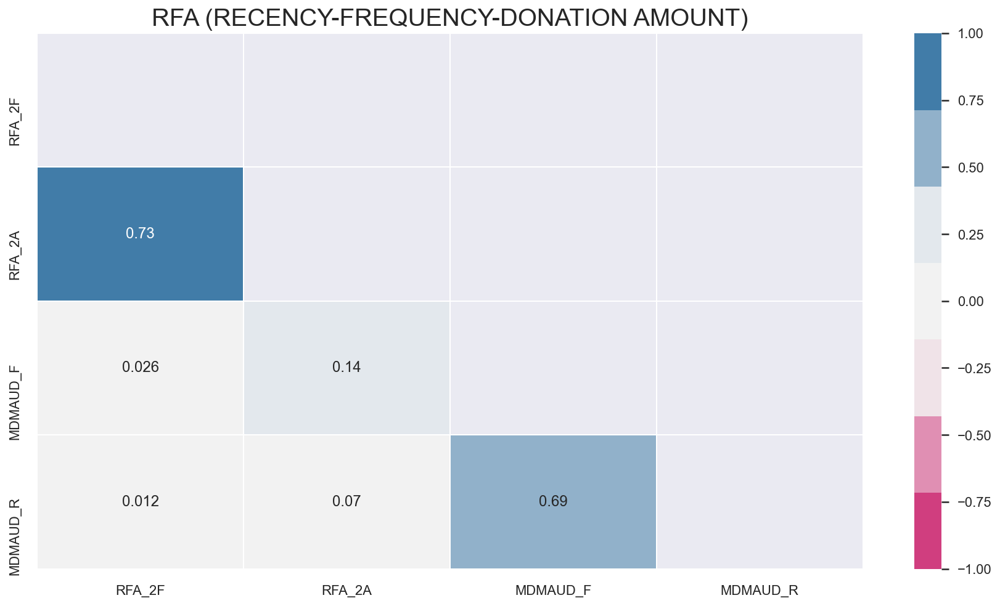

In [85]:
print_corr_matrix(dic['phi_k0'],group.loc[0,'Group'])
cluster_feat='RFA_2F,RFA_2A'

##### Features Taken: IC3, HHD2, ETHC3

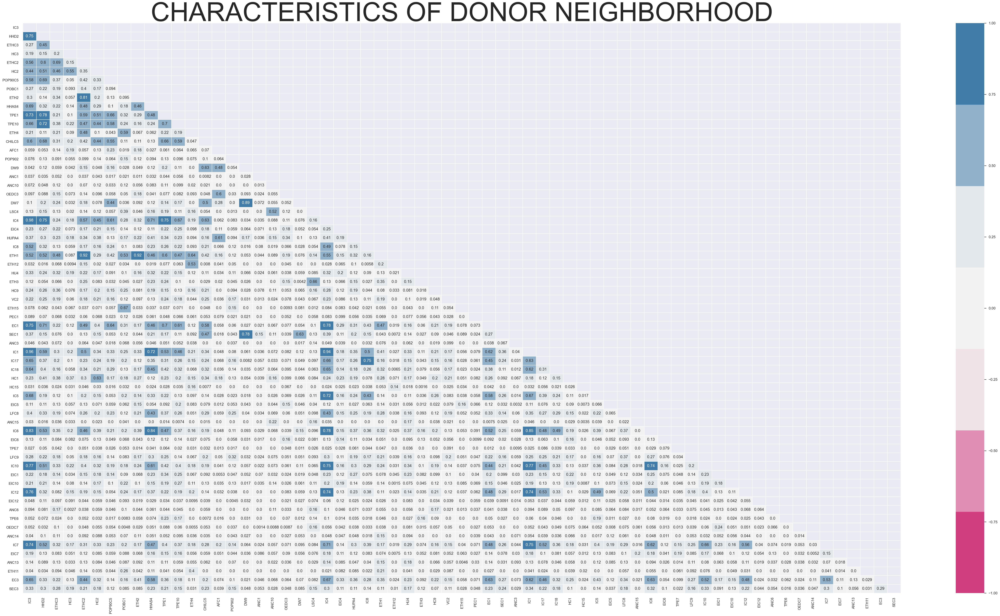

In [87]:
print_corr_matrix(dic['phi_k1'],group.loc[1,'Group'],4)
cluster_feat+=',IC3,HHD2,ETHC3'

##### Features Taken: INCOME, N_ODATEDW, NUMCHLD, AGE

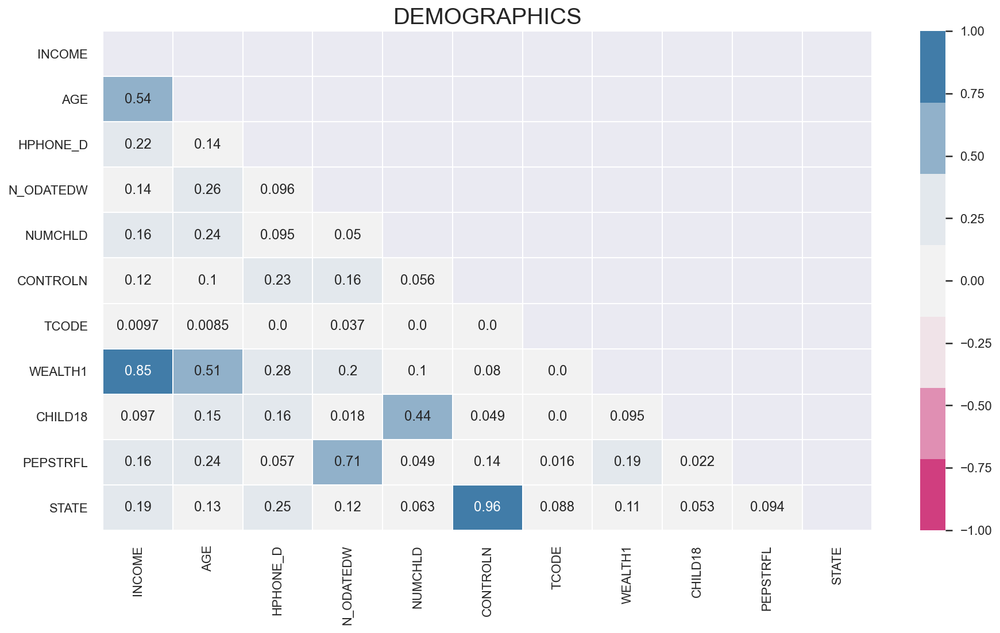

In [91]:
print_corr_matrix(dic['phi_k2'],group.loc[2,'Group'])
cluster_feat+=',INCOME,AGE,N_ODATEDW,NUMCHLD'

##### Features Taken: PETS

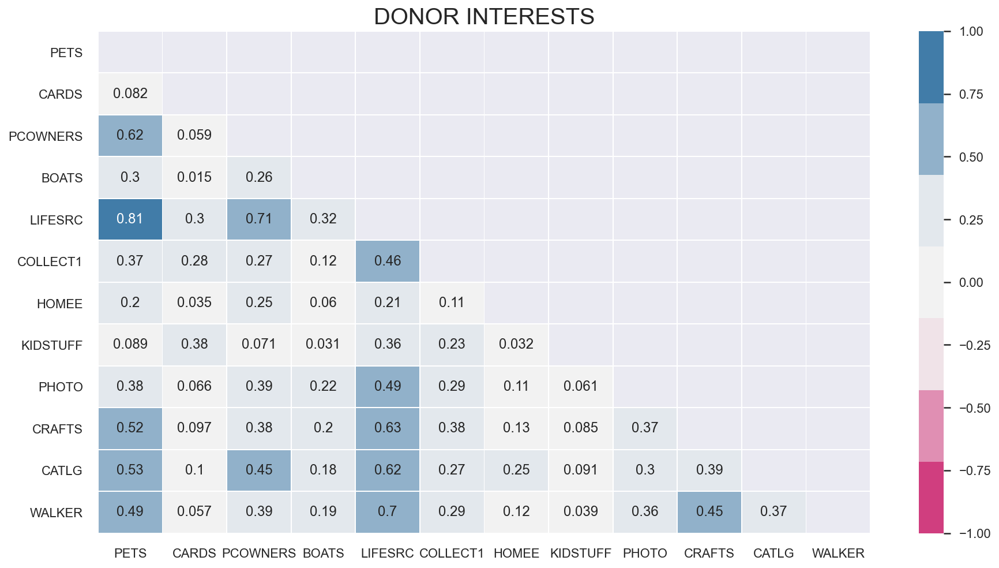

In [95]:
print_corr_matrix(dic['phi_k3'],group.loc[3,'Group'])
cluster_feat+=',PETS'

##### Features Taken: N_RDATE_7, RAMNT_7

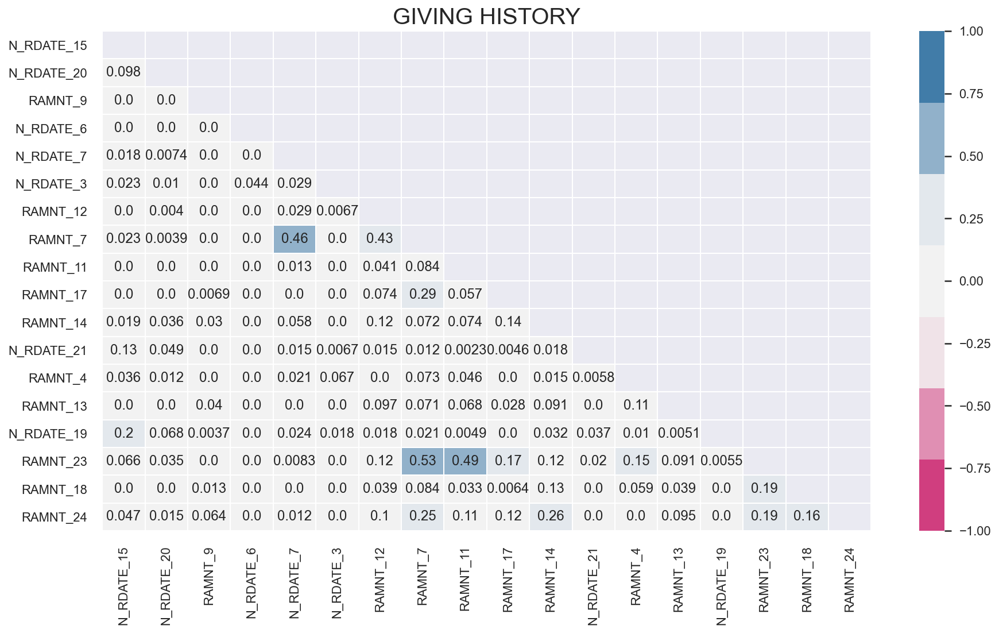

In [97]:
print_corr_matrix(dic['phi_k4'],group.loc[4,'Group'])
cluster_feat+=',N_RDATE_7,RAMNT_7'

##### Features Taken: FEDGOV, VIETVETS

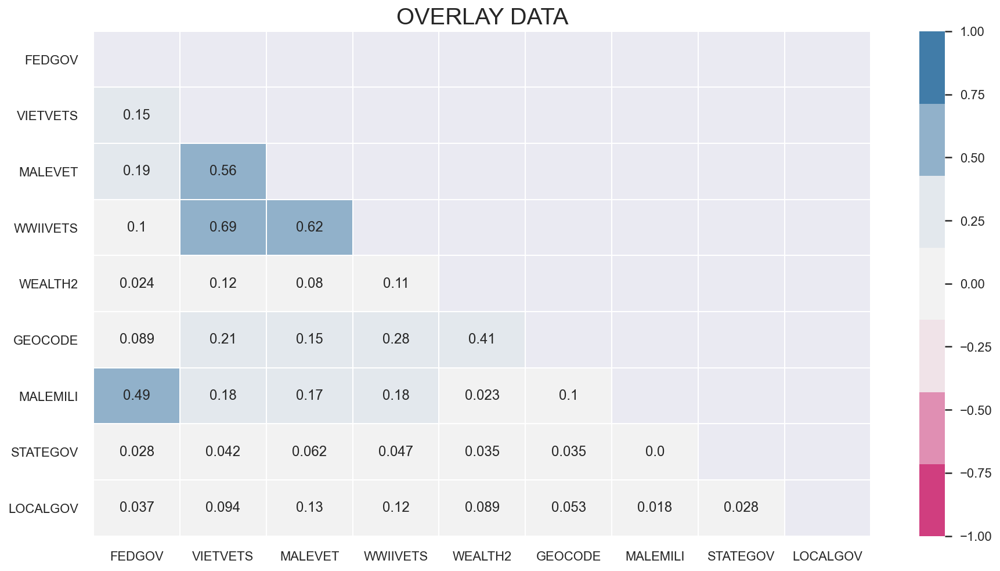

In [98]:
print_corr_matrix(dic['phi_k5'],group.loc[5,'Group'])
cluster_feat+=',FEDGOV,VIETVETS'

##### Features Taken: N_ADATE_7

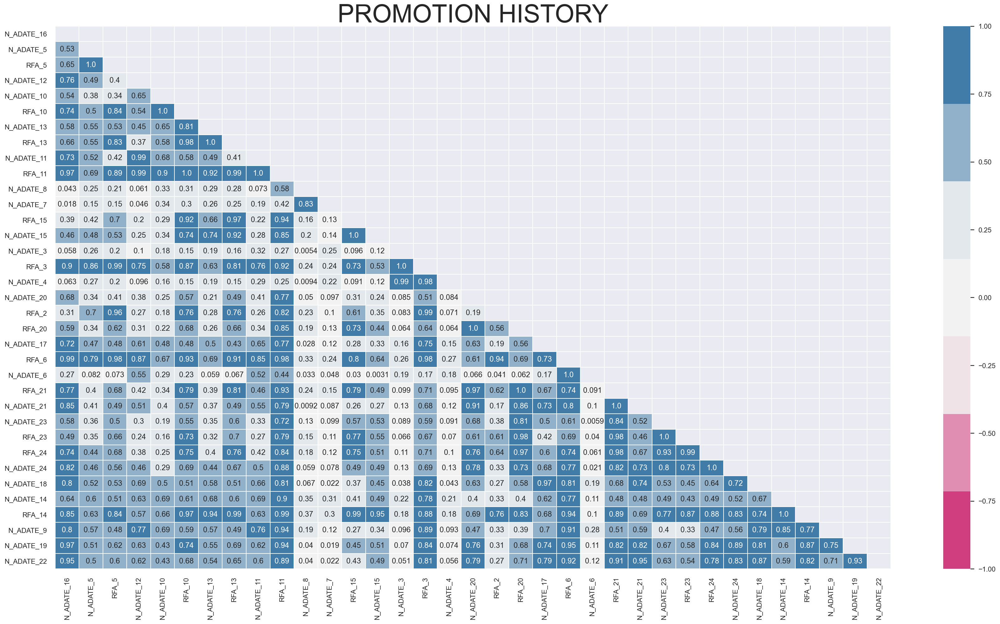

In [100]:
print_corr_matrix(dic['phi_k6'],group.loc[6,'Group'],2)
cluster_feat+=',N_ADATE_7'

##### Features Taken: MBBOOKS, MBGARDEN

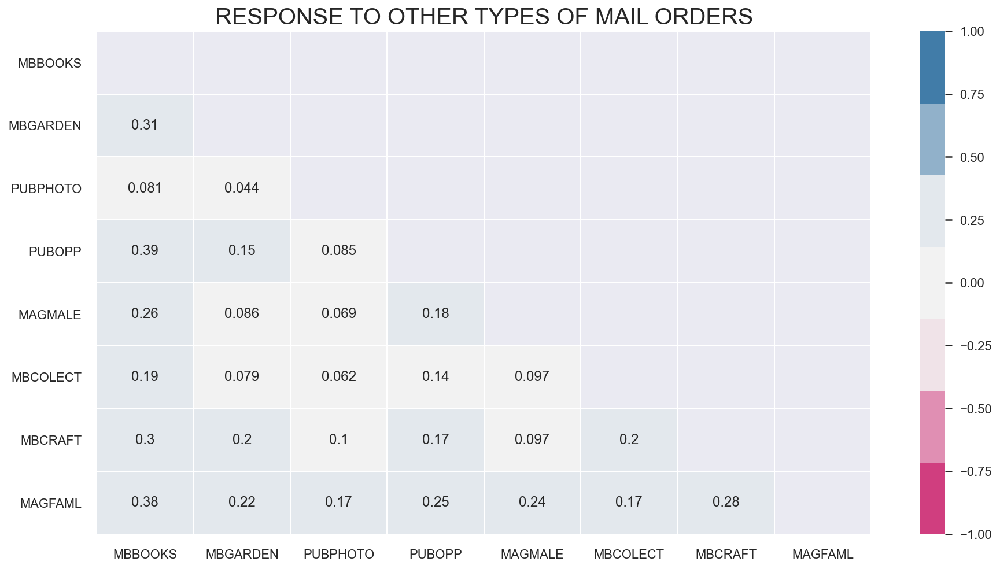

In [102]:
print_corr_matrix(dic['phi_k7'],group.loc[7,'Group'])
cluster_feat+=',MBBOOKS,MBGARDEN'

##### Features Taken: N_FISTDATE, MAXRAMNT, N_LASTDATE, N_MAXRDATE

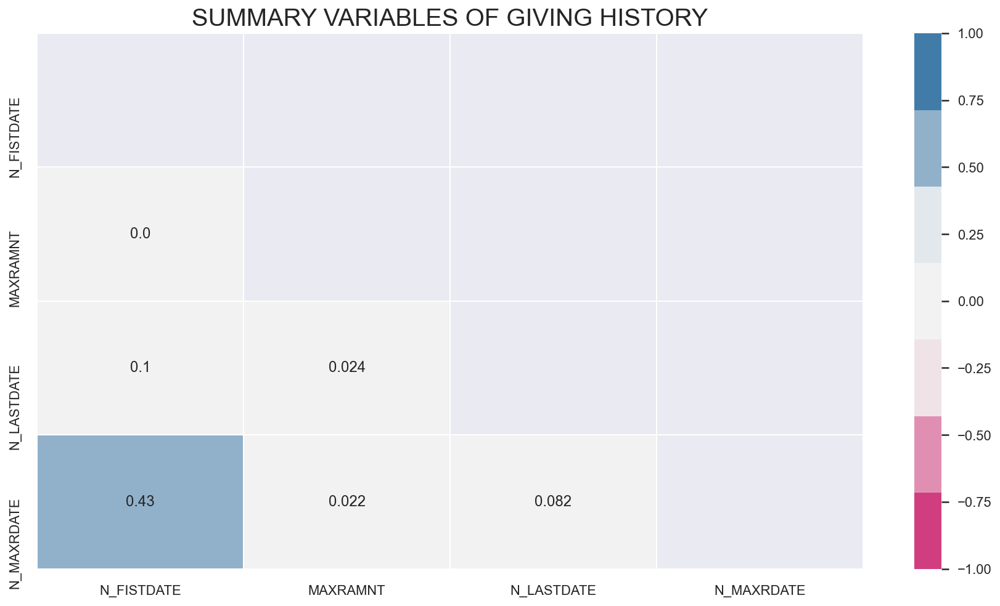

In [103]:
print_corr_matrix(dic['phi_k8'],group.loc[8,'Group'])
cluster_feat+=',N_FISTDATE,MAXRAMNT,N_LASTDATE,N_MAXRDATE'

##### Features Taken: CARDPROM

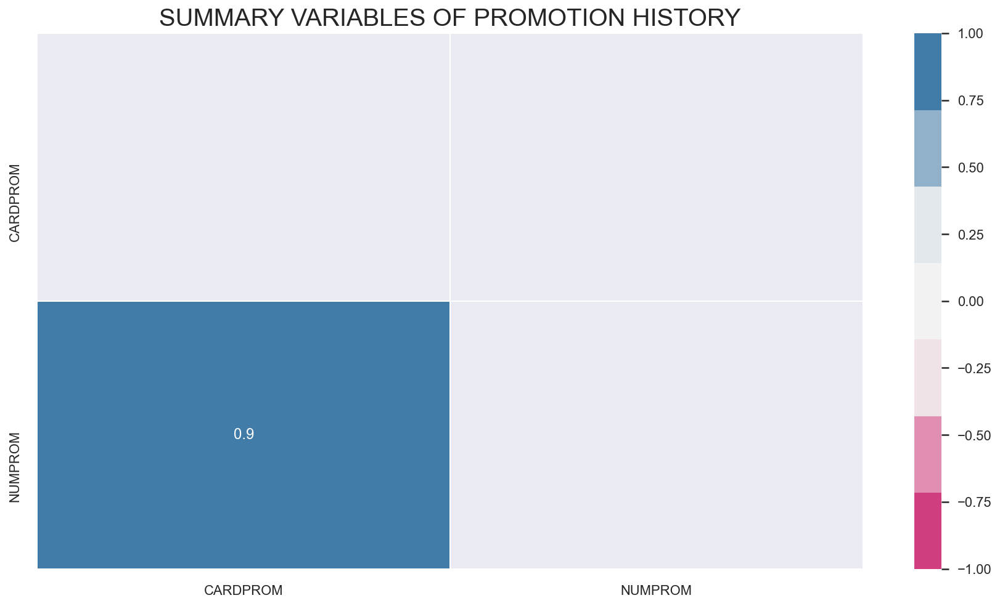

In [104]:
print_corr_matrix(dic['phi_k9'],group.loc[9,'Group'])
cluster_feat+=',CARDPROM'

# 5. Clustering

In [105]:
def plot_cluster_umap(embedding,labels,s,title='Cluster'):
    fig, ax = plt.subplots()
    fig.set_size_inches((20, 10))
    scatter = ax.scatter(embedding[:,0], embedding[:,1], s=s, c=labels, cmap='tab20b', alpha=1.0)
    #produce a legend with the unique colors from the scatter
    legend = ax.legend(*scatter.legend_elements(num=max(labels)+1), loc='lower left', title=title)
    ax.add_artist(legend)

In [106]:
def kelbowplots(model, df):
    """
    This function produces the k-elbow plot for a given clustering estimator according to 3 different clustering quality measures: Distortion, Silhouette and Calinski Harabasz.
    """
    fig, axes = plt.subplots(1,3,figsize=(40,14))
    metrics = ['distortion', 'silhouette', 'calinski_harabasz']
    ylabels = ['Distortion Measure', 'Silhouette Measure', 'Calinski Harabasz Measure']
    titles = ['Distortion Measure Plot', 'Silhouette Measure Plot', 'Calinski Harabasz Measure Plot']
    for ax, mtr, yl, tl in zip(axes.flatten(), metrics, ylabels, titles):
        #produce the elbow plot for several quality measures & fit the data to the visualizer
        KElbowVisualizer(model, metric=mtr, ax=ax, k=(2,20)).fit(df)
        ax.invert_xaxis()
        ax.set_ylabel(yl, fontsize=30)
        ax.set_xlabel('Number of clusters', fontsize=30)
        ax.set_title(tl, fontsize=30)
    #render the figure
    plt.suptitle('K-Elbow Plots', fontsize=40)
    plt.show()

In [108]:
# Create a dataframe with the selected features based on PCA & Phik correlation analysis
cluster_data=cleaned_data.loc[:,cluster_feat.split(',')]

## 5.1 K-Means

### 5.1.1 Kelbowplot Visualizer

In [109]:
# Get data for clustering
# Standardize input data because we want every one of them to have the same importance
kmeans_data=cluster_data.select_dtypes(include='number').copy()
for i in kmeans_data.columns.tolist():
    kmeans_data.loc[:,i]=PowerTransformer(method='yeo-johnson').fit_transform(np.array(kmeans_data[i]).reshape(-1, 1))

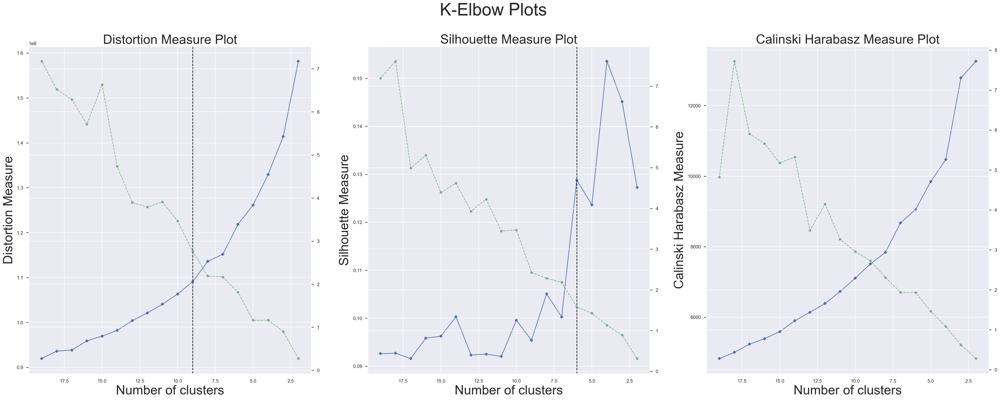

In [116]:
# Call function passing kmeans as object for initalization & display elbow plot
kelbowplots(KMeans(random_state=random_state), kmeans_data)

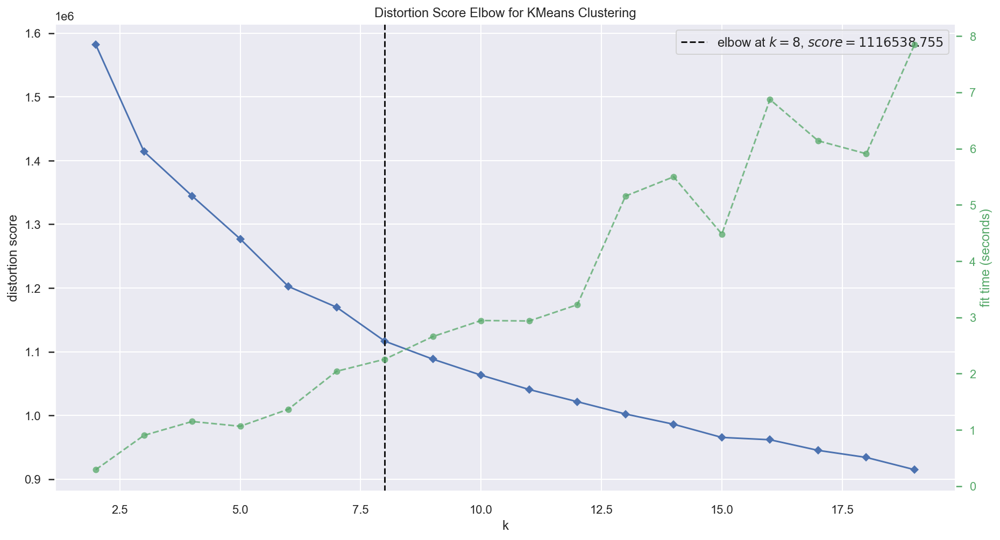

In [117]:
# Using the quick method and immediately show the figure
kelbow_visualizer(KMeans(random_state=random_state), kmeans_data, k=(2,20))
plt.show()

### 5.1.2 Silohuette Visualizer

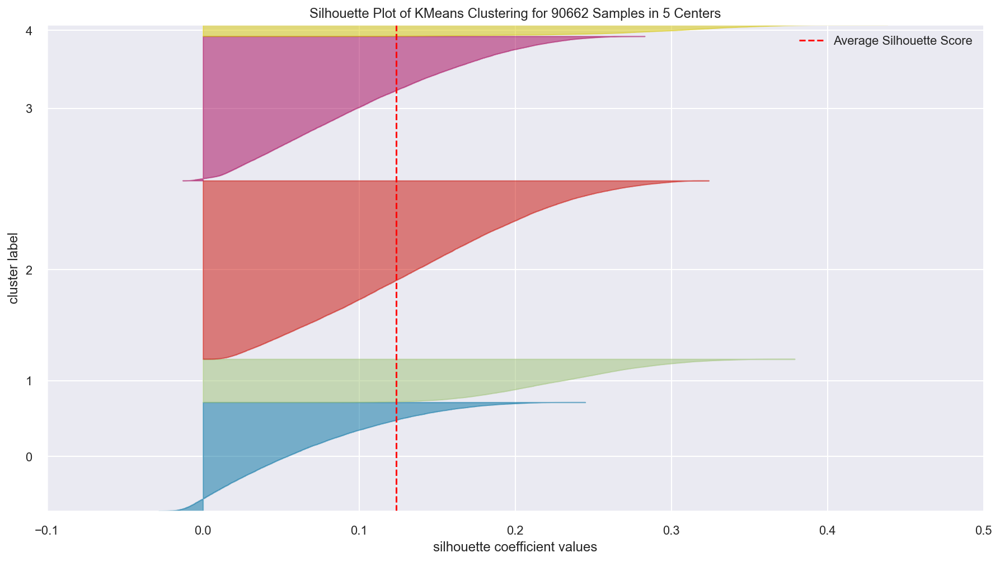

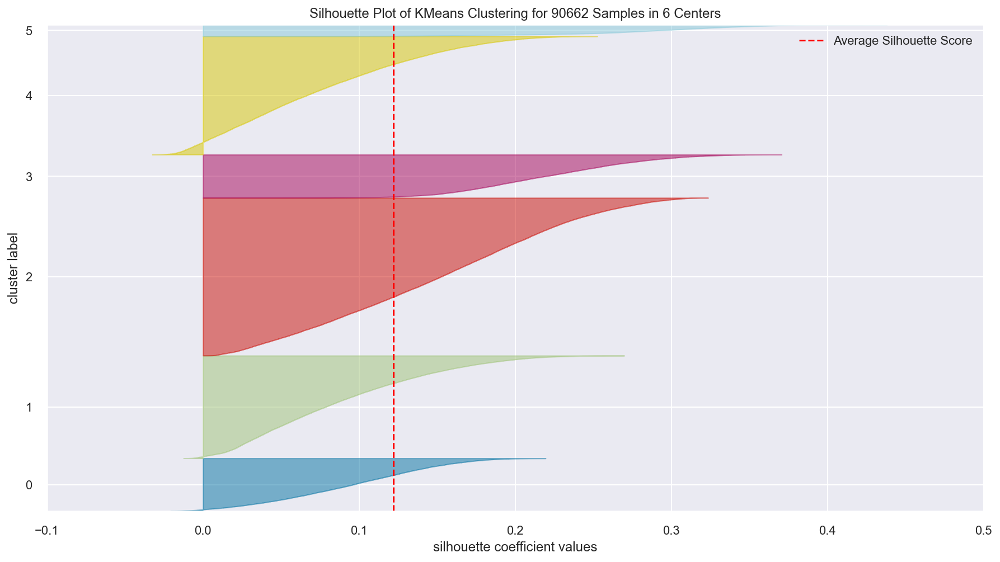

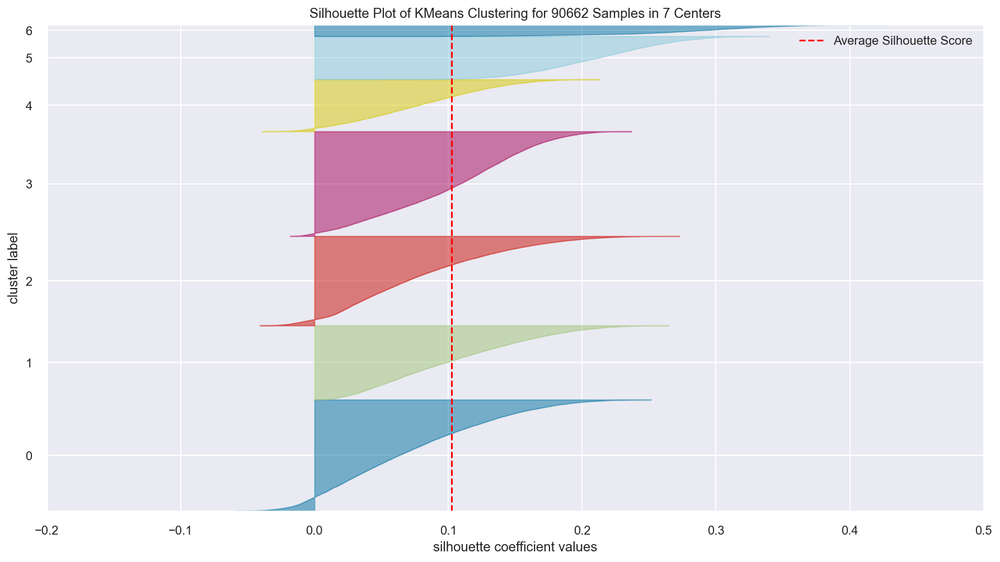

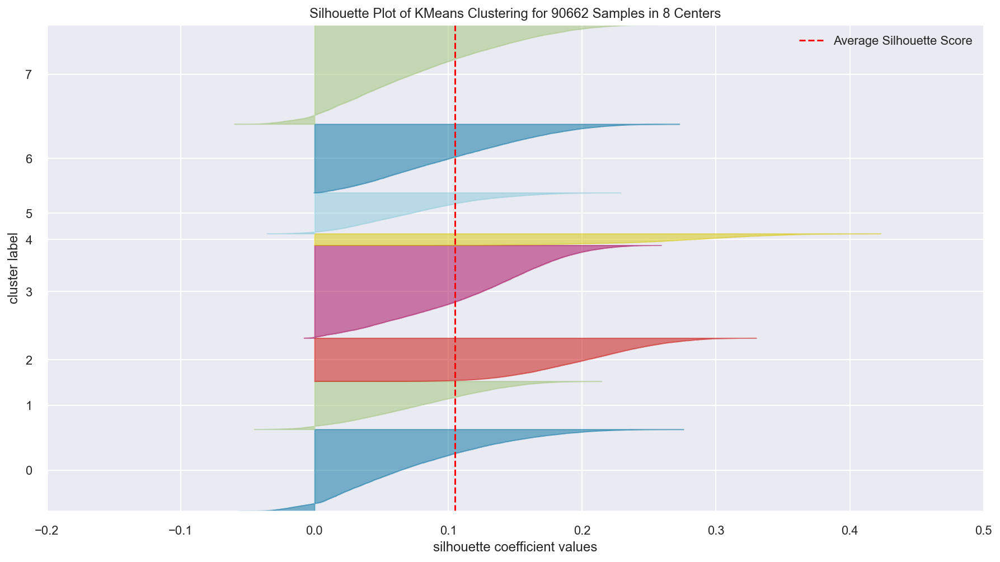

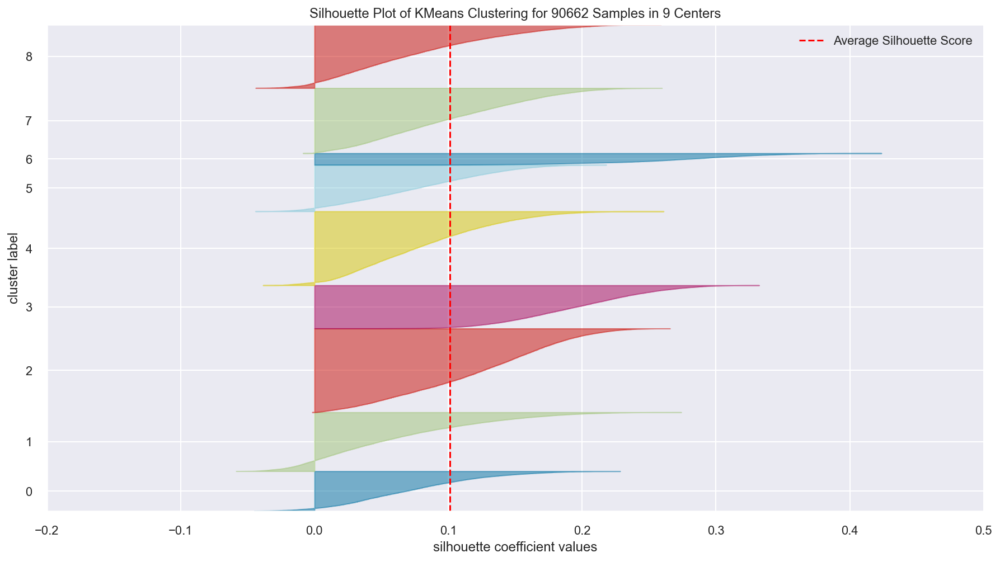

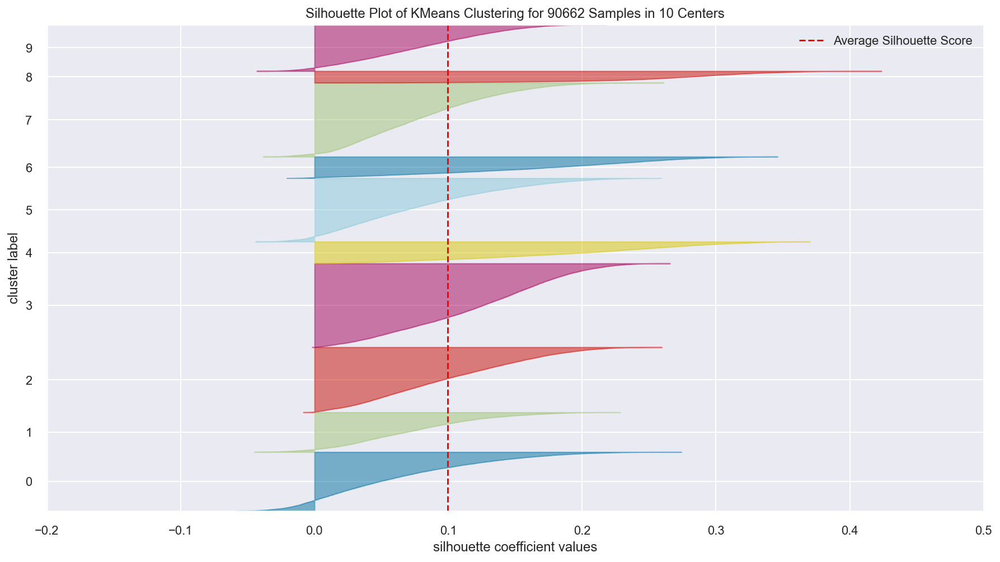

In [118]:
# Using the quick method and immediately show the figure
for i in range(5,11):
    silhouette_visualizer(KMeans(i,random_state=random_state), kmeans_data, colors='yellowbrick')
    plt.show()

### 5.1.3 KMeans

In [119]:
# K-means for metric features
kmeans=KMeans(n_clusters=8, init='k-means++', max_iter=1000, tol=0.0001).fit(kmeans_data)
kmeans_labels=kmeans.labels_

In [120]:
# Count of row observations per cluster
kmeans_summary=pd.DataFrame(pd.Series(kmeans_labels).value_counts().sort_index(axis=0),columns=['Observations'])
kmeans_summary.index.name='Cluster'
kmeans_summary

,Observations
Cluster,
0,8053
1,13230
2,15305
3,18086
4,7522
5,8820
6,2161
7,17485


In [217]:
# Characterizing the final clusters
df_concat=cluster_data.copy()
df_concat['Cluster'] = kmeans_labels
df_concat.groupby('Cluster').mean().T

Cluster,0,1,2,3,4,5,6,7
RFA_2F,2.363964,1.816478,2.682457,1.757381,1.861473,1.809864,1.900046,1.180040
IC3,378.654539,515.369690,343.830774,328.276623,387.808562,417.083333,372.906525,388.383929
HHD2,71.783186,81.484958,69.322313,65.459306,71.881415,76.539229,73.445627,71.424650
ETHC3,17.048553,10.378005,20.428814,19.389307,17.392316,13.535147,17.728829,18.159794
INCOME,3.780330,4.861376,3.151454,3.513989,3.841797,4.646712,3.676076,3.926108
AGE,59.247734,53.346334,66.898661,57.679752,59.506514,47.905669,61.849607,62.130226
N_ODATEDW,112.115237,89.684958,150.471480,76.244830,112.042675,103.996939,125.219806,149.168544
NUMCHLD,0.192972,0.000151,0.039660,0.010118,0.168040,1.548413,0.257288,0.024650
N_RDATE_7,58.100211,612.000000,612.000000,612.000000,612.000000,612.000000,557.402129,612.000000
RAMNT_7,15.528080,0.000000,0.000000,0.000000,0.000000,0.000000,1.465988,0.000000


In [122]:
# Performing inertia to validate the previous number of clusters
sse={}
for k in tqdm(range(2, 20)):
    kmeans_i=KMeans(n_clusters=k, max_iter=1000).fit(kmeans_data)
    sse[k]=kmeans_i.inertia_#inertia: sum of distances of samples to their closest cluster center
# Plot inertia using plotly library
fig=go.Figure(data=go.Scatter(x=list(sse.keys()), y=list(sse.values())))
fig.show()

100%|██████████| 18/18 [01:02<00:00,  3.49s/it]


### 5.1.4 UMAP for Kmeans

In [123]:
#embedding_kmeans=apply_umap(kmeans_data)
fit1_ = umap.UMAP(metric='l2').fit(kmeans_data)
embedding_kmeans = umap.umap_.simplicial_set_embedding(fit1_._raw_data,fit1_.graph_,fit1_.n_components, 
                                                fit1_._initial_alpha, fit1_._a, fit1_._b, 
                                                fit1_.repulsion_strength, fit1_.negative_sample_rate, 
                                                200, 'random', np.random, fit1_.metric, 
                                                fit1_._metric_kwds, False)

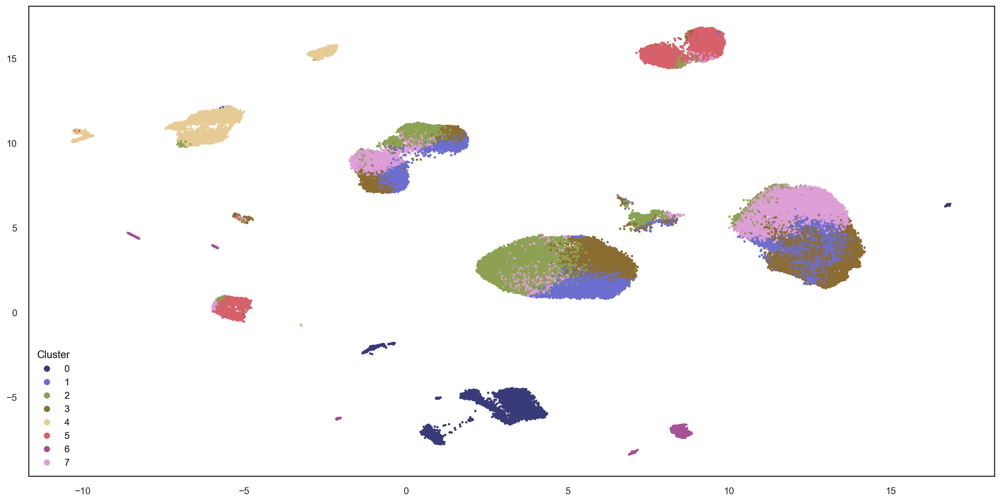

In [124]:
sns.set_style('white')
plot_cluster_umap(embedding_kmeans,kmeans_labels,3,'Cluster')

### Another way to look into the K-Means Clusters

In [125]:
def plot_clusters(data, algorithm, args, kwds):
    labels = algorithm(*args, **kwds).fit_predict(data)
    palette = sns.color_palette('deep',np.unique(labels).max()+1)
    colors = [palette[i] if i>= 0 else (0.0, 0.0, 0.0) for i in labels]
    plt_kwds={'alpha':0.25,'s':2,'linewidths':0}
    plt.scatter(data.T[0], data.T[1], c=colors, **plt_kwds)
    frame=plt.gca()
    frame.axes.get_xaxis().set_visible(False)
    frame.axes.get_yaxis().set_visible(False)
    plt.title('Clusters found by {}'.format(str(algorithm.__name__)), fontsize=20)

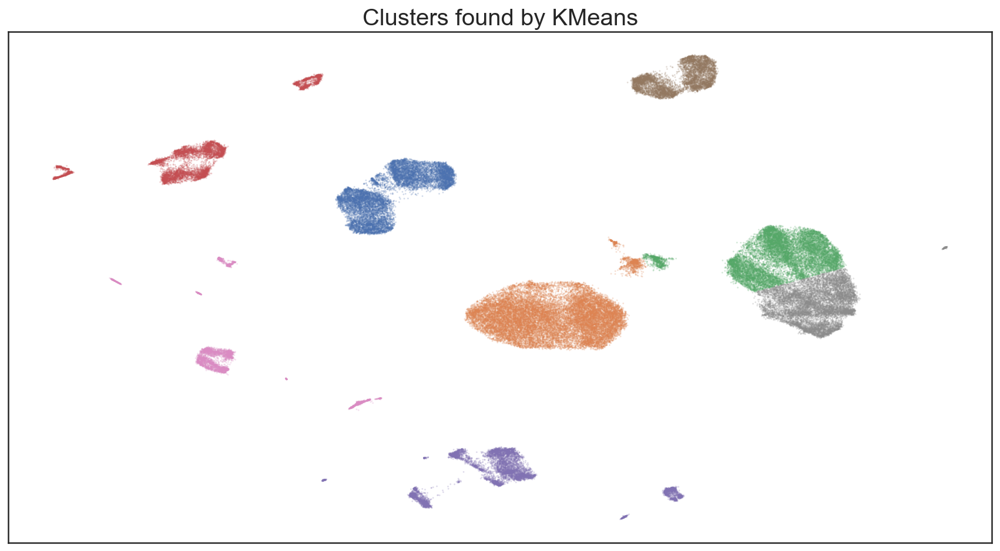

In [126]:
plot_clusters(embedding_kmeans, KMeans, (), {'n_clusters':8})

From the graph above we can conclude that the 8 clusters are clearly distinguishable by using the "deep" color palette

### 5.1.5 Intercluster Distance for K-Means

Intercluster distance maps display an embedding of the cluster centers in 2 dimensions with the distance to other centers preserved, the closer to centers are in the visualization, the closer they are in the original feature space. 
The clusters are sized according to a scoring metric this gives a sense of the relative importance of clusters however, that because two clusters overlap in the 2D space, it does not imply that they overlap in the original feature space

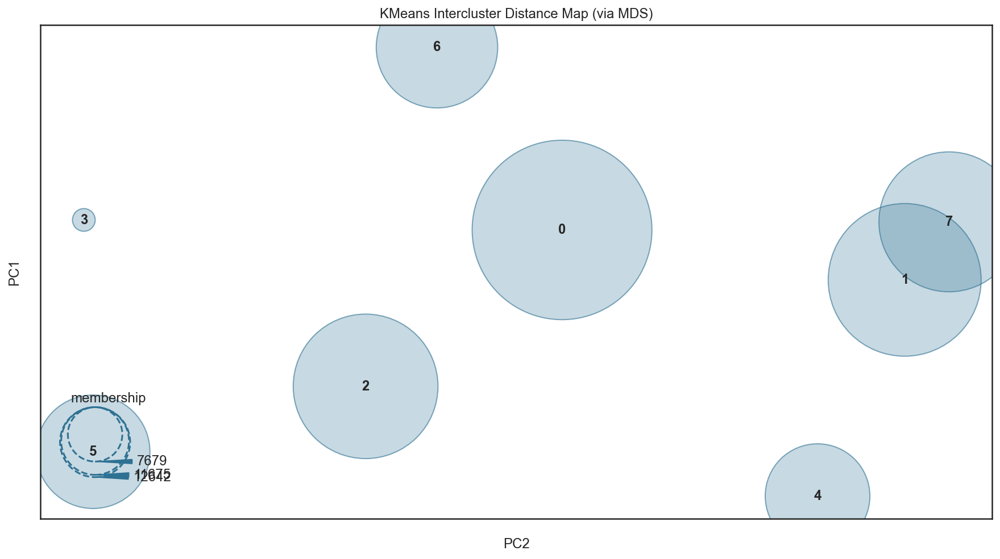

In [127]:
#Instantiate the clustering model and visualizer
view=InterclusterDistance(KMeans(8,random_state=4))
#Fit the data to the visualizer
view.fit(embedding_kmeans)
#Render the figure
view.show()        
plt.show()

## 5.2 K-Prototypes

### 5.2.1 Clustering

In [128]:
kproto_data = cluster_data.copy()
for i in kproto_data.select_dtypes(include='number').columns.tolist():
    kproto_data[i] = PowerTransformer(method='yeo-johnson').fit_transform(np.array(kproto_data[i]).reshape(-1, 1))

In [129]:
kproto=KPrototypes(n_clusters=8, init='Cao', n_jobs=4)

In [130]:
kproto_categorical=[]
for i,j in enumerate(kproto_data.columns):
    if j in list(kproto_data.select_dtypes(include='object').columns):
        kproto_categorical.append(i)

In [131]:
kproto_labels=kproto.fit_predict(kproto_data, categorical=kproto_categorical)

In [133]:
#Count of row observations per cluster
kproto_summary=pd.DataFrame(pd.Series(kproto_labels).value_counts().sort_index(axis=0),columns=['Observations'])
kproto_summary.index.name='Cluster'
kproto_summary

,Observations
Cluster,
0,8825
1,8053
2,13255
3,2161
4,14917
5,18139
6,17835
7,7477


In [218]:
# Characterizing the final clusters
df_concat=cluster_data.copy()
df_concat['Cluster'] = kproto_labels
df_concat.groupby('Cluster').mean().T

Cluster,0,1,2,3,4,5,6,7
RFA_2F,1.805666,2.363964,1.791173,1.900046,2.731045,1.764155,1.188842,1.852347
IC3,416.953881,378.654539,517.811166,372.906525,346.126902,328.511329,383.329016,388.207302
HHD2,76.539717,71.783186,81.539419,73.445627,69.735671,65.558465,70.889263,71.895011
ETHC3,13.540170,17.048553,10.351943,17.728829,20.115171,19.360880,18.537987,17.358700
INCOME,4.646459,3.780330,4.874312,3.676076,3.174834,3.518055,3.872049,3.850207
AGE,47.927139,59.247734,53.408223,61.849607,66.700677,57.634765,62.450687,59.413267
N_ODATEDW,104.000567,112.115237,90.361373,125.219806,150.570825,76.221898,149.026521,111.625652
NUMCHLD,1.547422,0.192972,0.000151,0.257288,0.042636,0.009868,0.022652,0.169453
N_RDATE_7,612.000000,58.100211,612.000000,557.402129,612.000000,612.000000,612.000000,612.000000
RAMNT_7,0.000000,15.528080,0.000000,1.465988,0.000000,0.000000,0.000000,0.000000


### 5.2.2 UMAP for K-Prototypes

In [134]:
#Call UMAP to plot K-Prototypes Clustering
embedding_kproto=apply_umap(kproto_data)

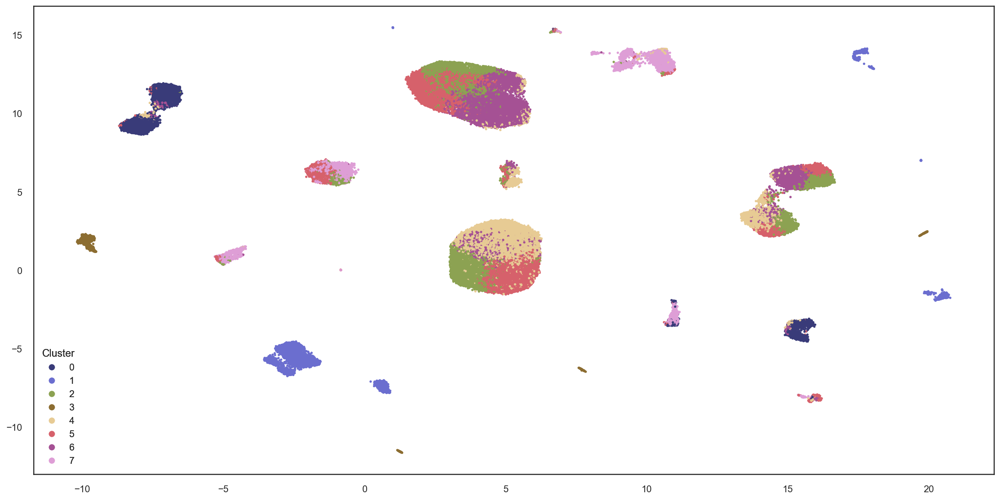

In [135]:
plot_cluster_umap(embedding_kproto,kproto_labels,3,'Cluster')

### 5.2.3 Intercluster Distance for K-Prototypes

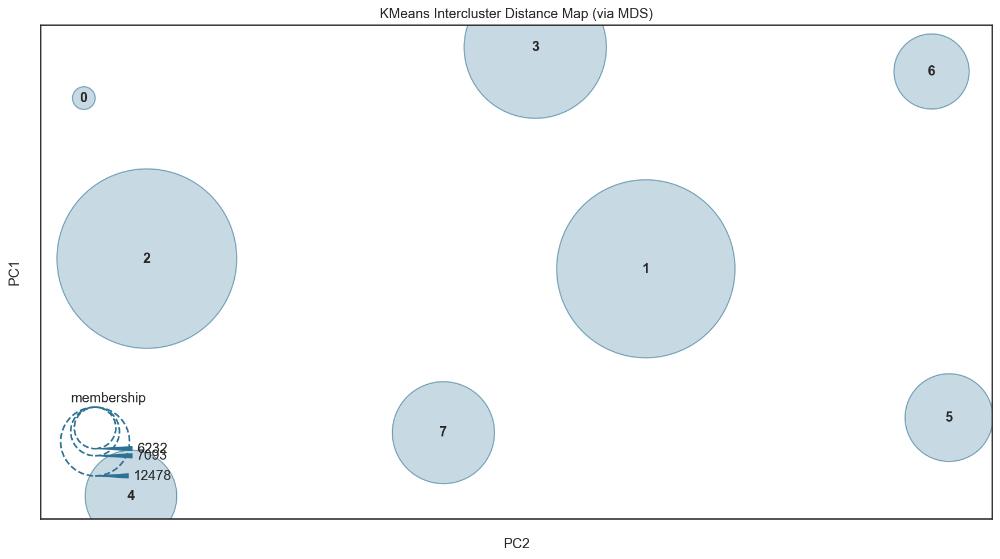

In [136]:
#Instantiate the clustering model and visualizer
view=InterclusterDistance(KMeans(8,random_state=4))
#Fit the data to the visualizer
view.fit(embedding_kproto)
#Render the figure
view.show()        
plt.show()

## 5.3 Evaluation by Classification using LGBM

Validating the quality of clusters by treating them as labels and building a classification model on top. If the clusters are of high quality, the classification model will be able to predict them with high accuracy. At the same time, the models should use a variety of features to ensure that the clusters are not too simplistic.
- Distinctivness of clusters by cross-validated F1 score
- Informativness of clusters by SHAP feature importances

LightGBM will be used as classifier as it can use categorical features

### 5.3.1 K-Means

In [137]:
#Set LGBM Dataframe
lgbm_data=cluster_data.copy()
for i in lgbm_data.select_dtypes(include='object'):
    lgbm_data[i]=lgbm_data[i].astype('category')

In [138]:
#Kmeans Clusters
clf_km=LGBMClassifier(colsample_by_tree=0.8)
cv_scores_km=cross_val_score(clf_km, lgbm_data, kmeans_labels, scoring='f1_weighted')
print(f'CV F1 score for K-Means clusters is {np.mean(cv_scores_km)}')

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
CV F1 score for K-Means clusters is 0.9738166796974144


In [139]:
clf_km.fit(lgbm_data, kmeans_labels)
explainer_km=shap.TreeExplainer(clf_km)
shap_values_km=explainer_km.shap_values(lgbm_data)

[LightGBM] [Warning] Unknown parameter: colsample_by_tree


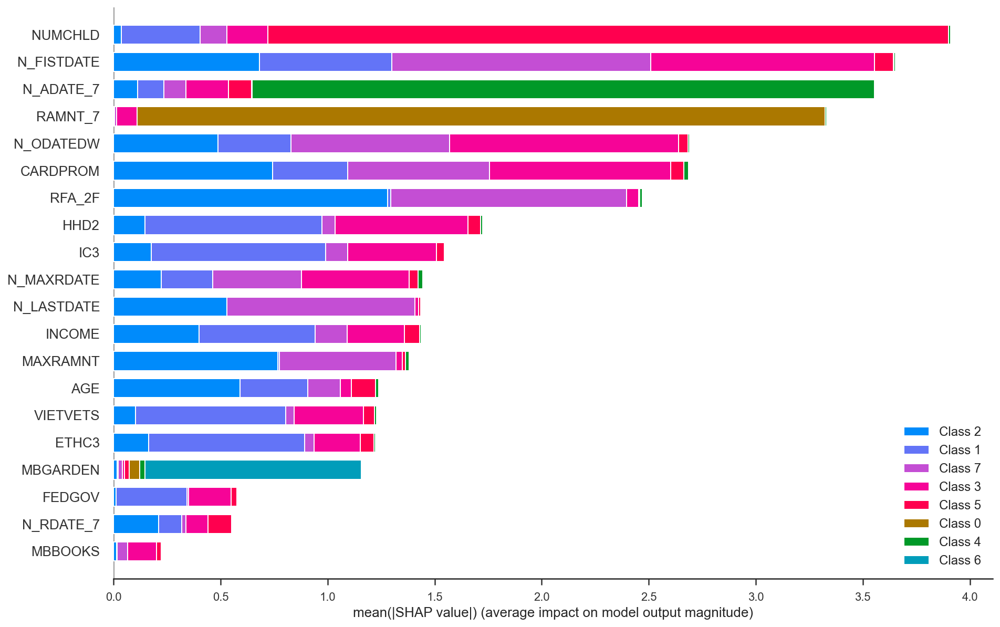

In [140]:
shap.summary_plot(shap_values_km, lgbm_data, plot_type='bar', plot_size=(15, 10))

### 5.3.2 K-Prototypes

In [141]:
clf_kp = LGBMClassifier(colsample_by_tree=0.8)
cv_scores_kp = cross_val_score(clf_kp, lgbm_data, kproto_labels, scoring='f1_weighted')
print(f'CV F1 score for K-Prototypes clusters is {np.mean(cv_scores_kp)}')

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
CV F1 score for K-Prototypes clusters is 0.9737783305848711


In [142]:
clf_kp.fit(lgbm_data, kproto_labels)
explainer_kp = shap.TreeExplainer(clf_kp)
shap_values_kp = explainer_kp.shap_values(lgbm_data)

[LightGBM] [Warning] Unknown parameter: colsample_by_tree


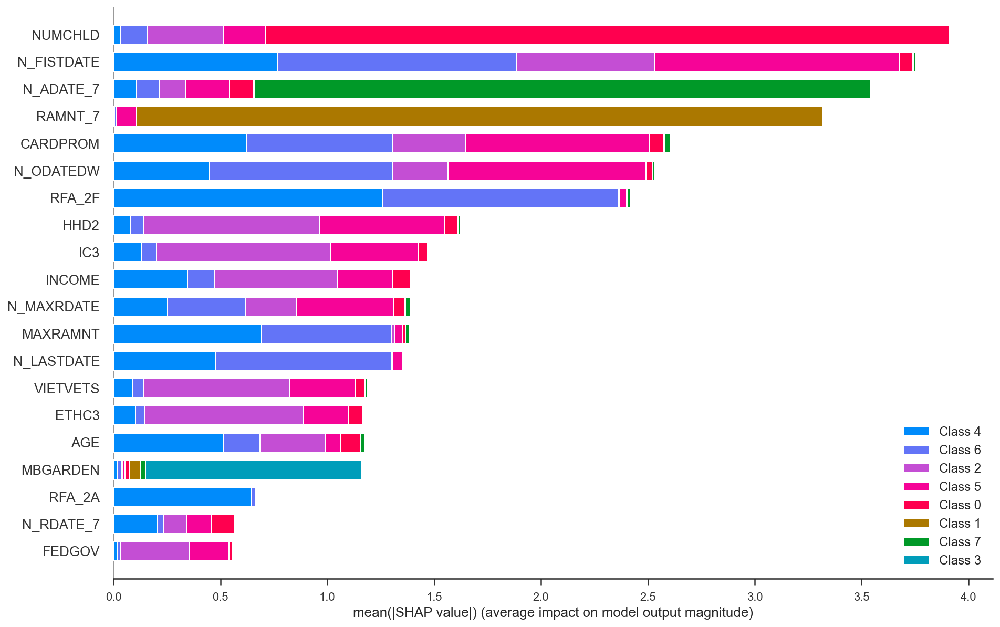

In [143]:
shap.summary_plot(shap_values_kp, lgbm_data, plot_type='bar', plot_size=(15, 10))

Classifiers for both of the clustering methods have F1 score close to 1 which means that K-Means and K-prototypes have produced clusters that are easily distinguishable. Yet, to classify the K-Prototypes correctly, LightGBM uses more features, and some of the categorical features become important. This is in contrast to K-Means which could have been almost perfectly classified using just 15-18 features. This proves that the clusters produced by K-Prototypes are more informative.

## 5.4 K-Means & Hierarchical Clustering

### 5.4.1 Encondig Categorical Features

We have only 2 categorical features with limited data values (4 and 2), so we can do encoding here to further utilization of the full list of features upfront

In [144]:
cluster_data_enc=cluster_data.copy()
# columns for categorical features
{item: cluster_data_enc[item].unique() for item in cluster_data_enc if (cluster_data_enc[item].dtype=='object') }

{'RFA_2A': array(['E', 'G', 'F', 'D'], dtype=object),
 'PETS': array([' ', 'Y'], dtype=object)}

In [145]:
exch_dict = {'RFA_2A': {'D': '1', 'E': '2', 'F': '3', 'G': '4'},'PETS': {' ': '0', 'Y': '1'}}

In [146]:
for item in exch_dict.keys():
        exch_map = exch_dict[item]
        cluster_data_enc[item] = cluster_data_enc[item].map(exch_map)
        cluster_data_enc[item]  = cluster_data_enc[item].astype('int64', copy=False)

### 5.4.2 Clustering and Functions Definition 

In [147]:
def get_r2_hc(df, link, max_nclus, min_nclus=1, dist='euclidean'):   
    def get_ss(matrix):
        mc = matrix - matrix.mean(axis=0)
        return (mc.T@mc).trace() #return sum of squares of matrix
    
    matrix = df.values
    ncols = matrix.shape[1]
    sst = get_ss(matrix) #get total sum of squares
    r2 = np.array([]) #where we will store the R2 metrics   
    for i in range(min_nclus, max_nclus+1):
        Hclustering = AgglomerativeClustering(n_clusters=i, affinity=dist, linkage=link)
        hclabels = Hclustering.fit_predict(matrix) #get cluster labels
        concat = np.concatenate((matrix, np.expand_dims(hclabels,1)), axis=1)
        ssw = np.array([get_ss(concat[concat[:,ncols]==j, :ncols]) for j in range(i)]).sum() #calculate ssw for a given cluster solution
        r2 = np.append(r2, (sst-ssw)/sst) #save the R2 of the given cluster solution
    return r2

In [148]:
def plot_r2_hc(df, labels):
    #Getting the centroids of each cluster given by the K-means
    df_clusters = df.groupby(labels).mean()

    #Prepare input
    hc_methods = ['ward', 'complete', 'average', 'single']
    # Function defined above to obtain the R2 statistic
    r2_hc_methods = pd.DataFrame(data=np.concatenate([np.expand_dims(get_r2_hc(df=df_clusters, link=i, max_nclus=10), 1) for i in hc_methods], axis=1),
                                 index=range(1,10+1), columns=hc_methods)

    #Plot data
    sns.set()
    fig = plt.figure(figsize=(15,7))
    sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=['o']*4)

    #Finalize the plot
    fig.suptitle('R2 plot for various hierarchical methods', fontsize=23)
    plt.gca().invert_xaxis()
    plt.legend(title='HC methods', title_fontsize=13)
    plt.xlabel('Number of clusters', fontsize=13)
    plt.ylabel('R2', fontsize=13)
    plt.show()

In [149]:
def plot_hc_dendogram(df, HCM):
    #Hierarchical clustering assessment using scipy
    z = linkage(df, method=HCM)
    fig = plt.figure(figsize=(22,10))
    #Set Dendrogram
    set_link_color_palette(list(sns.color_palette().as_hex()))
    dendrogram(z, color_threshold=8, truncate_mode='level', orientation='top', no_labels=True, above_threshold_color='k')
    #Plot Dendrogram
    plt.hlines(9.5, 0, 1000, colors='r', linestyles='dashed')
    plt.title('Hierarchical Clustering - Ward\'s Dendrogram', fontsize=40)
    plt.xlabel('K-means Units', fontsize=13)
    plt.ylabel('Euclidean Distance', fontsize=13)
    plt.show()

In [150]:
model = KMeans(100,random_state=4)
model.fit(kmeans_data)
clust_labels = model.predict(kmeans_data)   
kmeans_clusters = kmeans_data.copy()
kmeans_clusters['kmeans_labels'] = clust_labels

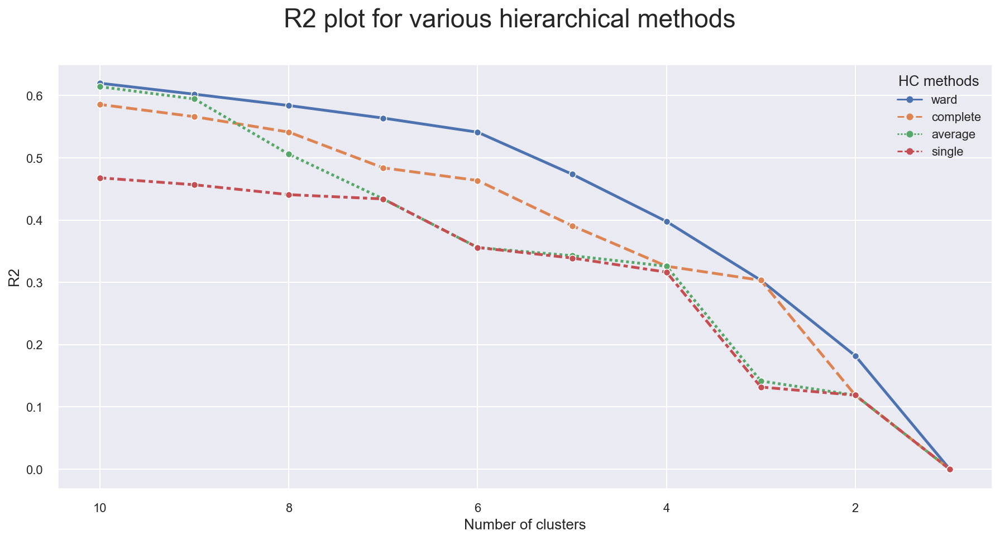

In [151]:
plot_r2_hc(kmeans_clusters,'kmeans_labels')

From the graph above R2 for hierarchical clustering we can conclude that the best HCM method is ward hence this will be taken for the upcoming analysis

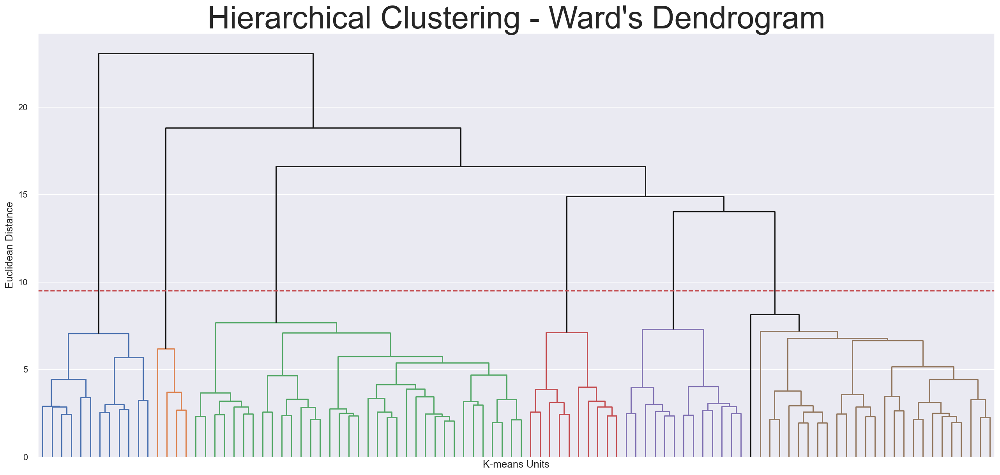

In [152]:
#updating the centroids of kmeans cluster given by the mean
kmeans_clusters = kmeans_clusters.groupby('kmeans_labels').mean()
plot_hc_dendogram(kmeans_clusters,'ward')

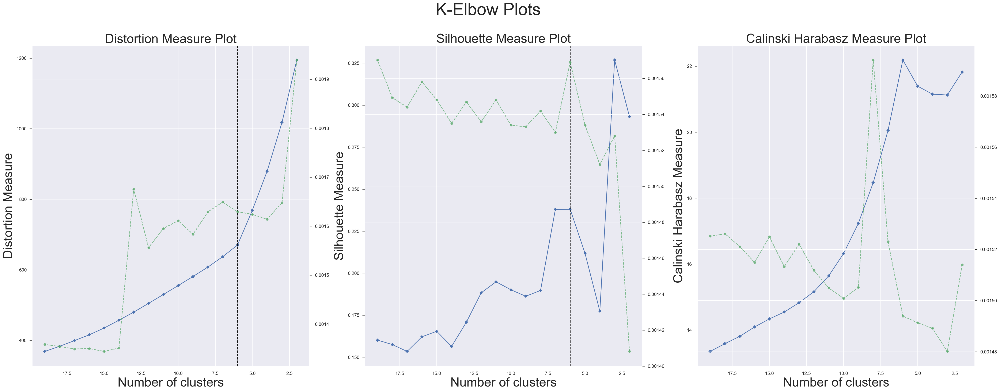

In [153]:
#Hierarchical clustering with sklearn and selected linkage and n_cluster according to plot above and below
Hclustering = AgglomerativeClustering(linkage='ward')
#K-Elbow Plots
kelbowplots(Hclustering, kmeans_clusters)

For n_clusters = 2, the average silhouette_score is : 0.12725164424128024
For n_clusters = 3, the average silhouette_score is : 0.1451332518699581
For n_clusters = 4, the average silhouette_score is : 0.14702776965334657
For n_clusters = 5, the average silhouette_score is : 0.12591907333505317
For n_clusters = 6, the average silhouette_score is : 0.11195789341728894
For n_clusters = 7, the average silhouette_score is : 0.10231748054830442
For n_clusters = 8, the average silhouette_score is : 0.10525856208877543
For n_clusters = 9, the average silhouette_score is : 0.10109064917279584
For n_clusters = 10, the average silhouette_score is : 0.09961330996471655


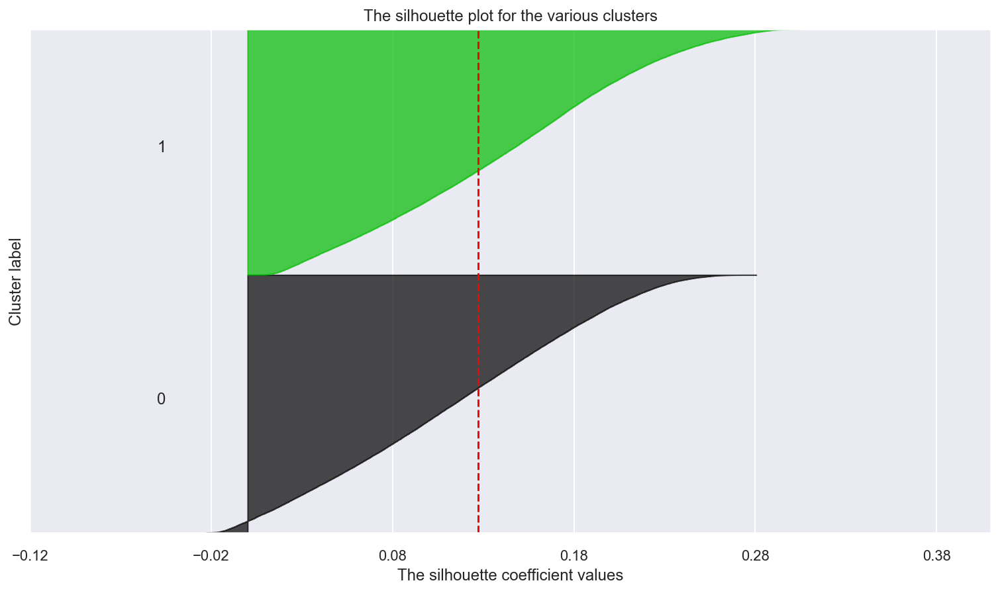

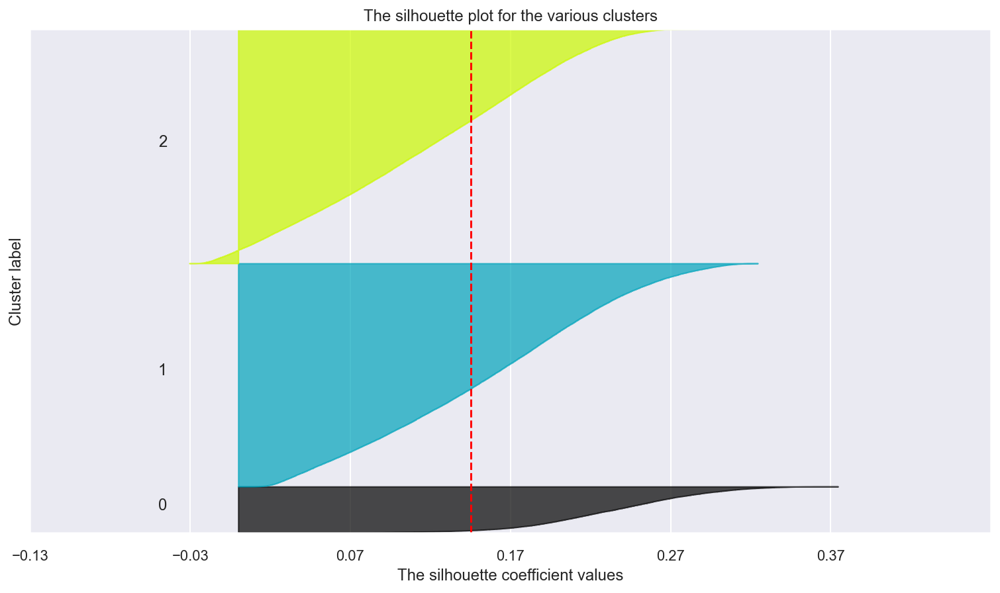

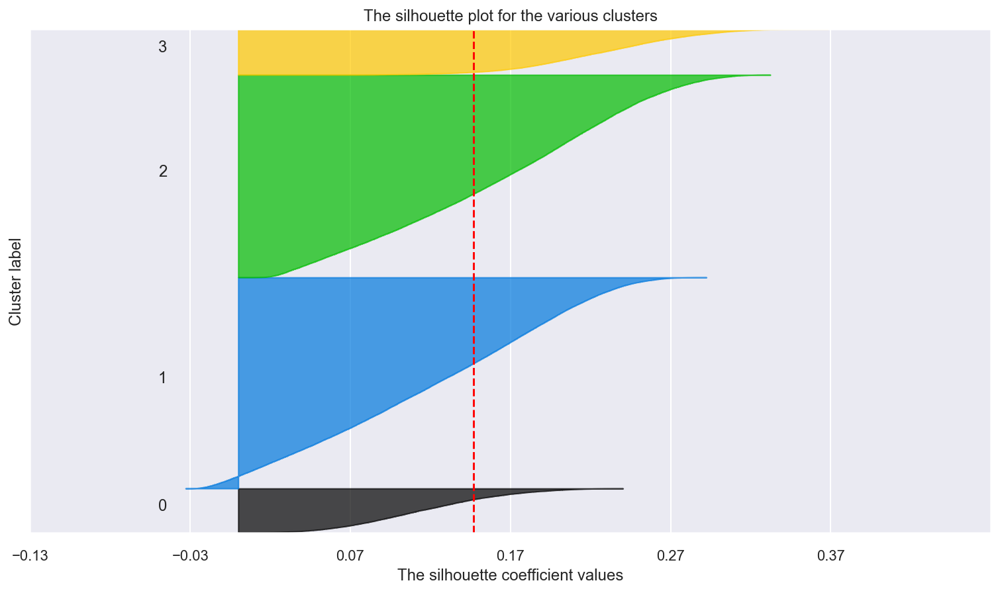

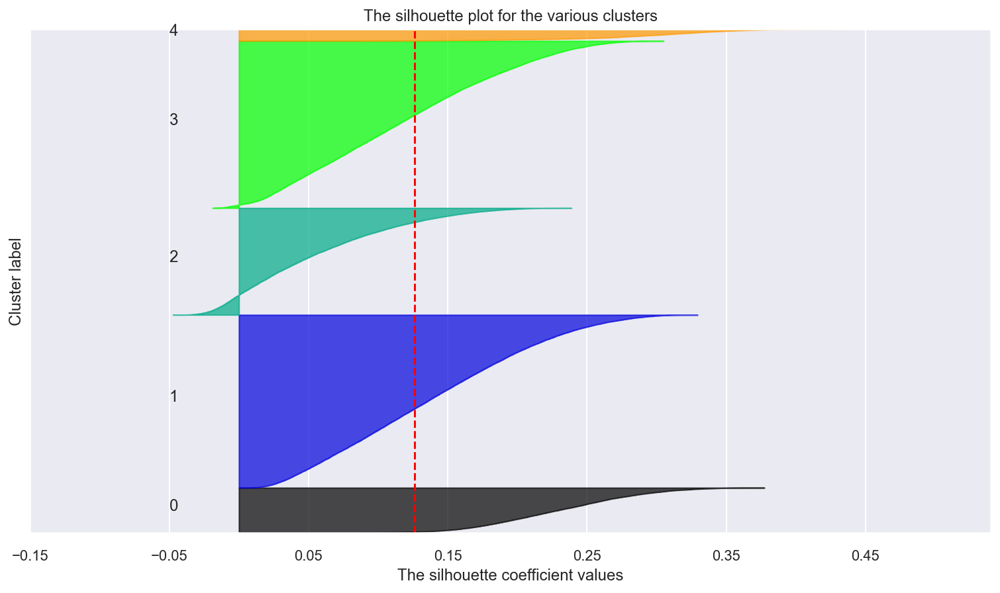

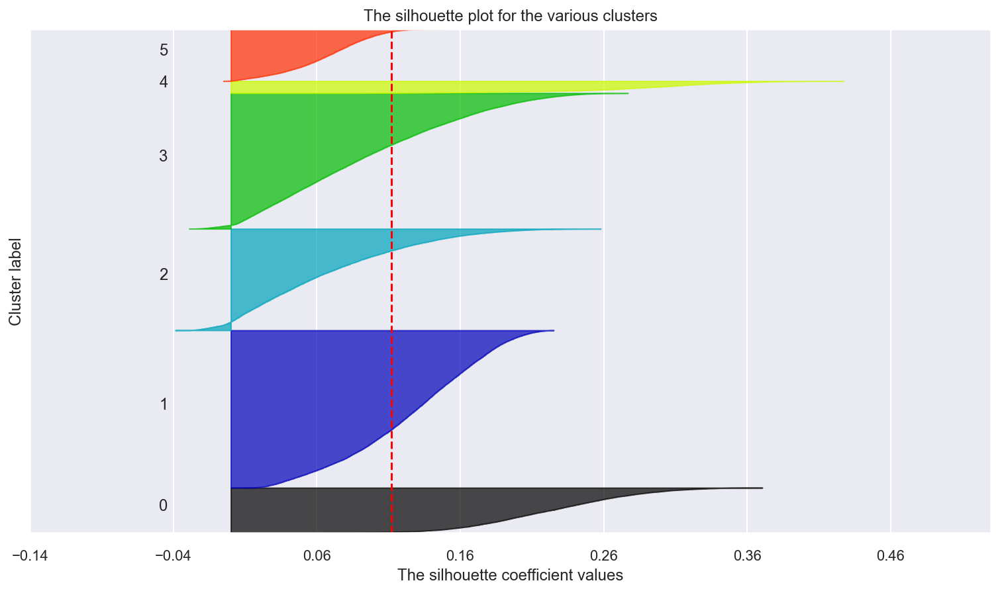

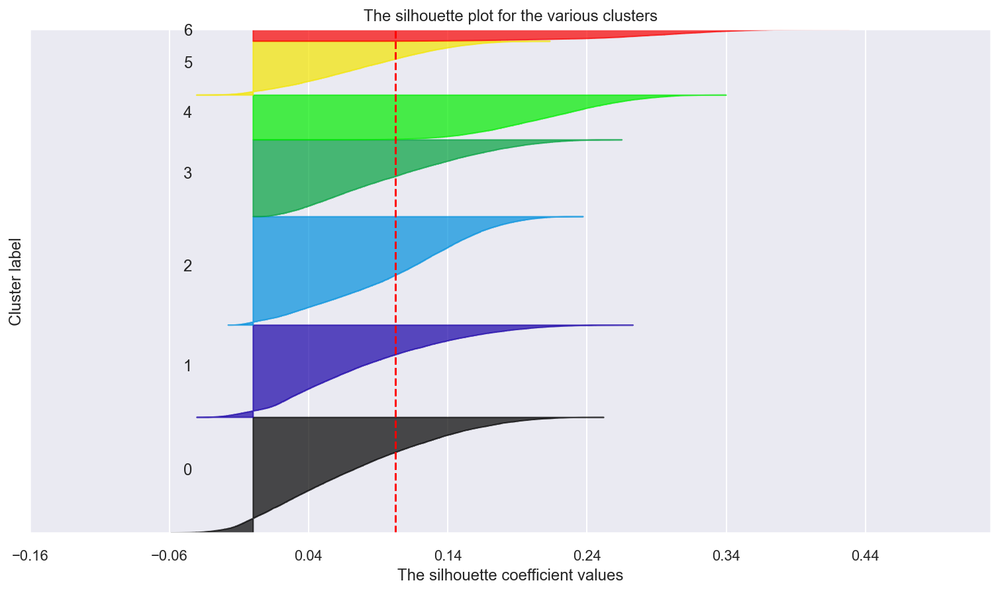

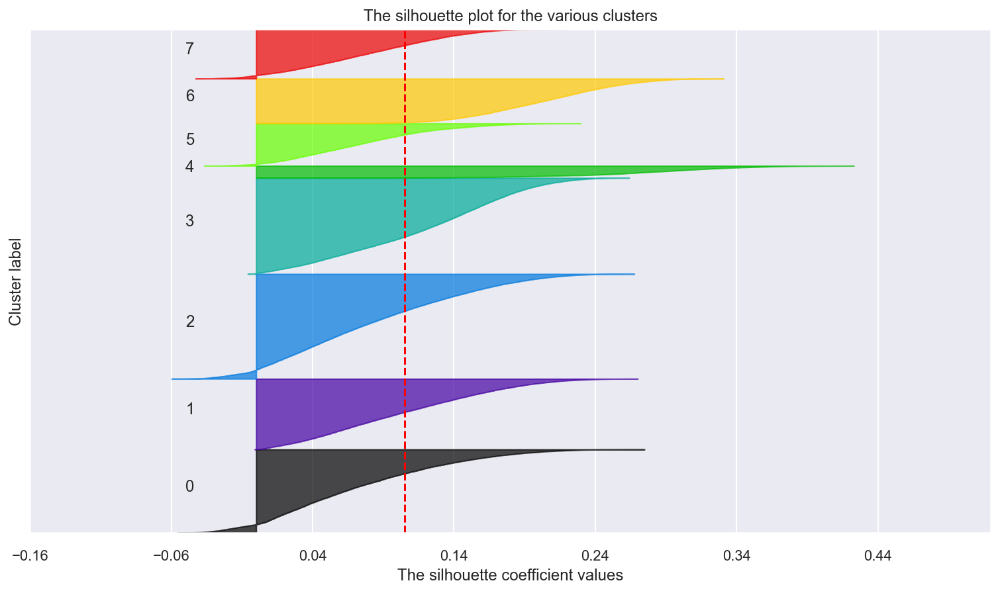

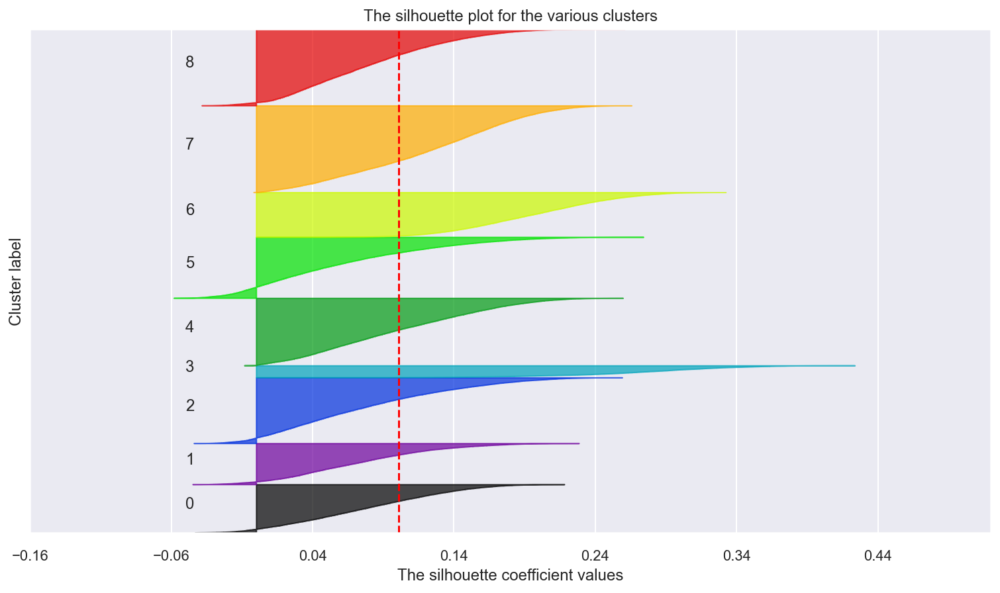

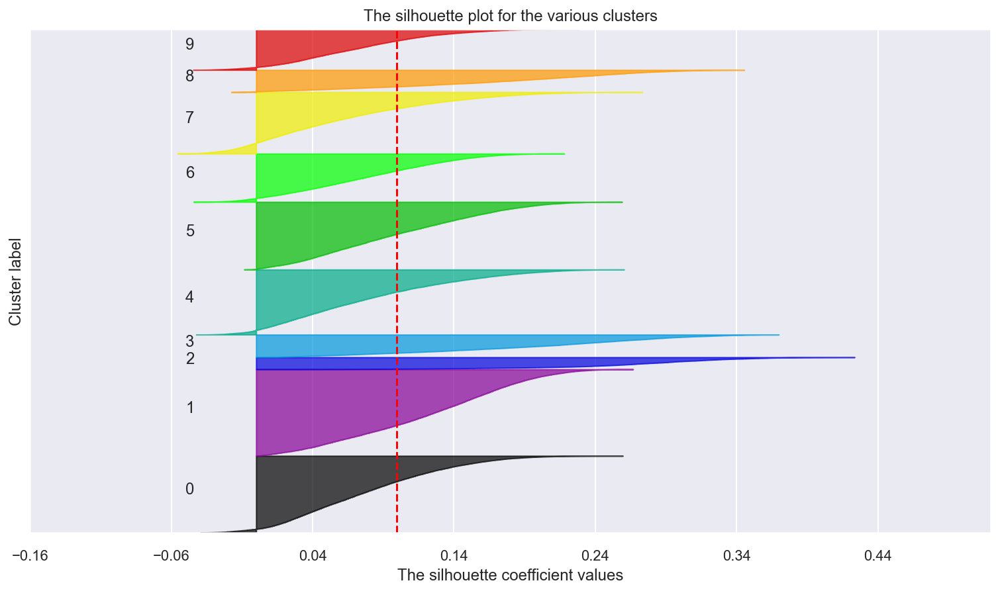

In [154]:
# Storing average silhouette metric
avg_silhouette = []
for nclus in range(1, 11):
    # Skip cluster=1
    if nclus == 1: continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=4)
    cluster_labels = kmclust.fit_predict(kmeans_data)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(kmeans_data, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f'For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}')

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(kmeans_data, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title('The silhouette plot for the various clusters')
    plt.xlabel('The silhouette coefficient values')
    plt.ylabel('Cluster label')

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color='red', linestyle='--')
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(kmeans_data) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

## 5.5 SOM & Hierarchical Clustering

In [155]:
def silhouette_analysis(df, estimator, shape, figsize, max_nclus, min_nclus=2, dist="euclidean"):
    """
    This function calculates the silhouette coefficient for each observation according to a clustering solution and then builds the 
    Silhouette plots for a given range of cluster solutions. This is useful to find out the most appropriate number of clusters.
    """
    range_n_clusters = list(range(min_nclus, max_nclus+1))
    
    sns.set()
    fig, axes = plt.subplots(nrows=shape[0], ncols=shape[1], figsize=figsize)
    if len(range_n_clusters)==1: # in case we want to seed the silhouette for just one cluster solution
        forax = [axes]
    else:
        forax = axes.flatten()
    for ax, n_clusters in zip(forax, range_n_clusters):
        
        # Get parameter that defines number of clusters
        if 'n_clusters' in estimator.get_params():
            param = 'n_clusters'
        elif 'n_components' in estimator.get_params():
            param = 'n_components'
        else:
            print('Estimator has no parameter to define number of clusters')
            return None
        
        # Get the cluster labels by applying a given clustering algorithm
        clustering = estimator.set_params(**{param:n_clusters})
        labels = clustering.fit_predict(df)
        
        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed clusters
        silhouette_avg = silhouette_score(df, labels, metric=dist)
        
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(df, labels, metric=dist)
        
        # The silhouette coefficient can range from -1, 1
        ax.set_xlim([sample_silhouette_values.min()-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette plots of individual clusters, to demarcate them clearly.
        ax.set_ylim([0, df.shape[0] + (n_clusters + 1) * 10]) 
        
        y_lower = 10 # initialize y_lower
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i
            
            color = cm.nipy_spectral(float(i) / n_clusters)
            ax.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples
        
        ax.set_title('{} Clusters'.format(n_clusters), fontsize=13)
        ax.set_xlabel('Silhouette Coefficients')
        ax.set_ylabel('Cluster Labels')
        ax.set_yticks([])  # Clear the yaxis labels / ticks
        ax.axvline(x=silhouette_avg, color='red', linestyle='--', label='Average Silhouette') #The vertical line for average silhouette score of all the values
        handles, _ = ax.get_legend_handles_labels()
        ax.legend(handles, ['Average Silhouette = {0:.2f}'.format(silhouette_avg)])
    
    plt.subplots_adjust(hspace=0.35)
    plt.suptitle(('Clustering Silhouette Plots'), fontsize=23, fontweight='bold')
    plt.show()

In [156]:
from sompy.sompy import SOMFactory
#Producing SOM clustering 
sm = SOMFactory().build(data=kmeans_data.values, mapsize=(10,10), normalization='var', initialization='random',
                        component_names=kmeans_data.columns, lattice='hexa', training='seq')

sm.train(n_job=4, verbose=None, train_rough_len=100, train_finetune_len=100)

#Obtaining SOM's BMUs labels
som_std_df = pd.DataFrame(np.concatenate((sm._data, np.expand_dims(sm._bmu[0],1)), axis=1),
                               index=kmeans_data.index, columns=np.append(kmeans_data.columns,'labels_som'))

print('SOM quantization error: {0:.3f}'.format(sm.calculate_quantization_error()))

SOM quantization error: 0.522


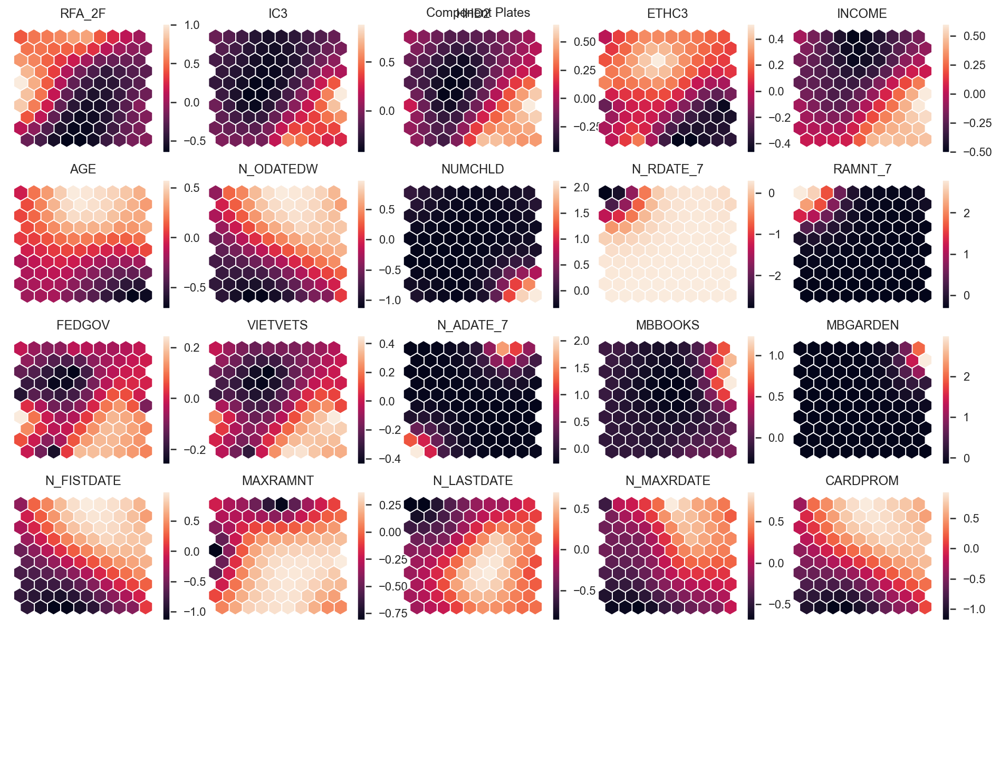

In [157]:
from sompy.visualization.mapview import View2D
#Visualizing the component plates (feature values)
view2D = View2D(10,10,'Component Plates', text_size=10)
view2D.show(sm, col_sz=5, what='codebook')
plt.subplots_adjust(top=0.90)
plt.show()

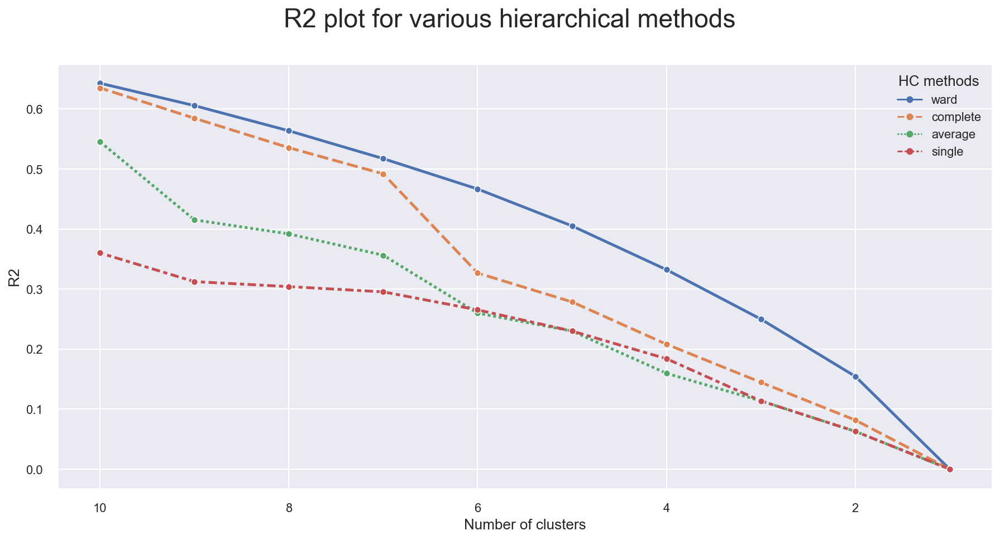

In [158]:
plot_r2_hc(som_std_df,'labels_som')

From the graph above R2 for hierarchical clustering we can conclude that the best HCM method is ward hence this will be taken for the upcoming analysis

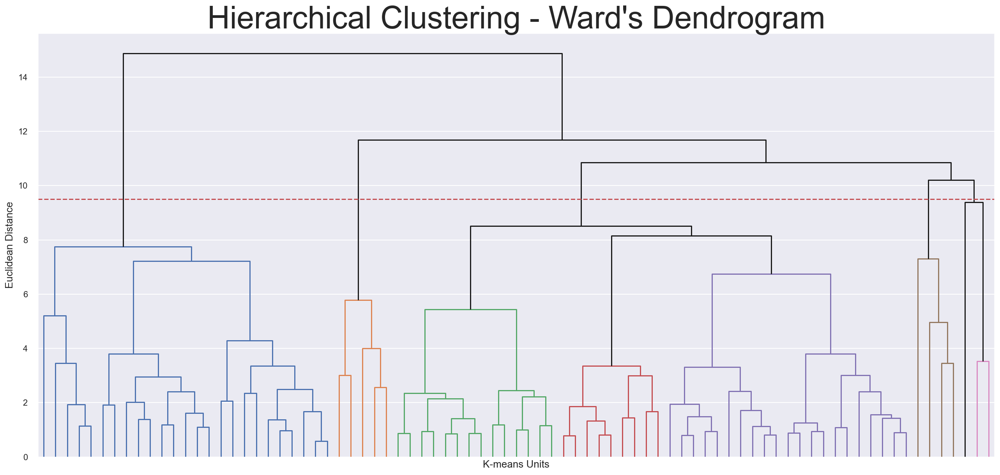

In [159]:
# Update the centroids of som units given by the BMUs of each observation
som_units = som_std_df.groupby('labels_som').mean()
plot_hc_dendogram(som_units,'ward')

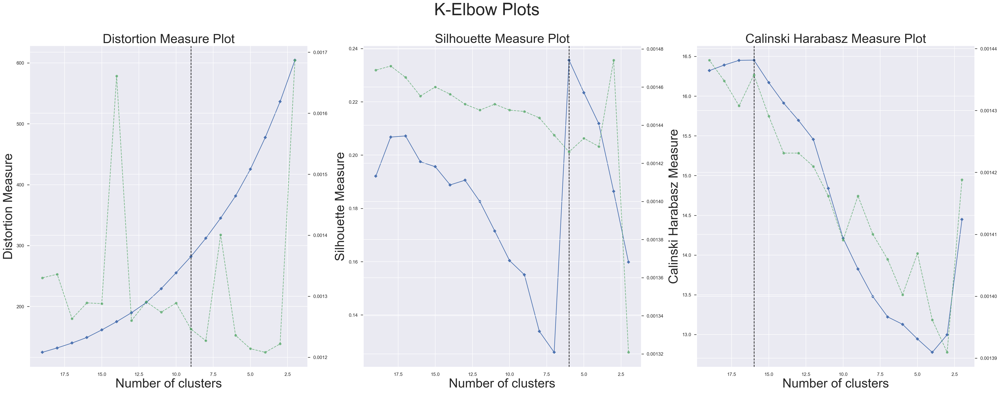

In [160]:
# Hierarchical clustering with sklearn and selected linkage and n_cluster according to plot above and below
Hclustering = AgglomerativeClustering(linkage='ward')
# K-elbow plots
kelbowplots(Hclustering, som_units)

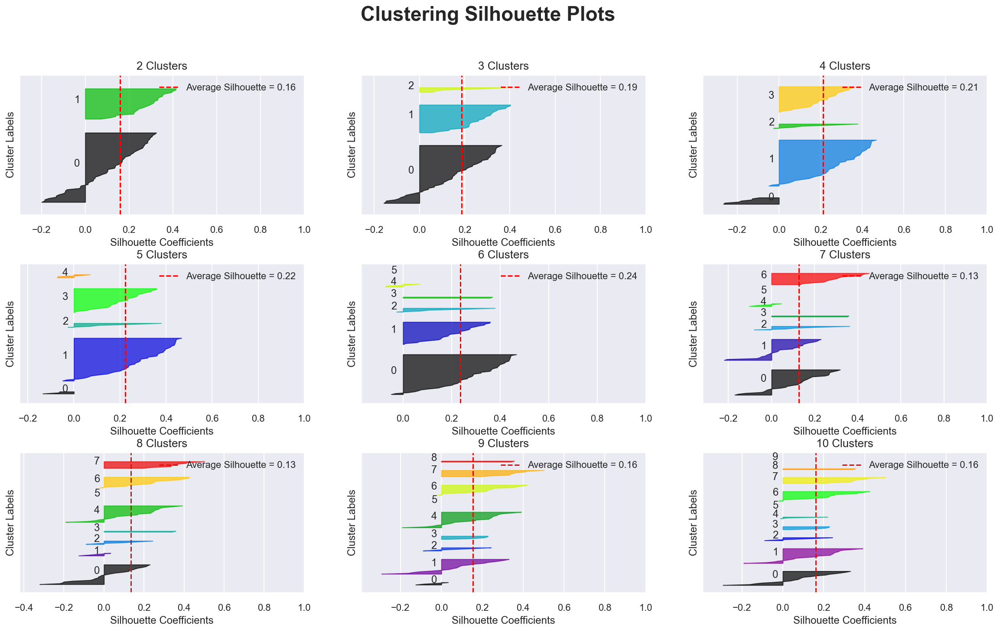

In [161]:
# Function defined above
estimator = AgglomerativeClustering(affinity='euclidean', linkage='ward')
silhouette_analysis(som_units, estimator, (3,3), (20, 11), 10)

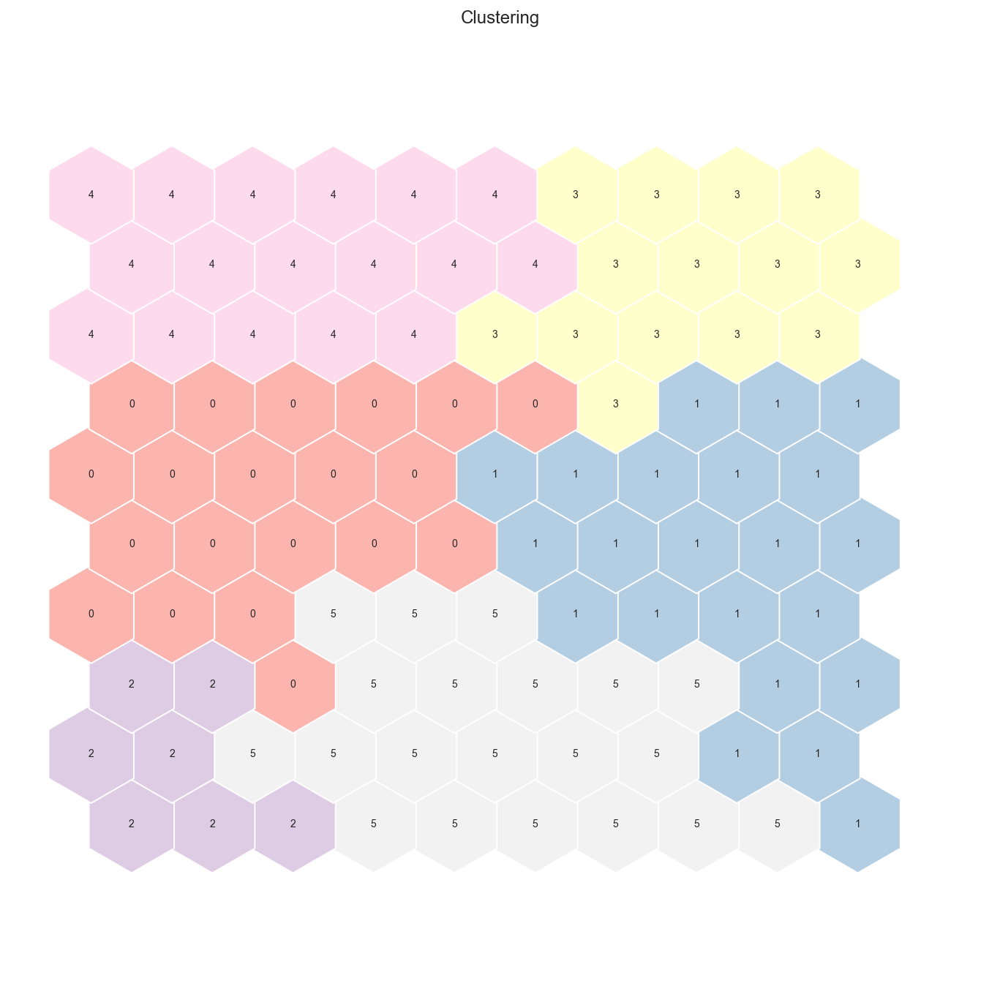

In [208]:
from sompy.visualization.hitmap import HitMapView
# Perform K-Means clustering on top of the 100 untis (sm.get_node_vectors() output)
kmeans = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=4)
nodeclus_labels = sm.cluster(kmeans)

hits  = HitMapView(12, 12,'Clustering', text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap='Pastel1')
plt.show()

In [163]:
def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = ['']*len(label_columns)      
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, 'counts']
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y='counts', data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ['Cluster {}'.format(i) for i in range(len(handles))]
        ax[0].annotate(s=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=10, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle='--')
        ax[0].set_title('Cluster Means - {} Clusters'.format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-90)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel('')
        ax[1].set_ylabel('Absolute Frequency')
        ax[1].set_title('Cluster Sizes - {} Clusters'.format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle('Cluster Simple Profilling', fontsize=23)
    plt.show()

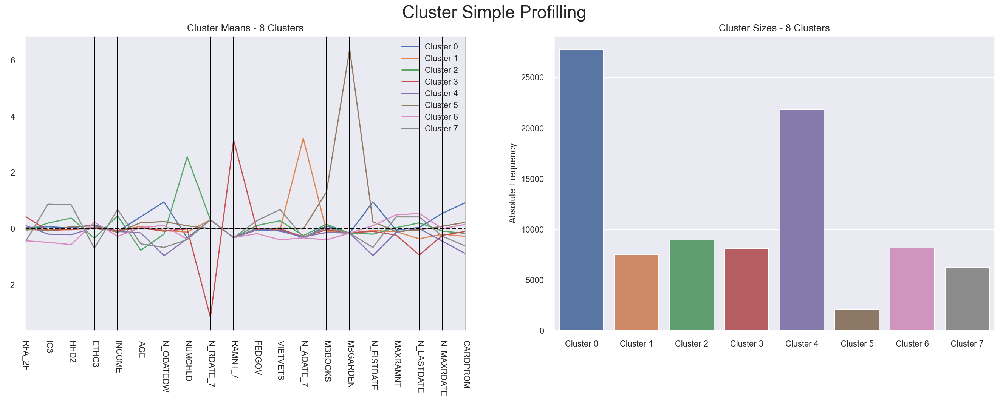

In [164]:
# Defining numbers of clusters
CLUSN = 8

# Hierarchical Clustering with sklearn
estimator = AgglomerativeClustering(n_clusters=CLUSN, linkage='ward')
labels = estimator.fit_predict(som_units)

# Getting the HC labels for each SOM Unit
som_units_hc = pd.DataFrame(np.concatenate((som_units.values, np.expand_dims(labels,1)), axis=1), 
                            index=som_units.index, columns=np.append(som_units.columns,['labels_som_hc_8']))

# Getting the HC labels for each observation in the main dataframe
som_hc_std_df = som_std_df.merge(right=som_units_hc.loc[:,'labels_som_hc_8'], 
                                           left_on='labels_som', right_index=True).sort_index()
# Cluster Simple Profilling
cluster_profiles(som_hc_std_df.drop('labels_som', axis=1), ['labels_som_hc_8'], (23, 7))

## 5.6 SOM & K-Means

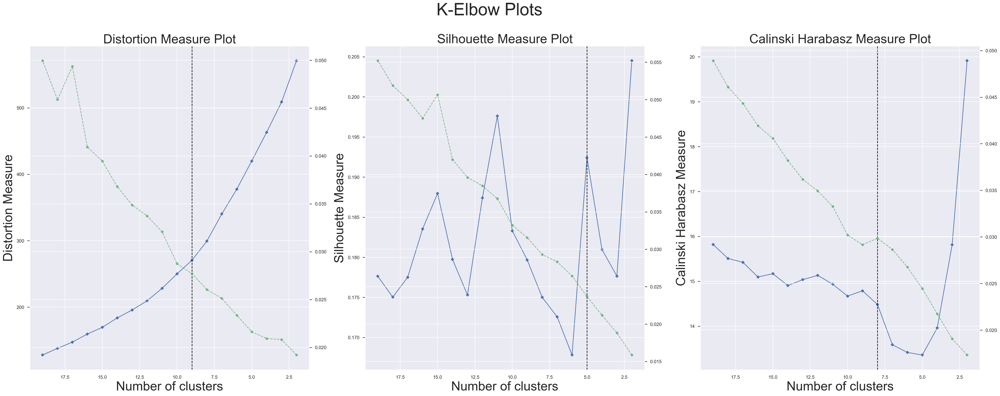

In [165]:
# Hierarchical clustering with sklearn and selected linkage and n_cluster according to plot above and below
Kmeans = KMeans(random_state=4)
# K-elbow plots
kelbowplots(Kmeans, som_units)

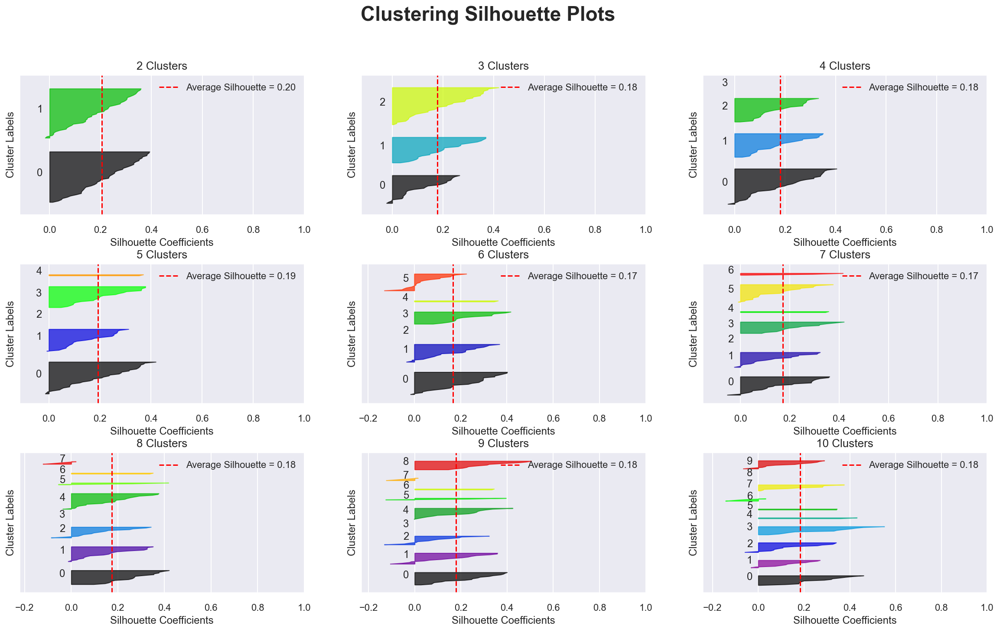

In [166]:
# Function defined above
estimator = KMeans(random_state=4)
silhouette_analysis(som_units, estimator, (3,3), (20, 11), 10)

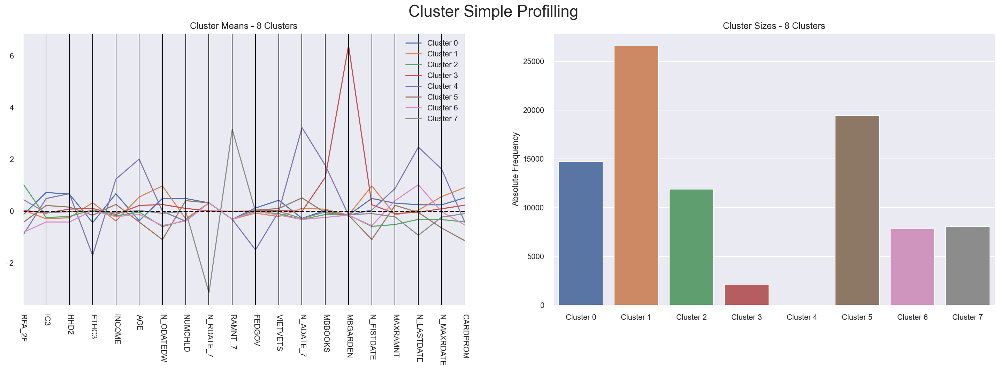

In [167]:
# Defining numbers of clusters
CLUSN = 8

# KMeans with sklearn
estimator = KMeans(n_clusters=CLUSN)
labels = estimator.fit_predict(som_units)

# Getting the KMeans labels for each SOM Unit
som_units_hc = pd.DataFrame(np.concatenate((som_units.values, np.expand_dims(labels,1)), axis=1), 
                            index=som_units.index, columns=np.append(som_units.columns,['labels_som_kmeans_8']))

# Getting the KMeans labels for each observation in the main dataframe
som_kmeans_df = som_std_df.merge(right=som_units_hc.loc[:,'labels_som_kmeans_8'], 
                                           left_on='labels_som', right_index=True).sort_index()
# Cluster simple profilling
cluster_profiles(som_kmeans_df.drop('labels_som', axis=1), ['labels_som_kmeans_8'], (25, 7))

## 5.7 Gaussian Mixture Model

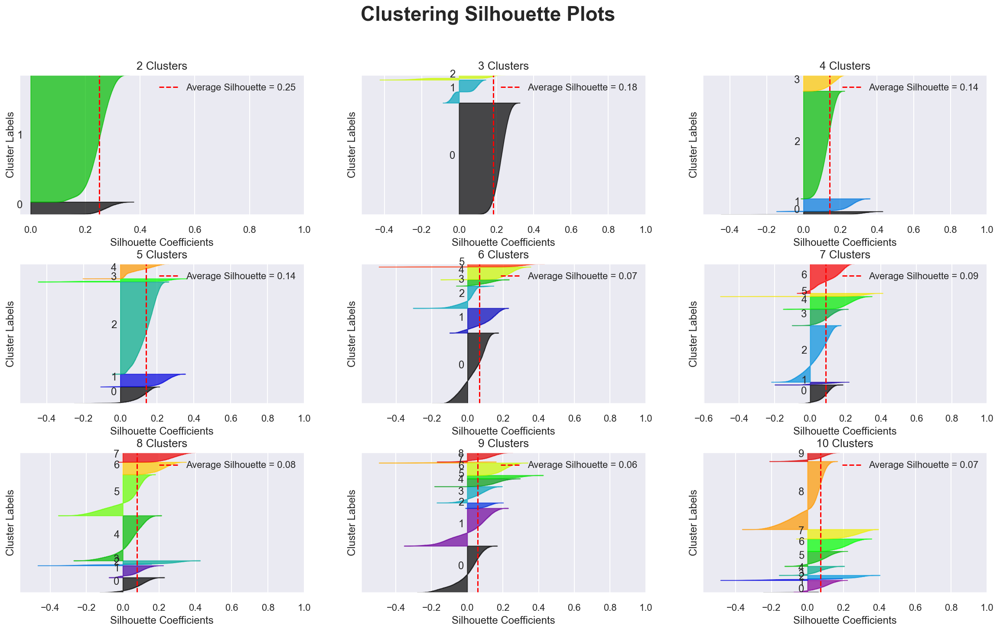

In [168]:
# Function defined above
estimator = GaussianMixture(random_state=random_state, n_init=10)
silhouette_analysis(kmeans_data, estimator, (3,3), (20, 11), 10)

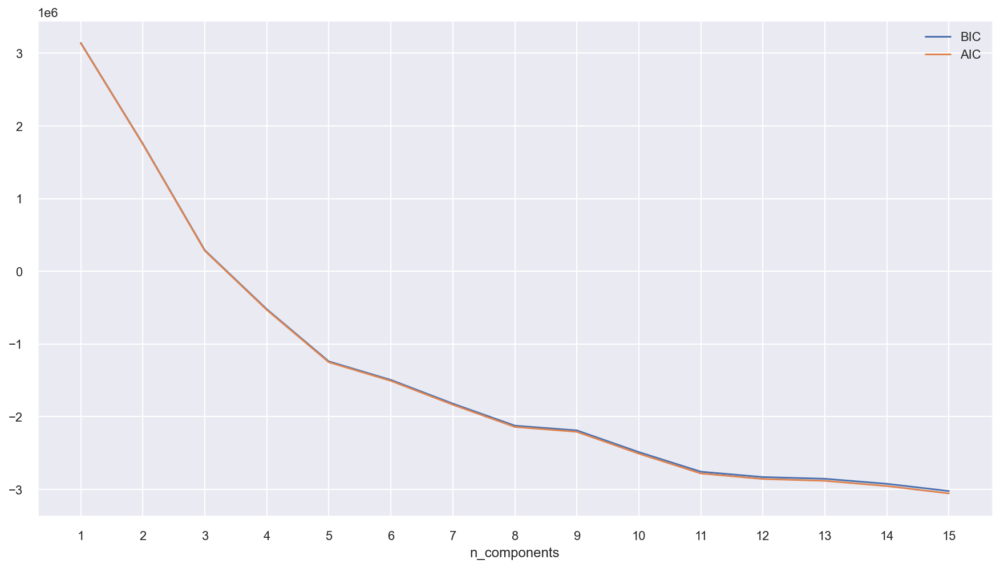

In [169]:
# Selecting number of components based on AIC and BIC
n_components = np.arange(1, 16)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=4).fit(kmeans_data) for n in n_components]

bic_values = [m.bic(kmeans_data) for m in models]
aic_values = [m.aic(kmeans_data) for m in models]
plt.plot(n_components, bic_values, label='BIC')
plt.plot(n_components, aic_values, label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components')
plt.xticks(n_components)
plt.show()

In [170]:
# Performing GMM Clustering
gmm = GaussianMixture(n_components=8, covariance_type='full', n_init=10, init_params='kmeans', random_state=random_state)
gmm_labels = gmm.fit_predict(kmeans_data)

In [226]:
# Concatenating the labels to df
df_concat = kmeans_data.copy()
df_concat.drop(['labels'],axis=1,inplace=True)
df_concat['gmm_labels']=gmm_labels
df_concat.head()

,RFA_2F,IC3,HHD2,ETHC3,INCOME,AGE,N_ODATEDW,NUMCHLD,N_RDATE_7,RAMNT_7,FEDGOV,VIETVETS,N_ADATE_7,MBBOOKS,MBGARDEN,N_FISTDATE,MAXRAMNT,N_LASTDATE,N_MAXRDATE,CARDPROM,gmm_labels
index,,,,,,,,,,,,,,,,,,,,,
0,1.522953,-0.174613,0.574399,0.840312,0.089928,0.040448,0.783487,-0.389658,0.316734,-0.316734,-0.490916,0.311415,-0.325295,-0.537481,-0.156262,0.701996,-0.821522,-0.169728,1.048083,1.000048,4
1,0.533260,3.320908,2.160054,-1.307435,1.237351,-0.989092,-0.678759,2.563324,0.316734,-0.316734,-0.490916,1.602509,-0.325295,1.948978,-0.156262,-0.548924,0.796598,-0.169728,-0.851874,-0.691395,0
2,1.522953,-0.571581,0.190568,0.273252,-0.509019,0.475543,0.539863,-0.389658,0.316734,-0.316734,-0.490916,-0.013475,-0.325295,1.770134,-0.156262,0.657284,-0.150895,-0.169728,1.588623,0.900036,4
3,1.522953,0.132271,-0.078019,-0.216435,-1.786459,0.697636,1.222403,-0.389658,0.316734,-0.316734,0.424410,-1.054447,-0.325295,-0.537481,-0.156262,1.366294,-1.033431,-0.169728,0.547991,1.000048,4
4,0.533260,-0.564346,0.777560,-2.712723,-0.509019,1.303874,1.421905,2.563324,0.316734,-0.316734,0.055083,-1.436767,0.201975,1.963492,-0.156262,2.783013,-0.297283,-0.422134,-1.017231,2.455224,0


In [172]:
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

In [223]:
# Computing the R^2 of the cluster solution
sst = get_ss(cluster_data_enc)  # get total sum of squares
ssw_labels = df_concat.groupby(by='gmm_labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster Solution with R^2 of %0.4f" % r2)

Cluster Solution with R^2 of 0.9998


## 5.8 DBSCAN (Density-Based Spatial Clustering of Applications with Noise)

In [174]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=1.9, min_samples=20, n_jobs=4)
dbscan_labels = dbscan.fit_predict(kmeans_data)
dbscan_n_clusters = len(np.unique(dbscan_labels))
print('Number of estimated clusters : %d' % dbscan_n_clusters)

Number of estimated clusters : 14


In [225]:
df_concat

,RFA_2F,IC3,HHD2,ETHC3,INCOME,AGE,N_ODATEDW,NUMCHLD,N_RDATE_7,RAMNT_7,FEDGOV,VIETVETS,N_ADATE_7,MBBOOKS,MBGARDEN,N_FISTDATE,MAXRAMNT,N_LASTDATE,N_MAXRDATE,CARDPROM,labels
index,,,,,,,,,,,,,,,,,,,,,
0,1.522953,-0.174613,0.574399,0.840312,0.089928,0.040448,0.783487,-0.389658,0.316734,-0.316734,-0.490916,0.311415,-0.325295,-0.537481,-0.156262,0.701996,-0.821522,-0.169728,1.048083,1.000048,1
1,0.533260,3.320908,2.160054,-1.307435,1.237351,-0.989092,-0.678759,2.563324,0.316734,-0.316734,-0.490916,1.602509,-0.325295,1.948978,-0.156262,-0.548924,0.796598,-0.169728,-0.851874,-0.691395,3
2,1.522953,-0.571581,0.190568,0.273252,-0.509019,0.475543,0.539863,-0.389658,0.316734,-0.316734,-0.490916,-0.013475,-0.325295,1.770134,-0.156262,0.657284,-0.150895,-0.169728,1.588623,0.900036,1
3,1.522953,0.132271,-0.078019,-0.216435,-1.786459,0.697636,1.222403,-0.389658,0.316734,-0.316734,0.424410,-1.054447,-0.325295,-0.537481,-0.156262,1.366294,-1.033431,-0.169728,0.547991,1.000048,1
4,0.533260,-0.564346,0.777560,-2.712723,-0.509019,1.303874,1.421905,2.563324,0.316734,-0.316734,0.055083,-1.436767,0.201975,1.963492,-0.156262,2.783013,-0.297283,-0.422134,-1.017231,2.455224,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95407,-0.942374,0.754786,-0.163943,-1.307435,0.089928,-0.381838,-1.536071,-0.389658,-3.157219,3.157590,1.872670,1.122414,-0.048911,-0.537481,-0.156262,-1.615662,0.796598,-0.666757,-1.194650,-1.569204,4
95408,-0.942374,2.322588,1.549322,-1.307435,1.791649,-0.857021,-1.536071,2.563324,-3.157224,3.157583,-1.497847,0.877368,-0.048911,1.770134,-0.156262,-1.661370,0.336979,-0.903714,-1.385235,-1.920456,4
95409,1.175084,-0.379779,-0.788290,-0.326785,0.089928,-0.030847,-1.076732,-0.389658,0.316734,-0.316734,-1.497847,1.061487,3.224795,-0.537481,-0.156262,-0.963013,-1.270249,-2.357552,0.398518,-0.434798,0


In [228]:
# Concatenating the labels to df
df_concat = kmeans_data.copy()
df_concat.drop(['labels'],axis=1,inplace=True)
df_concat['dbscan_labels']=dbscan_labels
df_concat.head()

,RFA_2F,IC3,HHD2,ETHC3,INCOME,AGE,N_ODATEDW,NUMCHLD,N_RDATE_7,RAMNT_7,FEDGOV,VIETVETS,N_ADATE_7,MBBOOKS,MBGARDEN,N_FISTDATE,MAXRAMNT,N_LASTDATE,N_MAXRDATE,CARDPROM,dbscan_labels
index,,,,,,,,,,,,,,,,,,,,,
0,1.522953,-0.174613,0.574399,0.840312,0.089928,0.040448,0.783487,-0.389658,0.316734,-0.316734,-0.490916,0.311415,-0.325295,-0.537481,-0.156262,0.701996,-0.821522,-0.169728,1.048083,1.000048,0
1,0.533260,3.320908,2.160054,-1.307435,1.237351,-0.989092,-0.678759,2.563324,0.316734,-0.316734,-0.490916,1.602509,-0.325295,1.948978,-0.156262,-0.548924,0.796598,-0.169728,-0.851874,-0.691395,-1
2,1.522953,-0.571581,0.190568,0.273252,-0.509019,0.475543,0.539863,-0.389658,0.316734,-0.316734,-0.490916,-0.013475,-0.325295,1.770134,-0.156262,0.657284,-0.150895,-0.169728,1.588623,0.900036,1
3,1.522953,0.132271,-0.078019,-0.216435,-1.786459,0.697636,1.222403,-0.389658,0.316734,-0.316734,0.424410,-1.054447,-0.325295,-0.537481,-0.156262,1.366294,-1.033431,-0.169728,0.547991,1.000048,0
4,0.533260,-0.564346,0.777560,-2.712723,-0.509019,1.303874,1.421905,2.563324,0.316734,-0.316734,0.055083,-1.436767,0.201975,1.963492,-0.156262,2.783013,-0.297283,-0.422134,-1.017231,2.455224,-1


In [229]:
# Detecting noise (potential outliers)
df_concat.loc[df_concat['dbscan_labels'] == -1]

,RFA_2F,IC3,HHD2,ETHC3,INCOME,AGE,N_ODATEDW,NUMCHLD,N_RDATE_7,RAMNT_7,FEDGOV,VIETVETS,N_ADATE_7,MBBOOKS,MBGARDEN,N_FISTDATE,MAXRAMNT,N_LASTDATE,N_MAXRDATE,CARDPROM,dbscan_labels
index,,,,,,,,,,,,,,,,,,,,,
1,0.533260,3.320908,2.160054,-1.307435,1.237351,-0.989092,-0.678759,2.563324,0.316734,-0.316734,-0.490916,1.602509,-0.325295,1.948978,-0.156262,-0.548924,0.796598,-0.169728,-0.851874,-0.691395,-1
4,0.533260,-0.564346,0.777560,-2.712723,-0.509019,1.303874,1.421905,2.563324,0.316734,-0.316734,0.055083,-1.436767,0.201975,1.963492,-0.156262,2.783013,-0.297283,-0.422134,-1.017231,2.455224,-1
11,0.533260,-0.741015,-2.499743,1.054471,-1.786459,1.074211,-1.536071,-0.389658,0.316734,-0.316734,-1.497847,-1.054447,-0.325295,1.770134,-0.156262,-1.396725,-0.297283,-0.169728,-0.418695,-1.253594,-1
12,1.522953,-0.756035,0.574399,0.182280,0.089928,0.847319,0.783487,2.571393,0.316734,-0.316734,1.102284,0.117503,3.224795,1.770134,6.399510,0.832713,-2.197544,-0.422134,1.811821,0.377794,-1
13,-0.942374,-0.134495,0.777560,-0.692949,0.089928,-0.030847,-0.010801,-0.389658,0.316734,-0.316734,-0.490916,0.502532,-0.325295,-0.537481,-0.156262,-0.181905,2.050775,-2.710603,0.475423,0.591455,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95398,1.175084,0.823575,-0.330457,-0.110814,0.670904,2.008765,1.421905,-0.389658,0.316734,-0.316734,-1.497847,-0.553614,-0.325295,-0.537481,-0.156262,1.197409,0.796598,-0.666757,-0.697585,1.196213,-1
95408,-0.942374,2.322588,1.549322,-1.307435,1.791649,-0.857021,-1.536071,2.563324,-3.157224,3.157583,-1.497847,0.877368,-0.048911,1.770134,-0.156262,-1.661370,0.336979,-0.903714,-1.385235,-1.920456,-1
95409,1.175084,-0.379779,-0.788290,-0.326785,0.089928,-0.030847,-1.076732,-0.389658,0.316734,-0.316734,-1.497847,1.061487,3.224795,-0.537481,-0.156262,-0.963013,-1.270249,-2.357552,0.398518,-0.434798,-1


In [177]:
# Computing the R^2 of the cluster solution
df_nonoise = df_concat.loc[df_concat['dbscan_labels'] != -1]
sst = get_ss(cluster_data_enc)  # get total sum of squares
ssw_labels = df_nonoise.groupby(by='dbscan_labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print('Cluster solution with R^2 of %0.4f' % r2)

Cluster solution with R^2 of 0.9999


## 5.9 Accuracy Metrics

In [178]:
def cluster_metric_summary(cluster_model):
    index_name=['Silhouette_Score','Calinski_Harabasz_Score','Davies_Bouldin_Score']
    column_name = ['KM','KM+HC','HC+SOM','KM+SOM','GMM','DBSCAN']
    df = pd.DataFrame(index=index_name, columns=column_name)
    if column_name == 'DBSCAN': n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
    for i,model in enumerate(cluster_model):
        cluster_labels = model[0].fit_predict(model[1])
        df[column_name[i]][0] = silhouette_score(model[1],cluster_labels)
        df[column_name[i]][1] = calinski_harabasz_score(model[1],cluster_labels)
        df[column_name[i]][2] = davies_bouldin_score(model[1],cluster_labels)
    return df

In [183]:
for n_clusters in range(5,11):
    cluster_model=[]
    cluster_model.append([KMeans(n_clusters=n_clusters, init='k-means++', max_iter=1000, tol=0.0001),kmeans_data])
    cluster_model.append([AgglomerativeClustering(n_clusters=n_clusters, linkage='ward'),kmeans_clusters])
    cluster_model.append([AgglomerativeClustering(n_clusters=n_clusters, linkage='ward'),som_units])
    cluster_model.append([KMeans(n_clusters=n_clusters),som_units])
    cluster_model.append([GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=random_state), kmeans_data])
    cluster_model.append([DBSCAN(eps=1.9, min_samples= 40, n_jobs=4), kmeans_data])
    dic['cluster_metric_'+str(n_clusters)]=cluster_metric_summary(cluster_model)

In [190]:
# Print Clustering Accuracy Metrics - 5 Clusters
dic['cluster_metric_5']

,KM,KM+HC,HC+SOM,KM+SOM,GMM,DBSCAN
Silhouette_Score,0.123635,0.211798,0.223448,0.192365,0.0968578,-0.10352
Calinski_Harabasz_Score,9844.72,21.3917,12.9446,12.8738,5323.15,1063.18
Davies_Bouldin_Score,2.08232,1.48007,1.38095,1.38171,2.716,2.50095


In [184]:
# Print Clustering Accuracy Metrics
dic['cluster_metric_6']

,KM,KM+HC,HC+SOM,KM+SOM,GMM,DBSCAN
Silhouette_Score,0.130104,0.237995,0.235647,0.196629,0.0895409,-0.10352
Calinski_Harabasz_Score,9213.6,22.1867,13.1287,13.6484,6309.01,1063.18
Davies_Bouldin_Score,1.97074,1.33865,1.12042,1.19123,2.32194,2.50095


In [185]:
# Print Clustering Accuracy Metrics
dic['cluster_metric_7']

,KM,KM+HC,HC+SOM,KM+SOM,GMM,DBSCAN
Silhouette_Score,0.100278,0.237863,0.125975,0.180871,0.0874229,-0.10352
Calinski_Harabasz_Score,8293.71,20.0488,13.2217,13.7969,5380.57,1063.18
Davies_Bouldin_Score,2.28326,1.1734,1.23103,1.14436,2.92833,2.50095


In [186]:
# Print Clustering Accuracy Metrics
dic['cluster_metric_8']

,KM,KM+HC,HC+SOM,KM+SOM,GMM,DBSCAN
Silhouette_Score,0.112416,0.189642,0.13388,0.157847,0.078439,-0.10352
Calinski_Harabasz_Score,7733.77,18.4646,13.4774,13.1749,6182.16,1063.18
Davies_Bouldin_Score,2.05538,1.27619,1.20845,1.29503,2.47229,2.50095


In [187]:
# Print Clustering Accuracy Metrics
dic['cluster_metric_9']

,KM,KM+HC,HC+SOM,KM+SOM,GMM,DBSCAN
Silhouette_Score,0.101084,0.186222,0.155074,0.175582,0.0525386,-0.10352
Calinski_Harabasz_Score,7549.5,17.2327,13.8247,14.6557,5138.1,1063.18
Davies_Bouldin_Score,2.13662,1.28227,1.19662,1.17261,2.99488,2.50095


In [188]:
# Print Clustering Accuracy Metrics
dic['cluster_metric_10']

,KM,KM+HC,HC+SOM,KM+SOM,GMM,DBSCAN
Silhouette_Score,0.0995755,0.190079,0.160387,0.190558,0.0748834,-0.10352
Calinski_Harabasz_Score,7106.32,16.3174,14.2117,14.9236,4058.49,1063.18
Davies_Bouldin_Score,2.18049,1.18085,1.08338,1.02733,3.19851,2.50095


In [199]:
# Applying the right clustering algorithm and number of clusters
kmeans_final = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=42)
kmeans_final_labels = kmeans_final.fit_predict(kmeans_data)
kmeans_data['labels'] = kmeans_final_labels

In [200]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=6)
hclust_labels = hclust.fit_predict(kmeans_clusters)
kmeans_clusters['hclust_labels'] = hclust_labels
kmeans_clusters  # centroid's cluster labels

,RFA_2F,IC3,HHD2,ETHC3,INCOME,AGE,N_ODATEDW,NUMCHLD,N_RDATE_7,RAMNT_7,FEDGOV,VIETVETS,N_ADATE_7,MBBOOKS,MBGARDEN,N_FISTDATE,MAXRAMNT,N_LASTDATE,N_MAXRDATE,CARDPROM,hclust_labels
kmeans_labels,,,,,,,,,,,,,,,,,,,,,
0,0.323792,-0.455103,-0.413878,0.538864,-0.825714,-1.830142,0.869785,-0.389658,0.316734,-0.316734,-0.122324,-0.261334,-0.324370,-0.400657,-0.156262,0.877781,-0.262282,0.045774,0.550193,0.862667,1
1,1.215165,-0.504112,-0.131712,0.057688,-1.306707,0.611071,-0.729506,-0.389658,0.316734,-0.316734,0.264725,-0.010839,-0.325295,-0.537481,-0.156262,-0.725866,-0.958919,-0.258622,-0.264923,-0.566087,0
2,0.905534,-0.027085,0.200142,0.041397,0.471505,0.188798,1.034968,-0.389658,0.316734,-0.316734,0.157325,0.045362,-0.324192,-0.533658,-0.156262,1.030669,-0.575015,-0.250755,-0.566038,0.915782,1
3,-0.850736,-0.487314,0.032036,-0.184234,-0.900881,0.080305,0.007665,-0.389658,0.316734,-0.316734,-0.330400,0.028059,-0.325295,-0.535401,-0.156262,-0.008717,0.426886,1.719187,0.385859,0.009775,1
4,-0.085891,0.770859,0.961292,-0.801197,0.758452,-0.402127,-1.027120,-0.389658,0.316734,-0.316734,0.393130,0.820245,-0.284374,1.849579,-0.156262,-1.018103,0.179910,-0.215064,-0.634988,-0.956663,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,-0.076086,-0.327965,-0.172005,0.003315,0.031765,-0.401084,0.623820,2.565990,0.316734,-0.316734,-0.098741,-0.074623,-0.324613,-0.537481,-0.156262,0.604654,0.337910,-0.337309,-0.529783,0.568123,2
96,1.102104,0.524680,0.926631,-0.898173,0.619547,-0.934855,-0.589945,2.566954,0.316734,-0.316734,0.677600,1.040395,-0.323738,-0.186426,-0.156262,-0.582188,-0.639744,-0.320570,-0.295201,-0.411986,2
97,1.210973,-0.577966,-0.368485,0.521703,-0.930794,0.843617,1.086693,-0.383237,0.316734,-0.316734,-0.206846,-0.252208,-0.323386,-0.537481,-0.156262,1.090726,-1.787579,-0.187709,1.399863,1.039217,1


In [233]:
df_concat = cluster_data.copy()
df_concat['Cluster']=kmeans_final_labels
df_concat.head()

,RFA_2F,RFA_2A,IC3,HHD2,ETHC3,INCOME,AGE,N_ODATEDW,NUMCHLD,PETS,N_RDATE_7,RAMNT_7,FEDGOV,VIETVETS,N_ADATE_7,MBBOOKS,MBGARDEN,N_FISTDATE,MAXRAMNT,N_LASTDATE,N_MAXRDATE,CARDPROM,Cluster
index,,,,,,,,,,,,,,,,,,,,,,,
0,4,E,349,80,25,4.0,60.0,144,0.0,,612,0.0,1,34,59,0.0,0.0,134,12.0,61,83,27,1
1,2,G,1026,94,5,6.0,45.0,84,1.0,,612,0.0,1,55,59,3.0,0.0,87,25.0,61,61,12,3
2,4,E,292,76,18,3.0,66.0,132,0.0,,612,0.0,1,29,59,1.0,0.0,132,16.0,61,102,26,1
3,4,E,396,73,13,1.0,69.0,168,0.0,,612,0.0,3,14,59,0.0,0.0,167,11.0,61,74,27,1
4,2,F,293,82,0,3.0,77.0,180,1.0,,612,0.0,2,9,61,9.0,0.0,262,15.0,60,60,43,1


In [234]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = kmeans_clusters['hclust_labels'].to_dict()
df_ = df_concat.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['Cluster'])
    ], axis=1
)

# Merged cluster centroids
df_.groupby('Cluster').mean().T

Cluster,0,1,2,3,4,5
RFA_2F,1.895010,1.894850,1.810676,1.734504,2.363964,1.900046
IC3,386.739469,348.579127,354.708730,517.003997,378.654539,372.906525
HHD2,71.797667,69.118520,68.738060,81.653690,71.783186,73.445627
ETHC3,17.505768,20.131617,17.530343,10.694937,17.048553,17.728829
INCOME,3.821257,3.388881,3.746128,5.087765,3.780330,3.676076
AGE,59.749190,65.303547,56.209017,51.196153,59.247734,61.849607
N_ODATEDW,113.251458,151.997067,76.040343,111.104855,112.115237,125.219806
NUMCHLD,0.168373,0.072237,0.137165,0.529487,0.192972,0.257288
N_RDATE_7,612.000000,612.000000,612.000000,612.000000,58.100211,557.402129
RAMNT_7,0.000000,0.000000,0.000000,0.000000,15.528080,1.465988


In [235]:
df_.groupby('Cluster')['RFA_2A','PETS'].agg(pd.Series.mode).T

Cluster,0,1,2,3,4,5
RFA_2A,F,F,F,F,F,F
PETS,,,,,,


## 6. Marketing Approach

In [236]:
# Getting size of each final cluster
df_counts = df_.groupby('Cluster').size().to_frame()
df_counts

,0
Cluster,
0,7715
1,29320
2,26151
3,17262
4,8053
5,2161


* **Cluster 0 - Middle Class Donors** 
    
    This is a medium-sized cluster - 7715 respondents. 
    They were not received promotion 96G1 (Date the 96G1 promotion was mailed is maximum). They have practically the largest personal income; donations occur quite often (RFA_2F) and Dollar amount of largest gift to date was in 4th place out of 6. For most clustering variables, this cluster is close to the central values. As a variant of a possible strategy, it is recommended to test the 96G1 campaign on them as a typical one according to the dataset sample to assess the response and the strategy for further communication according to the results obtained.


* **Cluster 1 - Donations are Less Often than Average, Above Average** 

    Majority (donations are less than average, above average) maximum cluster - 29,320 donors. Donors of this cluster are the most experienced donors - they have the earliest date of the first donation, the maximum amount of CARDPROM. This is the oldest group (65.30) with the maximum Percent White Age 60+ among the neighbors. At the same time, they have the lowest personal income among other clusters and practically have no children. They donate not very often (RFA_2F 4th out of 6), but in large amounts (MAXRAMNT 2nd out of 6). To maximize the income for mailings for this cluster due to its significant volume, it is recommended to work on the percentage of responses, increasing the frequency, even though this may lead to a decrease in the size of the average donation because of the effect of volume, the total income from this cluster will increase. 


* **Cluster 2 - New Donors**

    This is the second-largest cluster with 26,151 donors. The date of the donor's first gift is minimal - these are new donors who also received some CARDPROM. At the same time, they have a low Percent of Households w / Families and Buy Books (they do not work with book mailings). Since they have an average Dollar amount of largest gift to date and, at the same time, the Frequency code for RFA_2 is rather rare (5 out of 6), you need to work on the frequency of communication with them, using information that they are new - tell more about the organization and its needs, involving them in the active life of the foundation, taking into account the demographic characteristics of the cluster.


* **Cluster 3 - Young, Rare but Large Donors**

    This is an important 17262-donor cluster. This cluster has a maximum Average Household Income in hundreds and HOUSEHOLD INCOME, as well as the highest NUMBER OF CHILDREN and % Employed by Fed Gov, % Vietnam Vets, and Percent Households with Families. They also have a maximum Dollar amount of largest gift to date, but a minimum Frequency code for RFA_2. As for recommendations for interaction with this cluster, local charitable family events are recommended in favor of the organization in assistance with the federal government (due to the high % Employed by Fed Gov) with the emphasis is on donation size.


* **Cluster 4 - Frequent Small Donations**

    This is a cluster of 8053 donors. This is the only cluster that performs well in the 96G1 mailing list. They have the maximum Frequency code for RFA_2, but the minimum Dollar amount of largest gift to date. The last donation was also closer to all other clusters (Date associated with the most recent gift). As a communication strategy with this cluster, attention should be paid to the maximizing donation sizes while maintaining donor loyalty (for example, using the success of the 96G1 campaign or indicating the need to replenish the fund for a certain amount for a limited period for a specific purpose).


* **Cluster 5 - Respondents to Other Types of Mail Orders**

    The smallest cluster is 2161 donors. These donors are characterized by a high percentage of participation in the Buy Books and Buy Gardening mailings. They have an average personal income and small but fairly stable donations. As a strategy, it is recommended to maximize donations with books or garden supplies, such as cross-promotion with book coupons in exchange for a donation.
